# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [01:48, 1.67MB/s]                                                                             
SVHN Testing Set: 64.3MB [00:41, 1.55MB/s]                                                                             


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

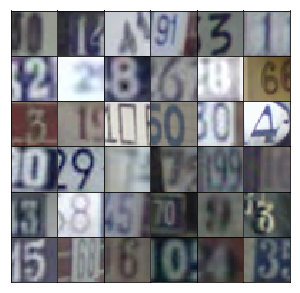

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
#this is the same as the previous GAN exercise
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [24]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    #z is noise tensor, training is for the batch normalization layers
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512) #note that this is different from the illustration above
        x1 = tf.reshape(x1, (-1, 4, 4, 512)) #reshape to start the convolutional stack
        x1 = tf.layers.batch_normalization(x1, training = training) #need to use batch normalization, otherwise this won't work
        x1 = tf.maximum(alpha * x1, x1) #this is the leaky relu
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides = 2, padding = 'same')
        x2 = tf.layers.batch_normalization(x2, training = training)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides = 2, padding = 'same')
        x3 = tf.layers.batch_normalization(x3, training = training)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Output layer, 32x32x3, output dim here should be 3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides = 2, padding = 'same', )
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [19]:
def discriminator(x, reuse=False, alpha=0.2):
    #this is the complete opposite of the generator
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides = 2, padding = 'same')
        #no batch normalization for the first layer. BN will introduce weirdness
        relu1 = tf.maximum(alpha * x1, x1)
        #16x16x64
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides = 2, padding = 'same')
        bn2 = tf.layers.batch_normalization(x2, training = True)
        relu2 = tf.maximum(alpha * x2, x2)
        #8x8x128
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides = 2, padding = 'same')
        bn3 = tf.layers.batch_normalization(x3, training = True)
        relu3 = tf.maximum(alpha * x3, x3)
        #4x4x256
        
        flat = tf.reshape(relu3, (-1, 4*4*256)) #reshape into something flat
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [20]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [27]:
#GANs are very sensitive to hyperparameters
# you want the discriminator loss to be around 0.3
if True:
    real_size = (32,32,3)
    z_size = 100
    learning_rate = 0.0002
    batch_size = 128
    epochs = 25
    alpha = 0.2
    beta1 = 0.5

else:
    #these are default values
    real_size = (32,32,3)
    z_size = 100
    learning_rate = 0.001
    batch_size = 64
    epochs = 1
    alpha = 0.01
    beta1 = 0.9
    
# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.4542... Generator Loss: 0.4243
Epoch 1/25... Discriminator Loss: 0.9182... Generator Loss: 0.7976
Epoch 1/25... Discriminator Loss: 0.9648... Generator Loss: 0.7260
Epoch 1/25... Discriminator Loss: 0.5695... Generator Loss: 1.3849
Epoch 1/25... Discriminator Loss: 0.3547... Generator Loss: 2.5650
Epoch 1/25... Discriminator Loss: 0.3828... Generator Loss: 2.5105
Epoch 1/25... Discriminator Loss: 0.6034... Generator Loss: 1.7198
Epoch 1/25... Discriminator Loss: 0.6485... Generator Loss: 1.7536
Epoch 1/25... Discriminator Loss: 0.7398... Generator Loss: 1.7022
Epoch 1/25... Discriminator Loss: 0.7179... Generator Loss: 2.1159


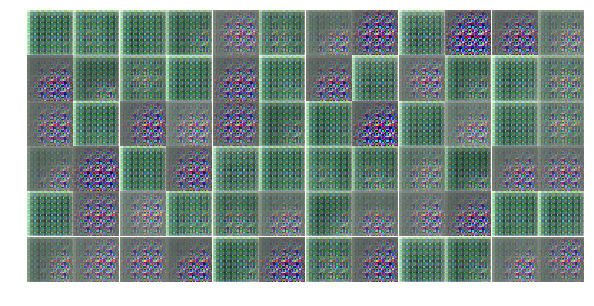

Epoch 1/25... Discriminator Loss: 0.7283... Generator Loss: 1.5675
Epoch 1/25... Discriminator Loss: 0.7169... Generator Loss: 1.6318
Epoch 1/25... Discriminator Loss: 0.7678... Generator Loss: 1.1660
Epoch 1/25... Discriminator Loss: 0.5877... Generator Loss: 1.6126
Epoch 1/25... Discriminator Loss: 0.8102... Generator Loss: 1.1620
Epoch 1/25... Discriminator Loss: 0.8929... Generator Loss: 1.0250
Epoch 1/25... Discriminator Loss: 0.5771... Generator Loss: 1.9359
Epoch 1/25... Discriminator Loss: 0.7666... Generator Loss: 1.6491
Epoch 1/25... Discriminator Loss: 0.7544... Generator Loss: 1.3384
Epoch 1/25... Discriminator Loss: 0.7948... Generator Loss: 1.7466


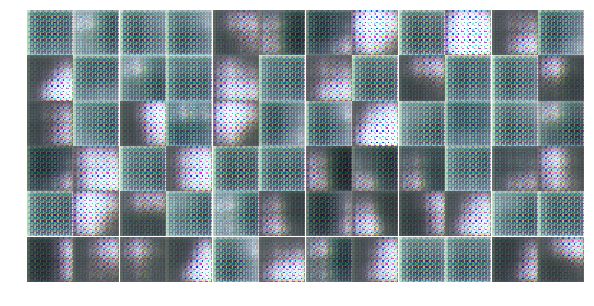

Epoch 1/25... Discriminator Loss: 0.7526... Generator Loss: 1.2977
Epoch 1/25... Discriminator Loss: 0.9474... Generator Loss: 0.9197
Epoch 1/25... Discriminator Loss: 0.7322... Generator Loss: 1.3299
Epoch 1/25... Discriminator Loss: 0.5942... Generator Loss: 1.6703
Epoch 1/25... Discriminator Loss: 0.5168... Generator Loss: 2.0258
Epoch 1/25... Discriminator Loss: 0.6238... Generator Loss: 1.6602
Epoch 1/25... Discriminator Loss: 0.7007... Generator Loss: 1.2367
Epoch 1/25... Discriminator Loss: 1.0956... Generator Loss: 0.9945
Epoch 1/25... Discriminator Loss: 1.3950... Generator Loss: 0.9762
Epoch 1/25... Discriminator Loss: 1.0401... Generator Loss: 1.1074


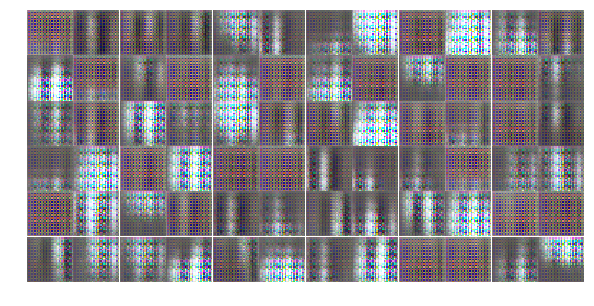

Epoch 1/25... Discriminator Loss: 0.6252... Generator Loss: 1.4580
Epoch 1/25... Discriminator Loss: 0.7457... Generator Loss: 1.0971
Epoch 1/25... Discriminator Loss: 1.1534... Generator Loss: 0.8564
Epoch 1/25... Discriminator Loss: 1.1843... Generator Loss: 1.0208
Epoch 1/25... Discriminator Loss: 1.2453... Generator Loss: 0.9927
Epoch 1/25... Discriminator Loss: 1.1115... Generator Loss: 1.0899
Epoch 1/25... Discriminator Loss: 0.9472... Generator Loss: 1.2744
Epoch 1/25... Discriminator Loss: 1.0316... Generator Loss: 1.0088
Epoch 1/25... Discriminator Loss: 0.8728... Generator Loss: 1.2826
Epoch 1/25... Discriminator Loss: 1.2970... Generator Loss: 0.9736


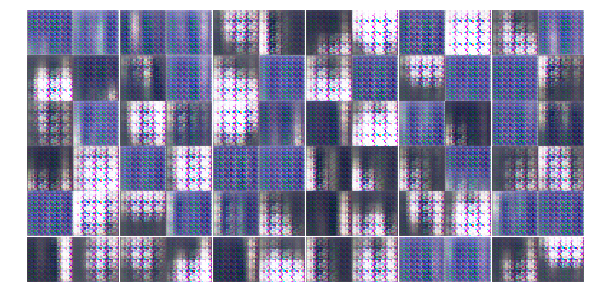

Epoch 1/25... Discriminator Loss: 1.2447... Generator Loss: 0.8610
Epoch 1/25... Discriminator Loss: 1.0665... Generator Loss: 1.0743
Epoch 1/25... Discriminator Loss: 0.8651... Generator Loss: 1.0822
Epoch 1/25... Discriminator Loss: 0.9717... Generator Loss: 1.1062
Epoch 1/25... Discriminator Loss: 0.8666... Generator Loss: 1.2084
Epoch 1/25... Discriminator Loss: 1.1063... Generator Loss: 0.7142
Epoch 1/25... Discriminator Loss: 0.8330... Generator Loss: 1.1436
Epoch 1/25... Discriminator Loss: 1.2723... Generator Loss: 0.8531
Epoch 1/25... Discriminator Loss: 0.9055... Generator Loss: 1.2975
Epoch 1/25... Discriminator Loss: 1.0815... Generator Loss: 0.9482


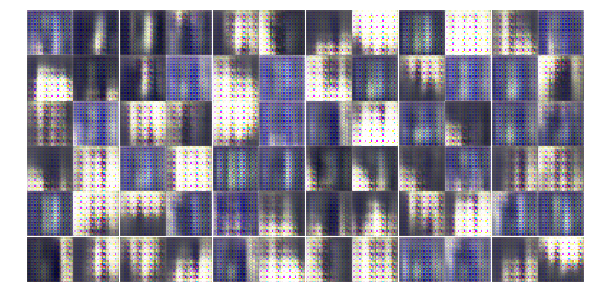

Epoch 1/25... Discriminator Loss: 0.9268... Generator Loss: 1.2695
Epoch 1/25... Discriminator Loss: 1.0906... Generator Loss: 1.2330
Epoch 1/25... Discriminator Loss: 1.1472... Generator Loss: 0.8105
Epoch 1/25... Discriminator Loss: 0.9398... Generator Loss: 1.2723
Epoch 1/25... Discriminator Loss: 0.8236... Generator Loss: 1.3627
Epoch 1/25... Discriminator Loss: 1.3661... Generator Loss: 0.5868
Epoch 1/25... Discriminator Loss: 0.9754... Generator Loss: 0.9370
Epoch 2/25... Discriminator Loss: 1.0272... Generator Loss: 0.9760
Epoch 2/25... Discriminator Loss: 0.9010... Generator Loss: 1.2413
Epoch 2/25... Discriminator Loss: 1.1216... Generator Loss: 1.0824


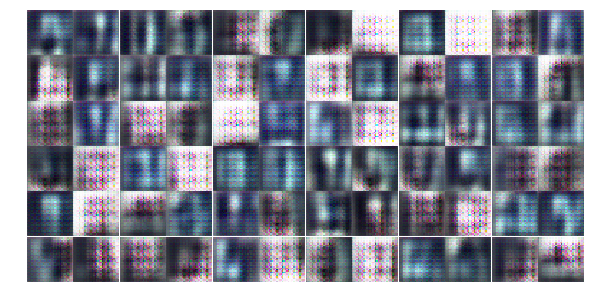

Epoch 2/25... Discriminator Loss: 1.1575... Generator Loss: 0.8030
Epoch 2/25... Discriminator Loss: 1.1572... Generator Loss: 0.9663
Epoch 2/25... Discriminator Loss: 1.0971... Generator Loss: 0.8572
Epoch 2/25... Discriminator Loss: 1.1143... Generator Loss: 0.9637
Epoch 2/25... Discriminator Loss: 1.1158... Generator Loss: 0.8934
Epoch 2/25... Discriminator Loss: 1.1806... Generator Loss: 0.9316
Epoch 2/25... Discriminator Loss: 1.0902... Generator Loss: 0.9629
Epoch 2/25... Discriminator Loss: 1.1138... Generator Loss: 0.8530
Epoch 2/25... Discriminator Loss: 1.1901... Generator Loss: 0.9524
Epoch 2/25... Discriminator Loss: 1.1108... Generator Loss: 0.7864


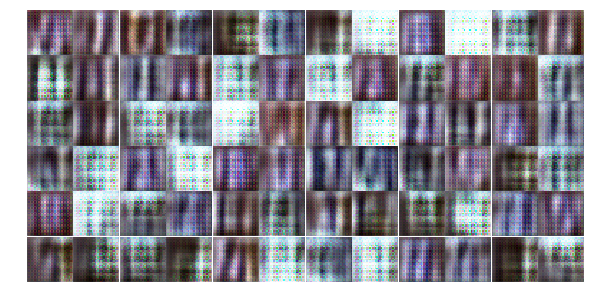

Epoch 2/25... Discriminator Loss: 0.9663... Generator Loss: 1.0251
Epoch 2/25... Discriminator Loss: 1.1131... Generator Loss: 1.0052
Epoch 2/25... Discriminator Loss: 1.0212... Generator Loss: 1.1429
Epoch 2/25... Discriminator Loss: 1.0473... Generator Loss: 1.0287
Epoch 2/25... Discriminator Loss: 1.1564... Generator Loss: 0.9227
Epoch 2/25... Discriminator Loss: 1.0770... Generator Loss: 1.1039
Epoch 2/25... Discriminator Loss: 1.0509... Generator Loss: 1.0491
Epoch 2/25... Discriminator Loss: 1.1703... Generator Loss: 1.0062
Epoch 2/25... Discriminator Loss: 1.1319... Generator Loss: 1.0307
Epoch 2/25... Discriminator Loss: 1.1543... Generator Loss: 1.0568


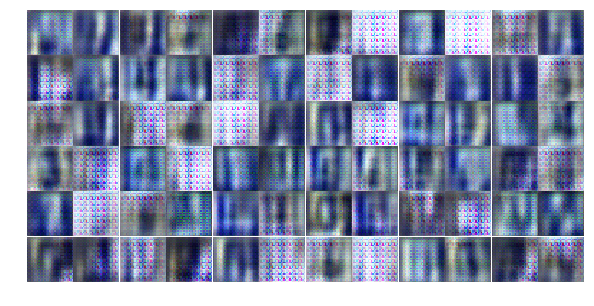

Epoch 2/25... Discriminator Loss: 1.2295... Generator Loss: 0.9872
Epoch 2/25... Discriminator Loss: 1.2530... Generator Loss: 0.8384
Epoch 2/25... Discriminator Loss: 1.1536... Generator Loss: 0.8496
Epoch 2/25... Discriminator Loss: 1.2669... Generator Loss: 0.9935
Epoch 2/25... Discriminator Loss: 1.3477... Generator Loss: 0.9246
Epoch 2/25... Discriminator Loss: 1.0556... Generator Loss: 1.1079
Epoch 2/25... Discriminator Loss: 1.3456... Generator Loss: 1.1079
Epoch 2/25... Discriminator Loss: 1.0030... Generator Loss: 1.0710
Epoch 2/25... Discriminator Loss: 0.9680... Generator Loss: 1.0611
Epoch 2/25... Discriminator Loss: 1.2726... Generator Loss: 0.8873


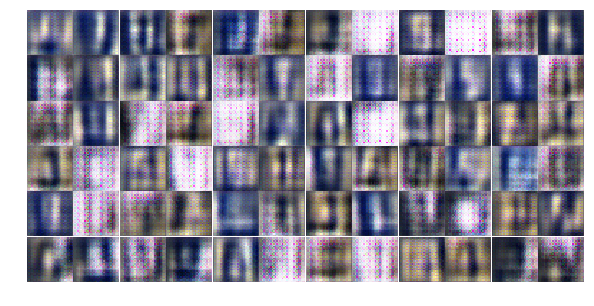

Epoch 2/25... Discriminator Loss: 0.9928... Generator Loss: 0.8785
Epoch 2/25... Discriminator Loss: 1.0349... Generator Loss: 1.1403
Epoch 2/25... Discriminator Loss: 1.5586... Generator Loss: 0.8663
Epoch 2/25... Discriminator Loss: 1.1747... Generator Loss: 0.9965
Epoch 2/25... Discriminator Loss: 1.0644... Generator Loss: 0.9726
Epoch 2/25... Discriminator Loss: 1.0644... Generator Loss: 1.0430
Epoch 2/25... Discriminator Loss: 1.0875... Generator Loss: 0.8711
Epoch 2/25... Discriminator Loss: 1.2026... Generator Loss: 0.9752
Epoch 2/25... Discriminator Loss: 1.2223... Generator Loss: 0.6916
Epoch 2/25... Discriminator Loss: 1.1319... Generator Loss: 0.9527


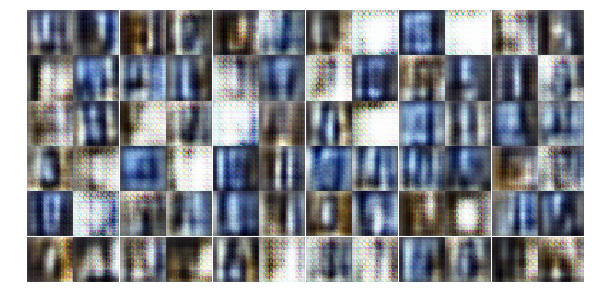

Epoch 2/25... Discriminator Loss: 0.9765... Generator Loss: 1.2244
Epoch 2/25... Discriminator Loss: 1.1325... Generator Loss: 0.9559
Epoch 2/25... Discriminator Loss: 0.9616... Generator Loss: 1.2461
Epoch 2/25... Discriminator Loss: 1.0371... Generator Loss: 0.8068
Epoch 2/25... Discriminator Loss: 1.0847... Generator Loss: 0.9687
Epoch 2/25... Discriminator Loss: 1.0523... Generator Loss: 1.2492
Epoch 2/25... Discriminator Loss: 1.0557... Generator Loss: 0.9534
Epoch 2/25... Discriminator Loss: 1.0520... Generator Loss: 1.1476
Epoch 2/25... Discriminator Loss: 1.0498... Generator Loss: 1.1700
Epoch 2/25... Discriminator Loss: 1.0946... Generator Loss: 0.7092


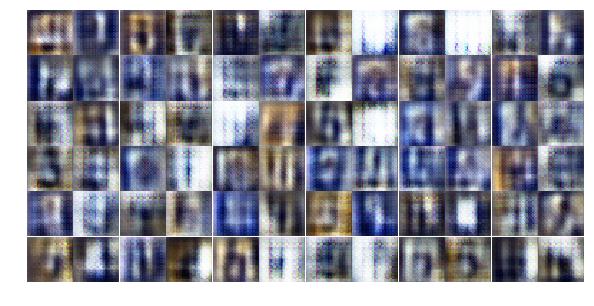

Epoch 2/25... Discriminator Loss: 1.2409... Generator Loss: 0.7182
Epoch 2/25... Discriminator Loss: 0.8442... Generator Loss: 1.5418
Epoch 2/25... Discriminator Loss: 1.3425... Generator Loss: 1.2939
Epoch 2/25... Discriminator Loss: 1.0751... Generator Loss: 1.0556
Epoch 3/25... Discriminator Loss: 0.8057... Generator Loss: 1.1412
Epoch 3/25... Discriminator Loss: 1.1904... Generator Loss: 0.8802
Epoch 3/25... Discriminator Loss: 1.1971... Generator Loss: 0.8935
Epoch 3/25... Discriminator Loss: 0.9771... Generator Loss: 0.8469
Epoch 3/25... Discriminator Loss: 0.9658... Generator Loss: 1.1226
Epoch 3/25... Discriminator Loss: 1.0005... Generator Loss: 1.0702


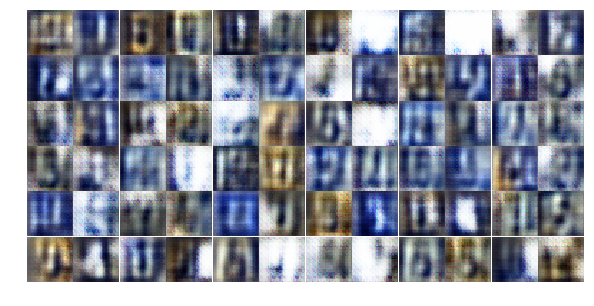

Epoch 3/25... Discriminator Loss: 0.7648... Generator Loss: 2.2742
Epoch 3/25... Discriminator Loss: 1.1399... Generator Loss: 1.0440
Epoch 3/25... Discriminator Loss: 1.2453... Generator Loss: 0.6952
Epoch 3/25... Discriminator Loss: 1.1721... Generator Loss: 0.6267
Epoch 3/25... Discriminator Loss: 0.9626... Generator Loss: 1.0208
Epoch 3/25... Discriminator Loss: 1.0947... Generator Loss: 1.0200
Epoch 3/25... Discriminator Loss: 1.1047... Generator Loss: 0.9944
Epoch 3/25... Discriminator Loss: 1.1518... Generator Loss: 0.7042
Epoch 3/25... Discriminator Loss: 1.0165... Generator Loss: 1.5107
Epoch 3/25... Discriminator Loss: 0.9848... Generator Loss: 1.6750


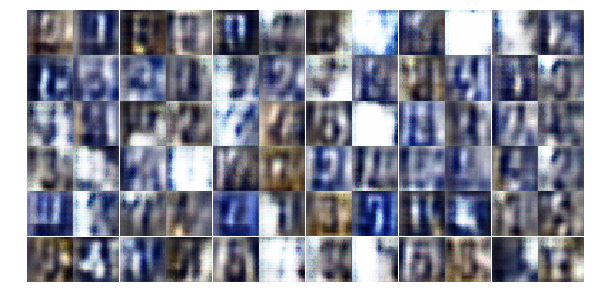

Epoch 3/25... Discriminator Loss: 0.9778... Generator Loss: 0.9608
Epoch 3/25... Discriminator Loss: 1.0153... Generator Loss: 1.1392
Epoch 3/25... Discriminator Loss: 1.0737... Generator Loss: 1.1738
Epoch 3/25... Discriminator Loss: 1.1537... Generator Loss: 0.7818
Epoch 3/25... Discriminator Loss: 0.9820... Generator Loss: 1.4742
Epoch 3/25... Discriminator Loss: 0.9179... Generator Loss: 1.0694
Epoch 3/25... Discriminator Loss: 1.1024... Generator Loss: 1.1038
Epoch 3/25... Discriminator Loss: 1.0598... Generator Loss: 0.9953
Epoch 3/25... Discriminator Loss: 0.9628... Generator Loss: 1.4788
Epoch 3/25... Discriminator Loss: 1.0672... Generator Loss: 1.1222


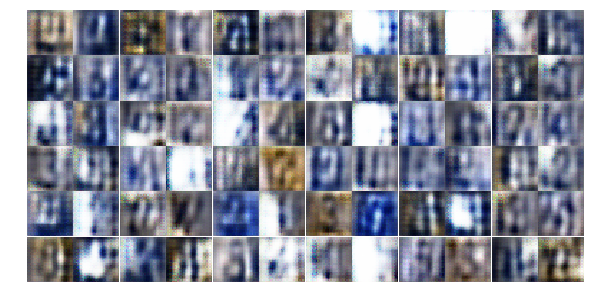

Epoch 3/25... Discriminator Loss: 0.8564... Generator Loss: 1.5592
Epoch 3/25... Discriminator Loss: 0.9457... Generator Loss: 1.3182
Epoch 3/25... Discriminator Loss: 1.1758... Generator Loss: 0.8914
Epoch 3/25... Discriminator Loss: 1.0211... Generator Loss: 1.6166
Epoch 3/25... Discriminator Loss: 1.1266... Generator Loss: 1.0862
Epoch 3/25... Discriminator Loss: 1.0749... Generator Loss: 0.8804
Epoch 3/25... Discriminator Loss: 0.9982... Generator Loss: 1.4764
Epoch 3/25... Discriminator Loss: 1.1673... Generator Loss: 1.3064
Epoch 3/25... Discriminator Loss: 1.1289... Generator Loss: 1.1188
Epoch 3/25... Discriminator Loss: 0.9332... Generator Loss: 1.3009


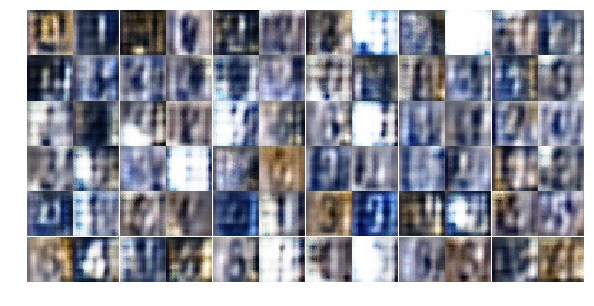

Epoch 3/25... Discriminator Loss: 0.9980... Generator Loss: 1.1157
Epoch 3/25... Discriminator Loss: 1.0607... Generator Loss: 1.2629
Epoch 3/25... Discriminator Loss: 0.9479... Generator Loss: 1.5111
Epoch 3/25... Discriminator Loss: 0.8303... Generator Loss: 1.8544
Epoch 3/25... Discriminator Loss: 1.0902... Generator Loss: 1.5597
Epoch 3/25... Discriminator Loss: 1.0117... Generator Loss: 1.1504
Epoch 3/25... Discriminator Loss: 1.0102... Generator Loss: 1.2865
Epoch 3/25... Discriminator Loss: 1.1328... Generator Loss: 1.2231
Epoch 3/25... Discriminator Loss: 0.9755... Generator Loss: 1.4009
Epoch 3/25... Discriminator Loss: 1.1858... Generator Loss: 1.0371


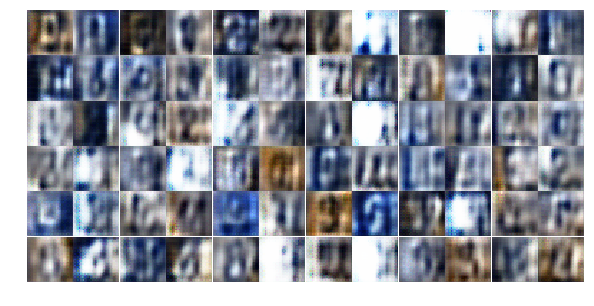

Epoch 3/25... Discriminator Loss: 1.1730... Generator Loss: 0.9583
Epoch 3/25... Discriminator Loss: 1.0336... Generator Loss: 1.3290
Epoch 3/25... Discriminator Loss: 1.0565... Generator Loss: 1.1404
Epoch 3/25... Discriminator Loss: 0.9856... Generator Loss: 1.1924
Epoch 3/25... Discriminator Loss: 1.1922... Generator Loss: 0.7239
Epoch 3/25... Discriminator Loss: 0.9548... Generator Loss: 1.2659
Epoch 3/25... Discriminator Loss: 1.0282... Generator Loss: 1.2879
Epoch 3/25... Discriminator Loss: 1.0996... Generator Loss: 1.0695
Epoch 3/25... Discriminator Loss: 1.0945... Generator Loss: 1.0993
Epoch 3/25... Discriminator Loss: 1.2224... Generator Loss: 1.0062


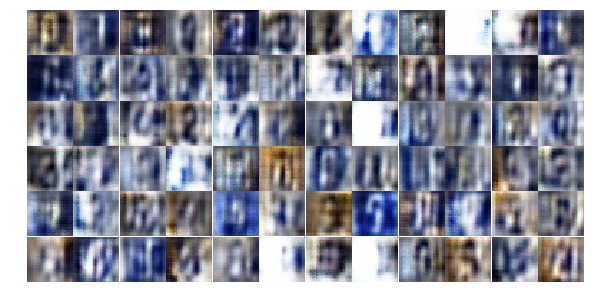

Epoch 3/25... Discriminator Loss: 1.1149... Generator Loss: 1.0149
Epoch 4/25... Discriminator Loss: 1.0724... Generator Loss: 1.0946
Epoch 4/25... Discriminator Loss: 1.1491... Generator Loss: 0.9837
Epoch 4/25... Discriminator Loss: 1.3033... Generator Loss: 1.0609
Epoch 4/25... Discriminator Loss: 1.0067... Generator Loss: 1.0229
Epoch 4/25... Discriminator Loss: 1.1133... Generator Loss: 1.2834
Epoch 4/25... Discriminator Loss: 1.0606... Generator Loss: 1.2061
Epoch 4/25... Discriminator Loss: 1.1814... Generator Loss: 1.3127
Epoch 4/25... Discriminator Loss: 1.0107... Generator Loss: 1.4593
Epoch 4/25... Discriminator Loss: 1.1288... Generator Loss: 1.0535


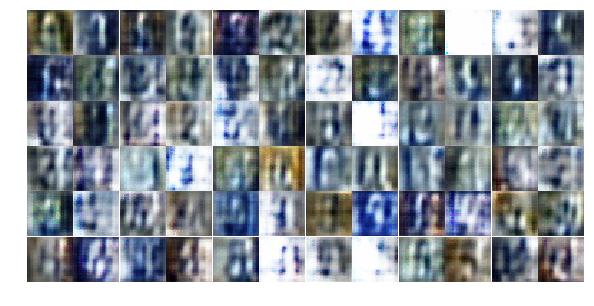

Epoch 4/25... Discriminator Loss: 1.0439... Generator Loss: 1.7211
Epoch 4/25... Discriminator Loss: 1.1746... Generator Loss: 1.2239
Epoch 4/25... Discriminator Loss: 0.9280... Generator Loss: 1.6110
Epoch 4/25... Discriminator Loss: 1.2784... Generator Loss: 1.1644
Epoch 4/25... Discriminator Loss: 1.0068... Generator Loss: 1.7757
Epoch 4/25... Discriminator Loss: 1.2077... Generator Loss: 0.9870
Epoch 4/25... Discriminator Loss: 1.2220... Generator Loss: 1.1581
Epoch 4/25... Discriminator Loss: 1.2299... Generator Loss: 0.9662
Epoch 4/25... Discriminator Loss: 1.2743... Generator Loss: 1.0280
Epoch 4/25... Discriminator Loss: 1.1254... Generator Loss: 1.0115


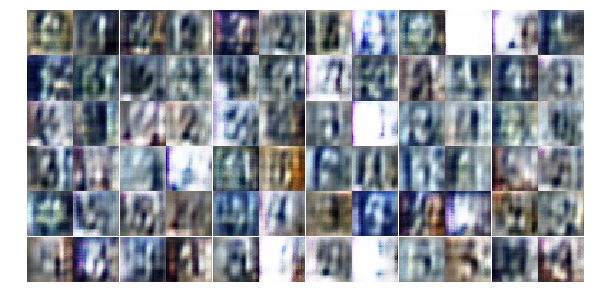

Epoch 4/25... Discriminator Loss: 1.2531... Generator Loss: 0.9637
Epoch 4/25... Discriminator Loss: 0.8695... Generator Loss: 1.4417
Epoch 4/25... Discriminator Loss: 1.2508... Generator Loss: 0.8885
Epoch 4/25... Discriminator Loss: 1.0297... Generator Loss: 1.4645
Epoch 4/25... Discriminator Loss: 1.0729... Generator Loss: 1.4411
Epoch 4/25... Discriminator Loss: 1.1658... Generator Loss: 1.1582
Epoch 4/25... Discriminator Loss: 0.9792... Generator Loss: 1.3630
Epoch 4/25... Discriminator Loss: 1.0182... Generator Loss: 1.3227
Epoch 4/25... Discriminator Loss: 1.1569... Generator Loss: 1.0860
Epoch 4/25... Discriminator Loss: 1.1147... Generator Loss: 1.0485


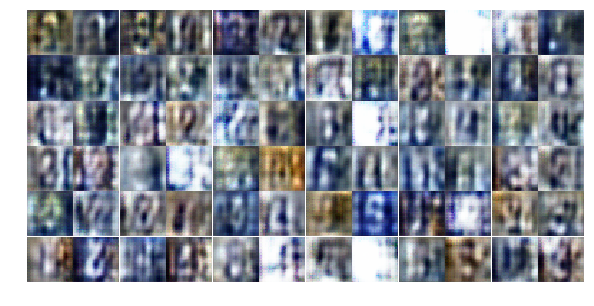

Epoch 4/25... Discriminator Loss: 1.2832... Generator Loss: 1.0932
Epoch 4/25... Discriminator Loss: 1.1438... Generator Loss: 1.0345
Epoch 4/25... Discriminator Loss: 1.0880... Generator Loss: 1.4651
Epoch 4/25... Discriminator Loss: 0.9976... Generator Loss: 1.7420
Epoch 4/25... Discriminator Loss: 1.1539... Generator Loss: 1.1462
Epoch 4/25... Discriminator Loss: 1.0326... Generator Loss: 1.0540
Epoch 4/25... Discriminator Loss: 1.1144... Generator Loss: 1.0582
Epoch 4/25... Discriminator Loss: 1.2065... Generator Loss: 1.1376
Epoch 4/25... Discriminator Loss: 1.1125... Generator Loss: 1.0118
Epoch 4/25... Discriminator Loss: 0.9222... Generator Loss: 1.3393


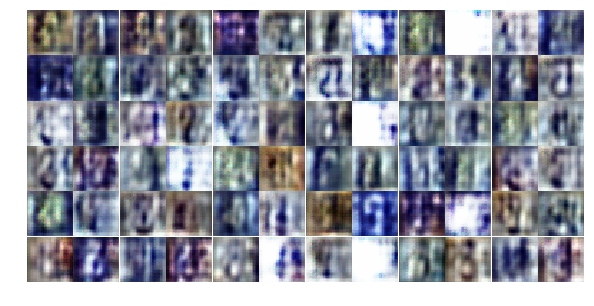

Epoch 4/25... Discriminator Loss: 1.0721... Generator Loss: 0.9994
Epoch 4/25... Discriminator Loss: 1.1614... Generator Loss: 1.1330
Epoch 4/25... Discriminator Loss: 0.9117... Generator Loss: 2.1504
Epoch 4/25... Discriminator Loss: 1.2840... Generator Loss: 1.0825
Epoch 4/25... Discriminator Loss: 1.1367... Generator Loss: 1.0140
Epoch 4/25... Discriminator Loss: 1.1391... Generator Loss: 1.1193
Epoch 4/25... Discriminator Loss: 1.0158... Generator Loss: 1.4422
Epoch 4/25... Discriminator Loss: 1.3260... Generator Loss: 0.8630
Epoch 4/25... Discriminator Loss: 1.1817... Generator Loss: 1.1975
Epoch 4/25... Discriminator Loss: 1.2618... Generator Loss: 0.8620


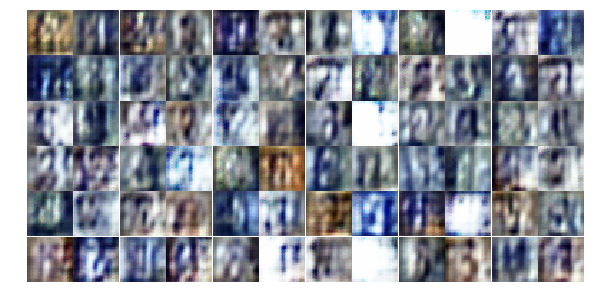

Epoch 4/25... Discriminator Loss: 1.2978... Generator Loss: 1.1124
Epoch 4/25... Discriminator Loss: 1.1400... Generator Loss: 1.0675
Epoch 4/25... Discriminator Loss: 1.2065... Generator Loss: 0.9409
Epoch 4/25... Discriminator Loss: 1.1288... Generator Loss: 1.1249
Epoch 4/25... Discriminator Loss: 1.1227... Generator Loss: 0.9482
Epoch 4/25... Discriminator Loss: 1.0665... Generator Loss: 1.1741
Epoch 4/25... Discriminator Loss: 1.2951... Generator Loss: 0.9020
Epoch 4/25... Discriminator Loss: 1.1318... Generator Loss: 1.3778
Epoch 4/25... Discriminator Loss: 1.1831... Generator Loss: 1.0228
Epoch 5/25... Discriminator Loss: 1.0772... Generator Loss: 1.0512


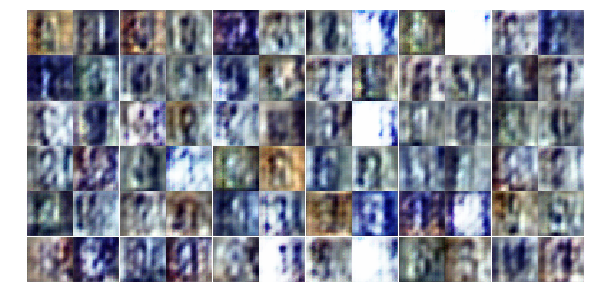

Epoch 5/25... Discriminator Loss: 0.7503... Generator Loss: 1.9831
Epoch 5/25... Discriminator Loss: 1.1859... Generator Loss: 1.1161
Epoch 5/25... Discriminator Loss: 0.6404... Generator Loss: 2.7720
Epoch 5/25... Discriminator Loss: 1.1115... Generator Loss: 1.2477
Epoch 5/25... Discriminator Loss: 1.0497... Generator Loss: 1.3297
Epoch 5/25... Discriminator Loss: 1.3683... Generator Loss: 1.0639
Epoch 5/25... Discriminator Loss: 1.0834... Generator Loss: 1.2982
Epoch 5/25... Discriminator Loss: 1.0120... Generator Loss: 1.1522
Epoch 5/25... Discriminator Loss: 1.3435... Generator Loss: 0.9511
Epoch 5/25... Discriminator Loss: 1.1546... Generator Loss: 1.0597


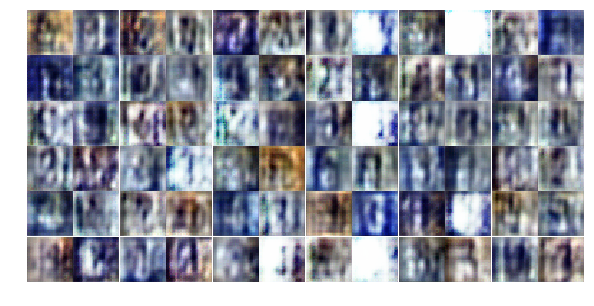

Epoch 5/25... Discriminator Loss: 1.1745... Generator Loss: 0.9678
Epoch 5/25... Discriminator Loss: 0.9845... Generator Loss: 1.2223
Epoch 5/25... Discriminator Loss: 1.2125... Generator Loss: 1.2420
Epoch 5/25... Discriminator Loss: 1.2659... Generator Loss: 1.0025
Epoch 5/25... Discriminator Loss: 1.0105... Generator Loss: 1.1354
Epoch 5/25... Discriminator Loss: 1.0838... Generator Loss: 1.3160
Epoch 5/25... Discriminator Loss: 1.2016... Generator Loss: 1.1539
Epoch 5/25... Discriminator Loss: 1.1308... Generator Loss: 1.0814
Epoch 5/25... Discriminator Loss: 1.1812... Generator Loss: 1.0925
Epoch 5/25... Discriminator Loss: 1.0807... Generator Loss: 1.2455


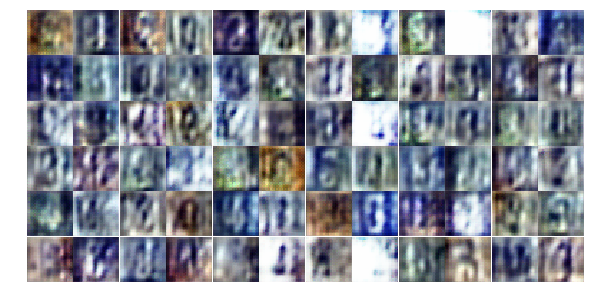

Epoch 5/25... Discriminator Loss: 1.1631... Generator Loss: 0.9162
Epoch 5/25... Discriminator Loss: 1.2981... Generator Loss: 1.0306
Epoch 5/25... Discriminator Loss: 1.2474... Generator Loss: 1.0222
Epoch 5/25... Discriminator Loss: 1.2544... Generator Loss: 0.8670
Epoch 5/25... Discriminator Loss: 1.1815... Generator Loss: 0.9527
Epoch 5/25... Discriminator Loss: 1.2188... Generator Loss: 0.7466
Epoch 5/25... Discriminator Loss: 1.1497... Generator Loss: 1.0428
Epoch 5/25... Discriminator Loss: 1.1829... Generator Loss: 1.1014
Epoch 5/25... Discriminator Loss: 1.2234... Generator Loss: 1.1236
Epoch 5/25... Discriminator Loss: 1.1888... Generator Loss: 0.9246


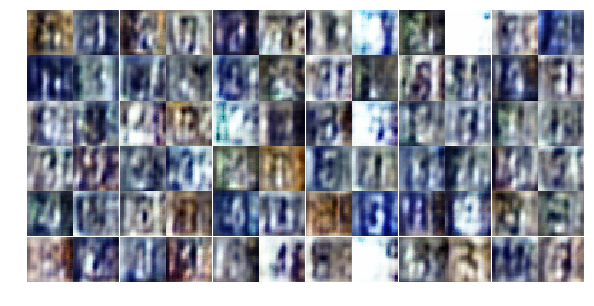

Epoch 5/25... Discriminator Loss: 0.7744... Generator Loss: 2.1297
Epoch 5/25... Discriminator Loss: 1.0357... Generator Loss: 1.1809
Epoch 5/25... Discriminator Loss: 1.1072... Generator Loss: 1.0963
Epoch 5/25... Discriminator Loss: 0.9527... Generator Loss: 1.6410
Epoch 5/25... Discriminator Loss: 1.1998... Generator Loss: 0.9200
Epoch 5/25... Discriminator Loss: 1.0076... Generator Loss: 1.3954
Epoch 5/25... Discriminator Loss: 1.2126... Generator Loss: 1.1164
Epoch 5/25... Discriminator Loss: 1.2200... Generator Loss: 1.2573
Epoch 5/25... Discriminator Loss: 1.1442... Generator Loss: 0.9250
Epoch 5/25... Discriminator Loss: 1.2683... Generator Loss: 1.0311


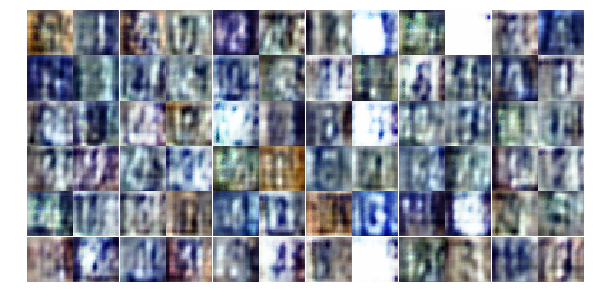

Epoch 5/25... Discriminator Loss: 1.1732... Generator Loss: 1.2497
Epoch 5/25... Discriminator Loss: 1.1885... Generator Loss: 1.4100
Epoch 5/25... Discriminator Loss: 1.1511... Generator Loss: 0.7809
Epoch 5/25... Discriminator Loss: 1.2990... Generator Loss: 0.9373
Epoch 5/25... Discriminator Loss: 1.1892... Generator Loss: 0.9085
Epoch 5/25... Discriminator Loss: 1.1872... Generator Loss: 1.0399
Epoch 5/25... Discriminator Loss: 1.1076... Generator Loss: 0.9479
Epoch 5/25... Discriminator Loss: 1.1779... Generator Loss: 0.9989
Epoch 5/25... Discriminator Loss: 1.0738... Generator Loss: 1.2785
Epoch 5/25... Discriminator Loss: 1.2119... Generator Loss: 0.9775


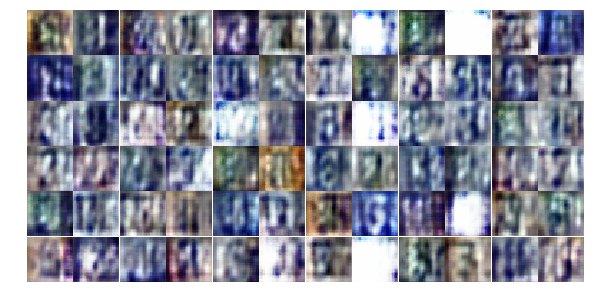

Epoch 5/25... Discriminator Loss: 1.2096... Generator Loss: 0.9296
Epoch 5/25... Discriminator Loss: 1.1985... Generator Loss: 0.9668
Epoch 5/25... Discriminator Loss: 1.0534... Generator Loss: 1.1045
Epoch 5/25... Discriminator Loss: 1.1351... Generator Loss: 1.1005
Epoch 5/25... Discriminator Loss: 1.1936... Generator Loss: 0.9802
Epoch 5/25... Discriminator Loss: 1.1912... Generator Loss: 1.0805
Epoch 6/25... Discriminator Loss: 1.2306... Generator Loss: 1.2091
Epoch 6/25... Discriminator Loss: 1.1645... Generator Loss: 1.0115
Epoch 6/25... Discriminator Loss: 1.2450... Generator Loss: 1.8029
Epoch 6/25... Discriminator Loss: 1.2509... Generator Loss: 1.1273


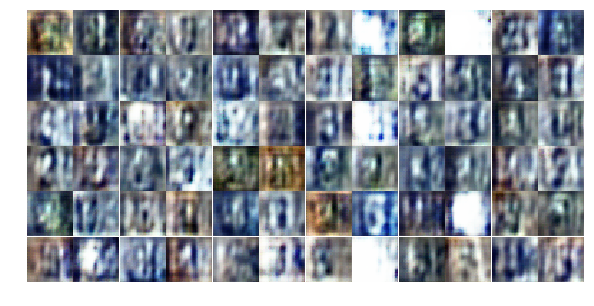

Epoch 6/25... Discriminator Loss: 1.1272... Generator Loss: 1.3542
Epoch 6/25... Discriminator Loss: 1.1926... Generator Loss: 1.0088
Epoch 6/25... Discriminator Loss: 1.1458... Generator Loss: 1.2178
Epoch 6/25... Discriminator Loss: 1.1823... Generator Loss: 0.9500
Epoch 6/25... Discriminator Loss: 1.2147... Generator Loss: 0.9353
Epoch 6/25... Discriminator Loss: 1.2687... Generator Loss: 1.0427
Epoch 6/25... Discriminator Loss: 1.3019... Generator Loss: 0.9405
Epoch 6/25... Discriminator Loss: 1.2209... Generator Loss: 0.9762
Epoch 6/25... Discriminator Loss: 1.1118... Generator Loss: 1.0781
Epoch 6/25... Discriminator Loss: 1.2444... Generator Loss: 0.9857


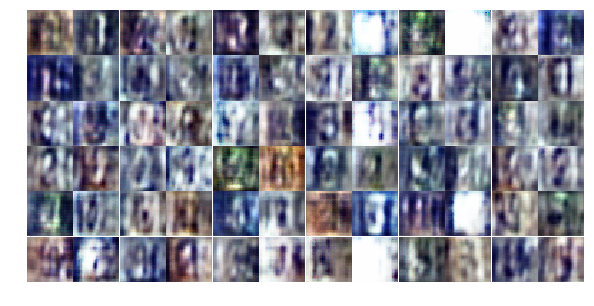

Epoch 6/25... Discriminator Loss: 1.1101... Generator Loss: 1.3578
Epoch 6/25... Discriminator Loss: 1.1151... Generator Loss: 1.0984
Epoch 6/25... Discriminator Loss: 1.3106... Generator Loss: 1.0250
Epoch 6/25... Discriminator Loss: 1.1880... Generator Loss: 1.0573
Epoch 6/25... Discriminator Loss: 1.3075... Generator Loss: 0.8925
Epoch 6/25... Discriminator Loss: 1.1809... Generator Loss: 0.9457
Epoch 6/25... Discriminator Loss: 1.2746... Generator Loss: 1.0042
Epoch 6/25... Discriminator Loss: 1.2716... Generator Loss: 0.9919
Epoch 6/25... Discriminator Loss: 1.0730... Generator Loss: 0.9851
Epoch 6/25... Discriminator Loss: 1.2399... Generator Loss: 1.0204


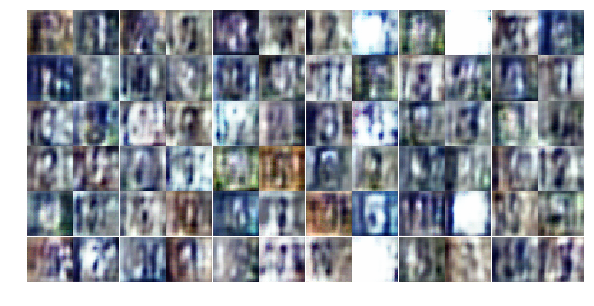

Epoch 6/25... Discriminator Loss: 1.1312... Generator Loss: 1.1024
Epoch 6/25... Discriminator Loss: 1.1260... Generator Loss: 1.5209
Epoch 6/25... Discriminator Loss: 1.0278... Generator Loss: 1.1706
Epoch 6/25... Discriminator Loss: 1.2646... Generator Loss: 0.9650
Epoch 6/25... Discriminator Loss: 1.2801... Generator Loss: 1.0131
Epoch 6/25... Discriminator Loss: 1.1767... Generator Loss: 0.9243
Epoch 6/25... Discriminator Loss: 1.2395... Generator Loss: 0.8992
Epoch 6/25... Discriminator Loss: 1.2250... Generator Loss: 0.8162
Epoch 6/25... Discriminator Loss: 0.9185... Generator Loss: 2.4444
Epoch 6/25... Discriminator Loss: 1.0394... Generator Loss: 1.1119


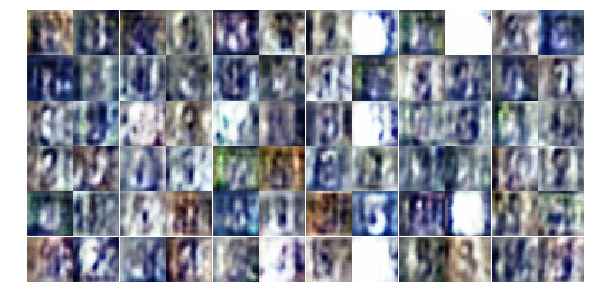

Epoch 6/25... Discriminator Loss: 1.2045... Generator Loss: 0.8943
Epoch 6/25... Discriminator Loss: 1.2284... Generator Loss: 1.1616
Epoch 6/25... Discriminator Loss: 1.4302... Generator Loss: 1.9766
Epoch 6/25... Discriminator Loss: 1.0397... Generator Loss: 1.1994
Epoch 6/25... Discriminator Loss: 0.9219... Generator Loss: 1.7158
Epoch 6/25... Discriminator Loss: 1.1687... Generator Loss: 1.0313
Epoch 6/25... Discriminator Loss: 1.1722... Generator Loss: 1.1800
Epoch 6/25... Discriminator Loss: 1.1872... Generator Loss: 1.0166
Epoch 6/25... Discriminator Loss: 1.2513... Generator Loss: 0.8743
Epoch 6/25... Discriminator Loss: 1.1658... Generator Loss: 1.3145


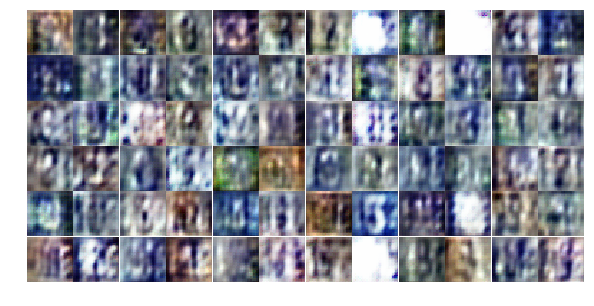

Epoch 6/25... Discriminator Loss: 1.0800... Generator Loss: 1.0798
Epoch 6/25... Discriminator Loss: 1.2274... Generator Loss: 0.7591
Epoch 6/25... Discriminator Loss: 1.2855... Generator Loss: 1.0242
Epoch 6/25... Discriminator Loss: 1.0683... Generator Loss: 1.0746
Epoch 6/25... Discriminator Loss: 1.3040... Generator Loss: 1.0110
Epoch 6/25... Discriminator Loss: 1.0903... Generator Loss: 1.0717
Epoch 6/25... Discriminator Loss: 1.3100... Generator Loss: 0.9384
Epoch 6/25... Discriminator Loss: 1.1611... Generator Loss: 1.0854
Epoch 6/25... Discriminator Loss: 1.2013... Generator Loss: 1.0145
Epoch 6/25... Discriminator Loss: 1.2151... Generator Loss: 1.0398


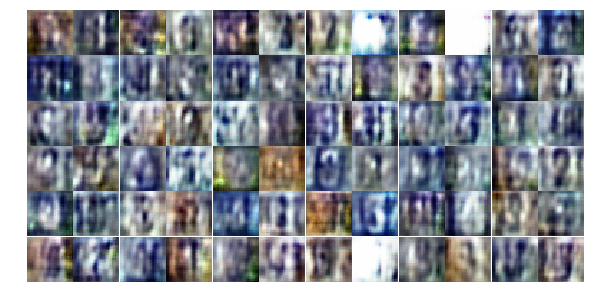

Epoch 6/25... Discriminator Loss: 1.1995... Generator Loss: 1.0274
Epoch 6/25... Discriminator Loss: 1.2211... Generator Loss: 0.9955
Epoch 6/25... Discriminator Loss: 1.0368... Generator Loss: 1.1302
Epoch 7/25... Discriminator Loss: 1.1440... Generator Loss: 0.9800
Epoch 7/25... Discriminator Loss: 1.1992... Generator Loss: 0.9482
Epoch 7/25... Discriminator Loss: 1.2841... Generator Loss: 0.9721
Epoch 7/25... Discriminator Loss: 0.5974... Generator Loss: 7.0138
Epoch 7/25... Discriminator Loss: 1.2324... Generator Loss: 1.1426
Epoch 7/25... Discriminator Loss: 1.0301... Generator Loss: 1.0192
Epoch 7/25... Discriminator Loss: 1.0711... Generator Loss: 1.1956


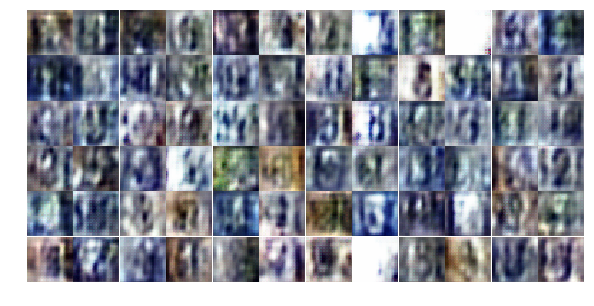

Epoch 7/25... Discriminator Loss: 0.9523... Generator Loss: 5.5039
Epoch 7/25... Discriminator Loss: 1.1728... Generator Loss: 1.0342
Epoch 7/25... Discriminator Loss: 1.1716... Generator Loss: 0.9594
Epoch 7/25... Discriminator Loss: 1.0731... Generator Loss: 1.0403
Epoch 7/25... Discriminator Loss: 1.1812... Generator Loss: 0.9381
Epoch 7/25... Discriminator Loss: 1.0726... Generator Loss: 0.9946
Epoch 7/25... Discriminator Loss: 1.3327... Generator Loss: 0.9273
Epoch 7/25... Discriminator Loss: 1.1600... Generator Loss: 1.4064
Epoch 7/25... Discriminator Loss: 1.3027... Generator Loss: 0.8559
Epoch 7/25... Discriminator Loss: 1.1298... Generator Loss: 0.9054


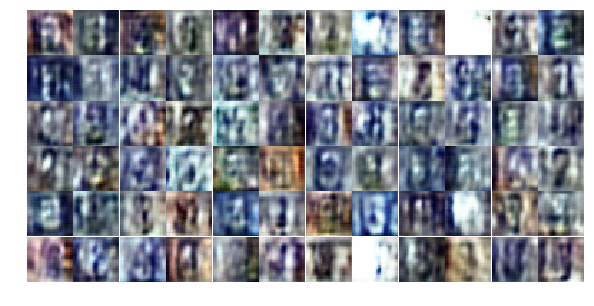

Epoch 7/25... Discriminator Loss: 1.2494... Generator Loss: 1.0078
Epoch 7/25... Discriminator Loss: 1.2212... Generator Loss: 0.9694
Epoch 7/25... Discriminator Loss: 1.1303... Generator Loss: 1.1672
Epoch 7/25... Discriminator Loss: 1.2216... Generator Loss: 1.0248
Epoch 7/25... Discriminator Loss: 1.0796... Generator Loss: 0.8948
Epoch 7/25... Discriminator Loss: 1.2294... Generator Loss: 1.0696
Epoch 7/25... Discriminator Loss: 1.0905... Generator Loss: 1.5562
Epoch 7/25... Discriminator Loss: 1.1628... Generator Loss: 1.0083
Epoch 7/25... Discriminator Loss: 1.2465... Generator Loss: 0.8316
Epoch 7/25... Discriminator Loss: 1.2416... Generator Loss: 1.2609


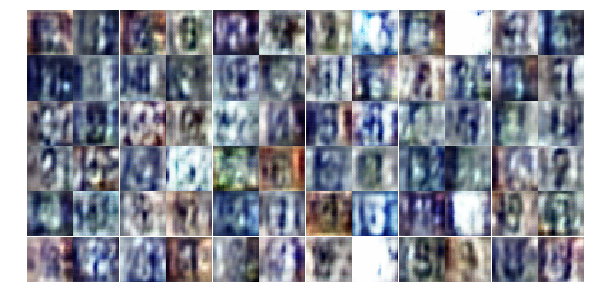

Epoch 7/25... Discriminator Loss: 1.1600... Generator Loss: 1.2919
Epoch 7/25... Discriminator Loss: 1.1739... Generator Loss: 0.9328
Epoch 7/25... Discriminator Loss: 1.2225... Generator Loss: 1.0060
Epoch 7/25... Discriminator Loss: 1.1324... Generator Loss: 1.0787
Epoch 7/25... Discriminator Loss: 1.1799... Generator Loss: 1.0223
Epoch 7/25... Discriminator Loss: 1.1564... Generator Loss: 1.0019
Epoch 7/25... Discriminator Loss: 1.2830... Generator Loss: 0.9974
Epoch 7/25... Discriminator Loss: 1.2153... Generator Loss: 0.9786
Epoch 7/25... Discriminator Loss: 1.2621... Generator Loss: 1.1143
Epoch 7/25... Discriminator Loss: 1.3543... Generator Loss: 0.9102


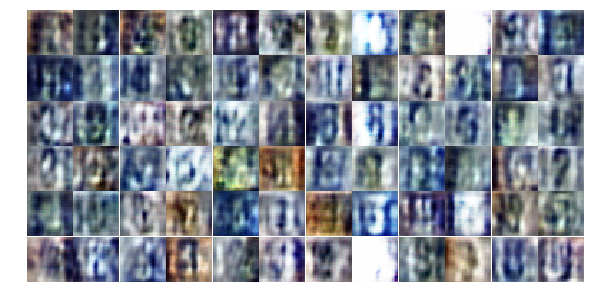

Epoch 7/25... Discriminator Loss: 1.2728... Generator Loss: 0.9833
Epoch 7/25... Discriminator Loss: 1.2114... Generator Loss: 0.8607
Epoch 7/25... Discriminator Loss: 1.2414... Generator Loss: 1.4114
Epoch 7/25... Discriminator Loss: 1.1819... Generator Loss: 0.9043
Epoch 7/25... Discriminator Loss: 1.2083... Generator Loss: 1.1049
Epoch 7/25... Discriminator Loss: 1.2999... Generator Loss: 1.0342
Epoch 7/25... Discriminator Loss: 1.1782... Generator Loss: 1.0246
Epoch 7/25... Discriminator Loss: 1.2049... Generator Loss: 0.9887
Epoch 7/25... Discriminator Loss: 1.1658... Generator Loss: 0.8910
Epoch 7/25... Discriminator Loss: 1.1245... Generator Loss: 1.1704


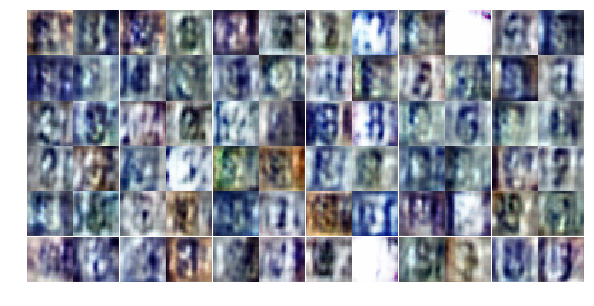

Epoch 7/25... Discriminator Loss: 1.2776... Generator Loss: 1.0687
Epoch 7/25... Discriminator Loss: 1.3161... Generator Loss: 0.8635
Epoch 7/25... Discriminator Loss: 1.3279... Generator Loss: 0.8585
Epoch 7/25... Discriminator Loss: 1.3622... Generator Loss: 0.8543
Epoch 7/25... Discriminator Loss: 1.0751... Generator Loss: 1.1662
Epoch 7/25... Discriminator Loss: 1.2086... Generator Loss: 1.1244
Epoch 7/25... Discriminator Loss: 1.2103... Generator Loss: 1.0314
Epoch 7/25... Discriminator Loss: 1.1211... Generator Loss: 1.1470
Epoch 7/25... Discriminator Loss: 1.0896... Generator Loss: 1.1735
Epoch 7/25... Discriminator Loss: 1.1365... Generator Loss: 1.3032


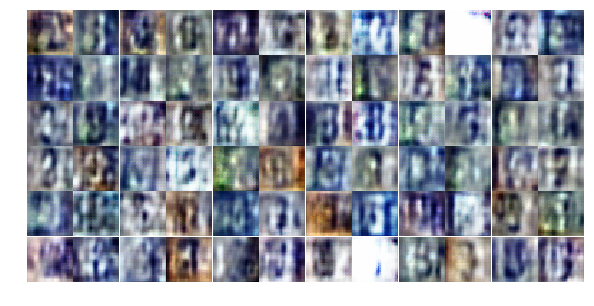

Epoch 7/25... Discriminator Loss: 1.2690... Generator Loss: 0.9228
Epoch 8/25... Discriminator Loss: 1.1609... Generator Loss: 0.9125
Epoch 8/25... Discriminator Loss: 1.1417... Generator Loss: 1.1529
Epoch 8/25... Discriminator Loss: 1.2545... Generator Loss: 0.9924
Epoch 8/25... Discriminator Loss: 1.2315... Generator Loss: 0.9805
Epoch 8/25... Discriminator Loss: 1.1587... Generator Loss: 1.1238
Epoch 8/25... Discriminator Loss: 1.2409... Generator Loss: 1.0273
Epoch 8/25... Discriminator Loss: 1.3262... Generator Loss: 0.8579
Epoch 8/25... Discriminator Loss: 1.2091... Generator Loss: 0.9268
Epoch 8/25... Discriminator Loss: 1.3154... Generator Loss: 0.9504


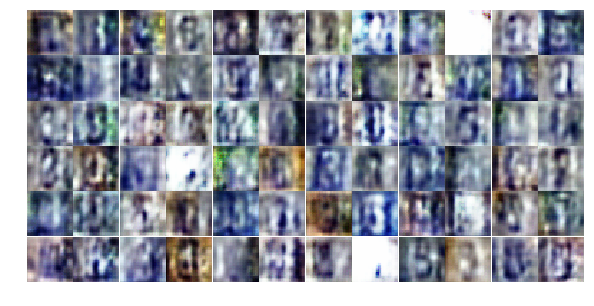

Epoch 8/25... Discriminator Loss: 1.0706... Generator Loss: 1.3931
Epoch 8/25... Discriminator Loss: 1.4462... Generator Loss: 0.7157
Epoch 8/25... Discriminator Loss: 1.2585... Generator Loss: 0.7888
Epoch 8/25... Discriminator Loss: 1.3199... Generator Loss: 1.0644
Epoch 8/25... Discriminator Loss: 1.1055... Generator Loss: 1.0987
Epoch 8/25... Discriminator Loss: 1.3092... Generator Loss: 0.9384
Epoch 8/25... Discriminator Loss: 1.2660... Generator Loss: 0.9071
Epoch 8/25... Discriminator Loss: 1.3770... Generator Loss: 0.9564
Epoch 8/25... Discriminator Loss: 1.0043... Generator Loss: 1.0513
Epoch 8/25... Discriminator Loss: 1.2299... Generator Loss: 1.0500


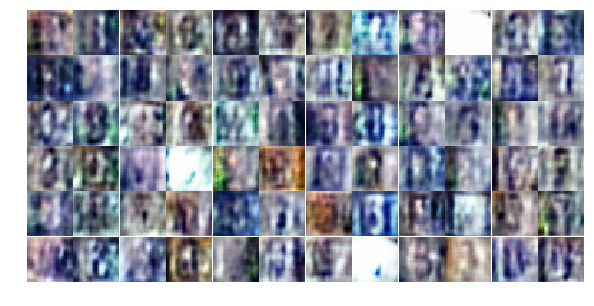

Epoch 8/25... Discriminator Loss: 1.1103... Generator Loss: 1.0730
Epoch 8/25... Discriminator Loss: 1.3249... Generator Loss: 1.1063
Epoch 8/25... Discriminator Loss: 1.3097... Generator Loss: 0.7991
Epoch 8/25... Discriminator Loss: 1.1978... Generator Loss: 1.1416
Epoch 8/25... Discriminator Loss: 1.1613... Generator Loss: 1.0204
Epoch 8/25... Discriminator Loss: 1.1899... Generator Loss: 1.1557
Epoch 8/25... Discriminator Loss: 1.0859... Generator Loss: 1.1935
Epoch 8/25... Discriminator Loss: 1.3330... Generator Loss: 0.8003
Epoch 8/25... Discriminator Loss: 1.2449... Generator Loss: 0.9585
Epoch 8/25... Discriminator Loss: 1.3013... Generator Loss: 0.7864


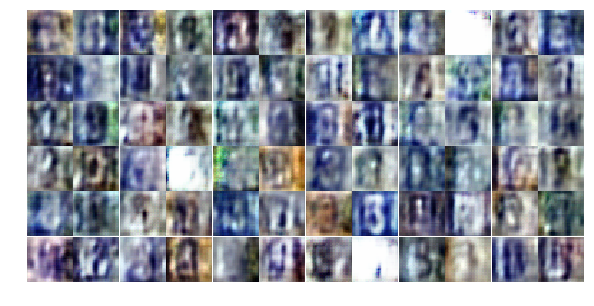

Epoch 8/25... Discriminator Loss: 1.2258... Generator Loss: 0.9300
Epoch 8/25... Discriminator Loss: 1.1839... Generator Loss: 0.8896
Epoch 8/25... Discriminator Loss: 1.3068... Generator Loss: 1.0605
Epoch 8/25... Discriminator Loss: 1.2523... Generator Loss: 0.8523
Epoch 8/25... Discriminator Loss: 1.2124... Generator Loss: 1.0604
Epoch 8/25... Discriminator Loss: 1.3349... Generator Loss: 0.8193
Epoch 8/25... Discriminator Loss: 1.2028... Generator Loss: 1.0062
Epoch 8/25... Discriminator Loss: 1.3163... Generator Loss: 0.8488
Epoch 8/25... Discriminator Loss: 1.2384... Generator Loss: 0.9456
Epoch 8/25... Discriminator Loss: 1.2728... Generator Loss: 1.0498


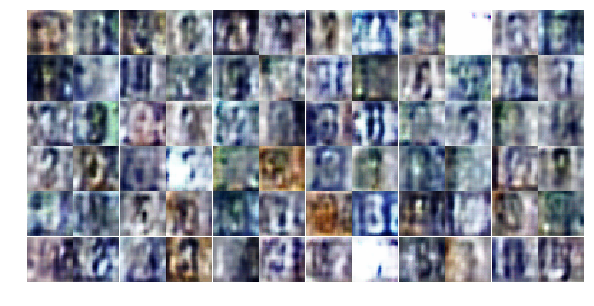

Epoch 8/25... Discriminator Loss: 1.2277... Generator Loss: 0.8223
Epoch 8/25... Discriminator Loss: 1.3823... Generator Loss: 0.9100
Epoch 8/25... Discriminator Loss: 1.2439... Generator Loss: 1.1690
Epoch 8/25... Discriminator Loss: 1.3175... Generator Loss: 0.9425
Epoch 8/25... Discriminator Loss: 1.3227... Generator Loss: 0.7992
Epoch 8/25... Discriminator Loss: 1.2814... Generator Loss: 0.8917
Epoch 8/25... Discriminator Loss: 1.1678... Generator Loss: 1.0418
Epoch 8/25... Discriminator Loss: 1.1300... Generator Loss: 0.9188
Epoch 8/25... Discriminator Loss: 1.4227... Generator Loss: 0.8251
Epoch 8/25... Discriminator Loss: 1.3659... Generator Loss: 1.1198


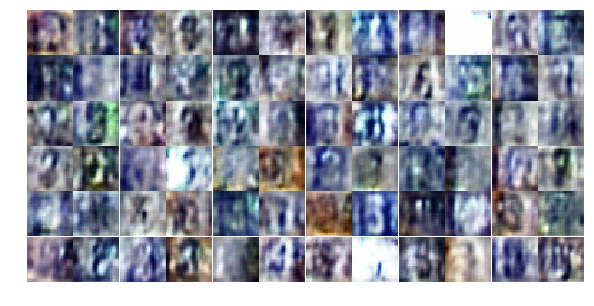

Epoch 8/25... Discriminator Loss: 1.1742... Generator Loss: 0.9846
Epoch 8/25... Discriminator Loss: 1.2735... Generator Loss: 0.8418
Epoch 8/25... Discriminator Loss: 1.0841... Generator Loss: 1.2429
Epoch 8/25... Discriminator Loss: 1.4124... Generator Loss: 1.0523
Epoch 8/25... Discriminator Loss: 1.2334... Generator Loss: 0.9842
Epoch 8/25... Discriminator Loss: 1.3131... Generator Loss: 1.0349
Epoch 8/25... Discriminator Loss: 1.3171... Generator Loss: 0.7478
Epoch 8/25... Discriminator Loss: 1.0719... Generator Loss: 1.1502
Epoch 9/25... Discriminator Loss: 1.2680... Generator Loss: 0.8576
Epoch 9/25... Discriminator Loss: 1.2870... Generator Loss: 0.9261


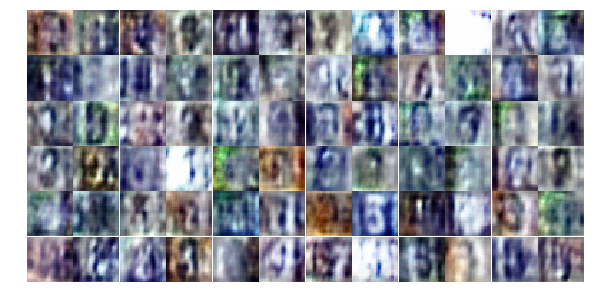

Epoch 9/25... Discriminator Loss: 1.1513... Generator Loss: 1.2511
Epoch 9/25... Discriminator Loss: 1.1511... Generator Loss: 1.2436
Epoch 9/25... Discriminator Loss: 1.2379... Generator Loss: 0.9916
Epoch 9/25... Discriminator Loss: 1.2299... Generator Loss: 1.1553
Epoch 9/25... Discriminator Loss: 1.3993... Generator Loss: 0.8097
Epoch 9/25... Discriminator Loss: 1.3252... Generator Loss: 0.9828
Epoch 9/25... Discriminator Loss: 1.1298... Generator Loss: 1.1018
Epoch 9/25... Discriminator Loss: 1.3815... Generator Loss: 0.7452
Epoch 9/25... Discriminator Loss: 1.1795... Generator Loss: 0.9696
Epoch 9/25... Discriminator Loss: 1.3076... Generator Loss: 0.9788


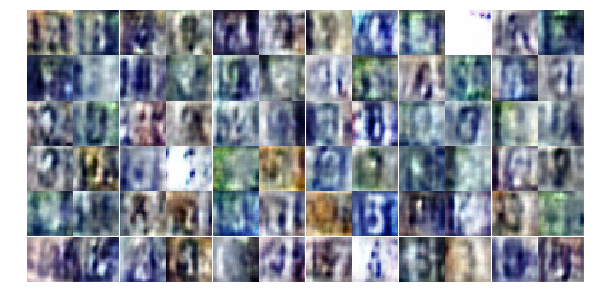

Epoch 9/25... Discriminator Loss: 1.1343... Generator Loss: 1.0516
Epoch 9/25... Discriminator Loss: 1.3239... Generator Loss: 0.9771
Epoch 9/25... Discriminator Loss: 0.6453... Generator Loss: 18.4062
Epoch 9/25... Discriminator Loss: 0.9913... Generator Loss: 1.3508
Epoch 9/25... Discriminator Loss: 1.1505... Generator Loss: 1.0984
Epoch 9/25... Discriminator Loss: 1.0260... Generator Loss: 1.4033
Epoch 9/25... Discriminator Loss: 1.2559... Generator Loss: 0.9657
Epoch 9/25... Discriminator Loss: 1.2645... Generator Loss: 0.8587
Epoch 9/25... Discriminator Loss: 1.2755... Generator Loss: 1.0208
Epoch 9/25... Discriminator Loss: 1.3587... Generator Loss: 1.0124


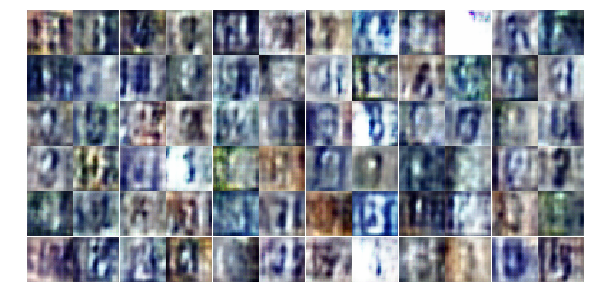

Epoch 9/25... Discriminator Loss: 1.2711... Generator Loss: 0.8333
Epoch 9/25... Discriminator Loss: 1.1639... Generator Loss: 1.0889
Epoch 9/25... Discriminator Loss: 1.0878... Generator Loss: 1.0831
Epoch 9/25... Discriminator Loss: 1.2945... Generator Loss: 0.8841
Epoch 9/25... Discriminator Loss: 1.1468... Generator Loss: 1.1190
Epoch 9/25... Discriminator Loss: 1.1923... Generator Loss: 0.7269
Epoch 9/25... Discriminator Loss: 1.3879... Generator Loss: 0.8069
Epoch 9/25... Discriminator Loss: 1.2242... Generator Loss: 1.0180
Epoch 9/25... Discriminator Loss: 1.1829... Generator Loss: 1.0057
Epoch 9/25... Discriminator Loss: 1.2276... Generator Loss: 1.0173


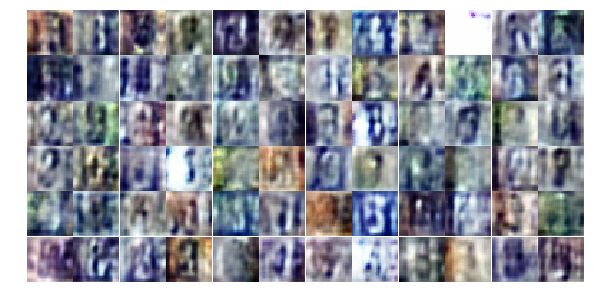

Epoch 9/25... Discriminator Loss: 1.3410... Generator Loss: 0.8923
Epoch 9/25... Discriminator Loss: 1.0935... Generator Loss: 1.1427
Epoch 9/25... Discriminator Loss: 1.3282... Generator Loss: 0.9856
Epoch 9/25... Discriminator Loss: 1.1623... Generator Loss: 1.1279
Epoch 9/25... Discriminator Loss: 1.2109... Generator Loss: 1.1434
Epoch 9/25... Discriminator Loss: 1.2871... Generator Loss: 0.8280
Epoch 9/25... Discriminator Loss: 1.3652... Generator Loss: 0.8536
Epoch 9/25... Discriminator Loss: 1.2461... Generator Loss: 0.8657
Epoch 9/25... Discriminator Loss: 1.2363... Generator Loss: 0.8755
Epoch 9/25... Discriminator Loss: 1.3792... Generator Loss: 0.7882


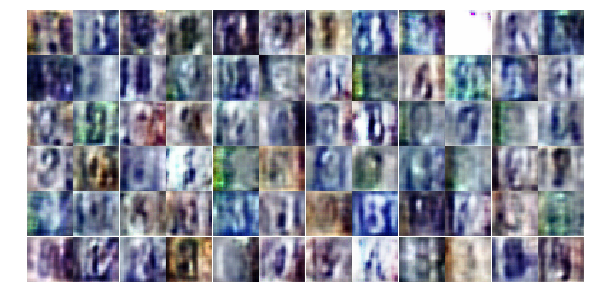

Epoch 9/25... Discriminator Loss: 1.2480... Generator Loss: 0.9407
Epoch 9/25... Discriminator Loss: 1.2470... Generator Loss: 1.1244
Epoch 9/25... Discriminator Loss: 1.1756... Generator Loss: 0.9304
Epoch 9/25... Discriminator Loss: 1.2980... Generator Loss: 0.8953
Epoch 9/25... Discriminator Loss: 0.8751... Generator Loss: 1.9781
Epoch 9/25... Discriminator Loss: 1.2485... Generator Loss: 1.1130
Epoch 9/25... Discriminator Loss: 1.1994... Generator Loss: 0.9899
Epoch 9/25... Discriminator Loss: 1.2775... Generator Loss: 0.7627
Epoch 9/25... Discriminator Loss: 1.1989... Generator Loss: 1.0805
Epoch 9/25... Discriminator Loss: 1.2485... Generator Loss: 0.9522


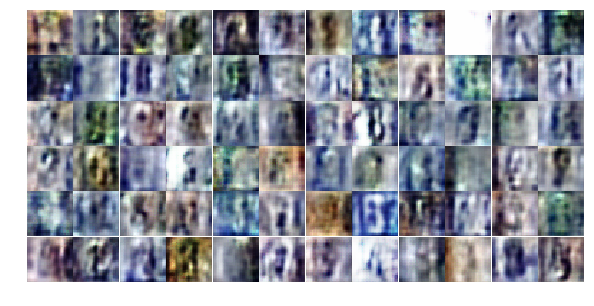

Epoch 9/25... Discriminator Loss: 1.2761... Generator Loss: 0.8977
Epoch 9/25... Discriminator Loss: 1.3913... Generator Loss: 0.8423
Epoch 9/25... Discriminator Loss: 1.2293... Generator Loss: 1.1207
Epoch 9/25... Discriminator Loss: 1.3898... Generator Loss: 0.8183
Epoch 9/25... Discriminator Loss: 1.3198... Generator Loss: 0.8215
Epoch 10/25... Discriminator Loss: 1.2236... Generator Loss: 1.0705
Epoch 10/25... Discriminator Loss: 1.1428... Generator Loss: 0.8415
Epoch 10/25... Discriminator Loss: 1.2773... Generator Loss: 0.8314
Epoch 10/25... Discriminator Loss: 1.1388... Generator Loss: 0.8931
Epoch 10/25... Discriminator Loss: 1.2253... Generator Loss: 0.9155


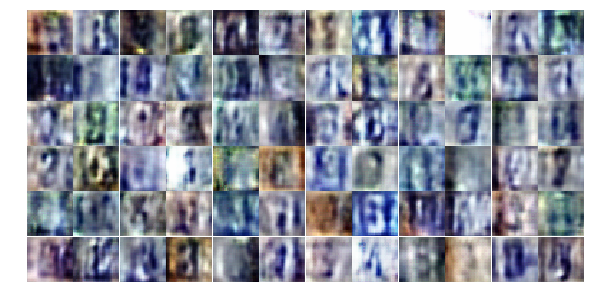

Epoch 10/25... Discriminator Loss: 1.3896... Generator Loss: 0.8456
Epoch 10/25... Discriminator Loss: 0.9048... Generator Loss: 1.5788
Epoch 10/25... Discriminator Loss: 1.1699... Generator Loss: 1.2355
Epoch 10/25... Discriminator Loss: 1.1645... Generator Loss: 1.0057
Epoch 10/25... Discriminator Loss: 1.1596... Generator Loss: 1.0319
Epoch 10/25... Discriminator Loss: 1.2522... Generator Loss: 0.8440
Epoch 10/25... Discriminator Loss: 1.1992... Generator Loss: 0.9178
Epoch 10/25... Discriminator Loss: 1.3243... Generator Loss: 0.8044
Epoch 10/25... Discriminator Loss: 1.1550... Generator Loss: 0.9717
Epoch 10/25... Discriminator Loss: 1.2265... Generator Loss: 0.8616


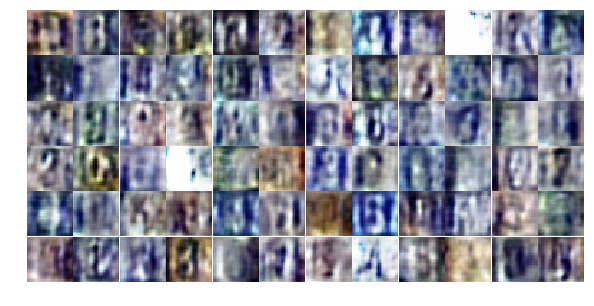

Epoch 10/25... Discriminator Loss: 1.1654... Generator Loss: 0.9947
Epoch 10/25... Discriminator Loss: 1.2014... Generator Loss: 1.0404
Epoch 10/25... Discriminator Loss: 1.3112... Generator Loss: 0.9501
Epoch 10/25... Discriminator Loss: 1.2905... Generator Loss: 0.8038
Epoch 10/25... Discriminator Loss: 1.1528... Generator Loss: 1.0923
Epoch 10/25... Discriminator Loss: 1.3676... Generator Loss: 0.7943
Epoch 10/25... Discriminator Loss: 1.2804... Generator Loss: 1.0346
Epoch 10/25... Discriminator Loss: 1.2043... Generator Loss: 1.1373
Epoch 10/25... Discriminator Loss: 1.2110... Generator Loss: 1.0142
Epoch 10/25... Discriminator Loss: 1.3143... Generator Loss: 0.9664


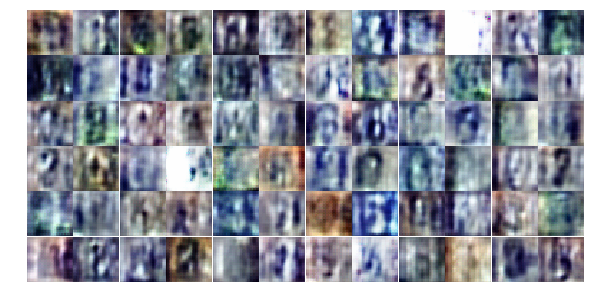

Epoch 10/25... Discriminator Loss: 1.1441... Generator Loss: 0.9768
Epoch 10/25... Discriminator Loss: 1.2820... Generator Loss: 0.9937
Epoch 10/25... Discriminator Loss: 1.2933... Generator Loss: 1.0011
Epoch 10/25... Discriminator Loss: 1.2631... Generator Loss: 1.0270
Epoch 10/25... Discriminator Loss: 1.3114... Generator Loss: 0.8718
Epoch 10/25... Discriminator Loss: 1.1849... Generator Loss: 0.9864
Epoch 10/25... Discriminator Loss: 1.2760... Generator Loss: 0.9846
Epoch 10/25... Discriminator Loss: 1.2174... Generator Loss: 0.8800
Epoch 10/25... Discriminator Loss: 1.2929... Generator Loss: 0.8920
Epoch 10/25... Discriminator Loss: 1.2841... Generator Loss: 0.8637


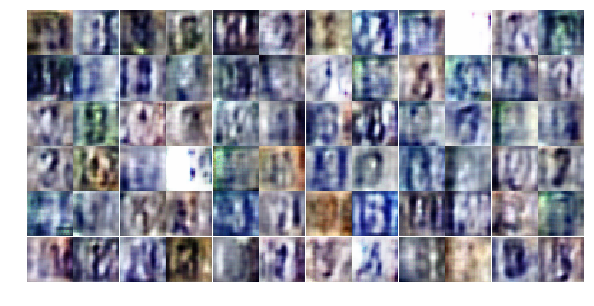

Epoch 10/25... Discriminator Loss: 1.2911... Generator Loss: 1.0320
Epoch 10/25... Discriminator Loss: 1.3546... Generator Loss: 0.7981
Epoch 10/25... Discriminator Loss: 1.2420... Generator Loss: 0.9791
Epoch 10/25... Discriminator Loss: 1.3468... Generator Loss: 0.8161
Epoch 10/25... Discriminator Loss: 1.2496... Generator Loss: 1.0136
Epoch 10/25... Discriminator Loss: 1.2751... Generator Loss: 1.1505
Epoch 10/25... Discriminator Loss: 1.2252... Generator Loss: 0.9840
Epoch 10/25... Discriminator Loss: 1.2437... Generator Loss: 0.9801
Epoch 10/25... Discriminator Loss: 1.2156... Generator Loss: 1.0025
Epoch 10/25... Discriminator Loss: 1.1755... Generator Loss: 1.0549


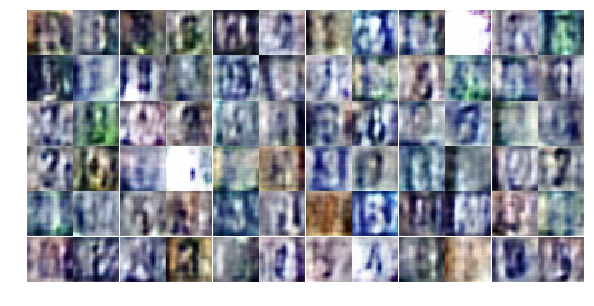

Epoch 10/25... Discriminator Loss: 1.3098... Generator Loss: 0.9648
Epoch 10/25... Discriminator Loss: 1.1752... Generator Loss: 0.9776
Epoch 10/25... Discriminator Loss: 1.0707... Generator Loss: 1.1260
Epoch 10/25... Discriminator Loss: 1.2312... Generator Loss: 0.9721
Epoch 10/25... Discriminator Loss: 1.2644... Generator Loss: 0.9302
Epoch 10/25... Discriminator Loss: 1.2375... Generator Loss: 0.9401
Epoch 10/25... Discriminator Loss: 0.8239... Generator Loss: 2.3683
Epoch 10/25... Discriminator Loss: 1.1889... Generator Loss: 1.1112
Epoch 10/25... Discriminator Loss: 1.1665... Generator Loss: 1.0296
Epoch 10/25... Discriminator Loss: 1.2036... Generator Loss: 0.9332


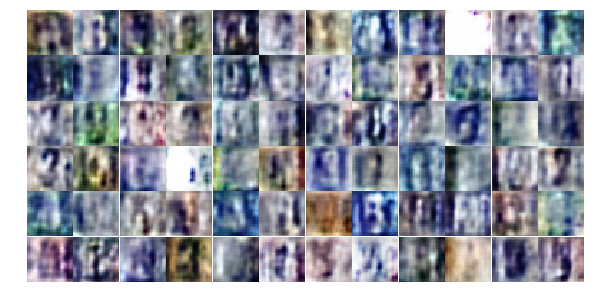

Epoch 10/25... Discriminator Loss: 1.1434... Generator Loss: 0.9853
Epoch 10/25... Discriminator Loss: 1.1954... Generator Loss: 1.0446
Epoch 10/25... Discriminator Loss: 1.2485... Generator Loss: 0.8043
Epoch 11/25... Discriminator Loss: 1.3294... Generator Loss: 0.8516
Epoch 11/25... Discriminator Loss: 1.3376... Generator Loss: 0.9481
Epoch 11/25... Discriminator Loss: 1.1620... Generator Loss: 1.7667
Epoch 11/25... Discriminator Loss: 1.2547... Generator Loss: 0.9060
Epoch 11/25... Discriminator Loss: 1.1720... Generator Loss: 1.2488
Epoch 11/25... Discriminator Loss: 1.1401... Generator Loss: 0.9736
Epoch 11/25... Discriminator Loss: 1.3219... Generator Loss: 1.0054


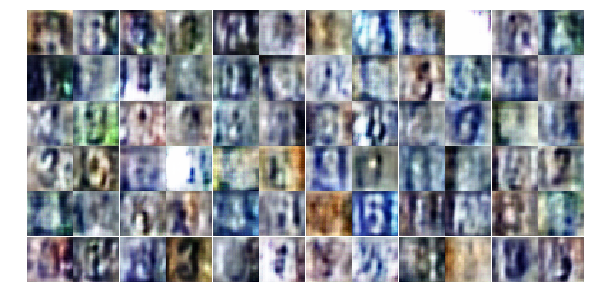

Epoch 11/25... Discriminator Loss: 1.3242... Generator Loss: 0.7970
Epoch 11/25... Discriminator Loss: 1.2972... Generator Loss: 0.7750
Epoch 11/25... Discriminator Loss: 1.3529... Generator Loss: 0.9898
Epoch 11/25... Discriminator Loss: 1.1536... Generator Loss: 1.0250
Epoch 11/25... Discriminator Loss: 1.3091... Generator Loss: 1.0034
Epoch 11/25... Discriminator Loss: 1.2416... Generator Loss: 0.9593
Epoch 11/25... Discriminator Loss: 1.1354... Generator Loss: 1.1153
Epoch 11/25... Discriminator Loss: 1.0640... Generator Loss: 1.1147
Epoch 11/25... Discriminator Loss: 1.2882... Generator Loss: 0.8559
Epoch 11/25... Discriminator Loss: 1.4103... Generator Loss: 0.9059


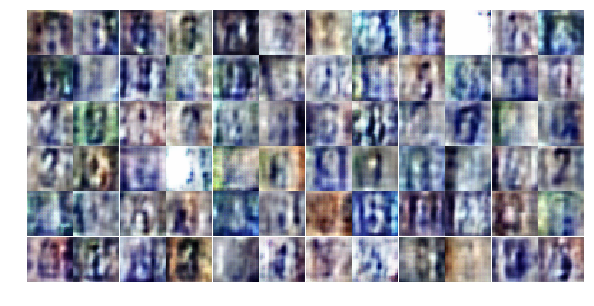

Epoch 11/25... Discriminator Loss: 1.1803... Generator Loss: 0.9009
Epoch 11/25... Discriminator Loss: 1.2137... Generator Loss: 0.9647
Epoch 11/25... Discriminator Loss: 1.3595... Generator Loss: 0.8051
Epoch 11/25... Discriminator Loss: 1.2655... Generator Loss: 0.9423
Epoch 11/25... Discriminator Loss: 1.1307... Generator Loss: 1.2871
Epoch 11/25... Discriminator Loss: 1.1082... Generator Loss: 1.2919
Epoch 11/25... Discriminator Loss: 1.2685... Generator Loss: 0.9097
Epoch 11/25... Discriminator Loss: 1.3519... Generator Loss: 0.9160
Epoch 11/25... Discriminator Loss: 1.2179... Generator Loss: 0.9601
Epoch 11/25... Discriminator Loss: 1.1931... Generator Loss: 0.8190


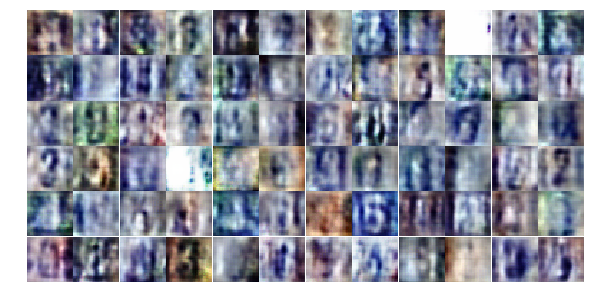

Epoch 11/25... Discriminator Loss: 1.2360... Generator Loss: 0.7435
Epoch 11/25... Discriminator Loss: 1.2855... Generator Loss: 0.8981
Epoch 11/25... Discriminator Loss: 1.2558... Generator Loss: 0.8568
Epoch 11/25... Discriminator Loss: 1.1882... Generator Loss: 0.9292
Epoch 11/25... Discriminator Loss: 1.3772... Generator Loss: 0.7820
Epoch 11/25... Discriminator Loss: 1.2395... Generator Loss: 0.8292
Epoch 11/25... Discriminator Loss: 1.2611... Generator Loss: 0.9097
Epoch 11/25... Discriminator Loss: 1.2822... Generator Loss: 0.9145
Epoch 11/25... Discriminator Loss: 1.1776... Generator Loss: 1.0426
Epoch 11/25... Discriminator Loss: 1.3389... Generator Loss: 0.7646


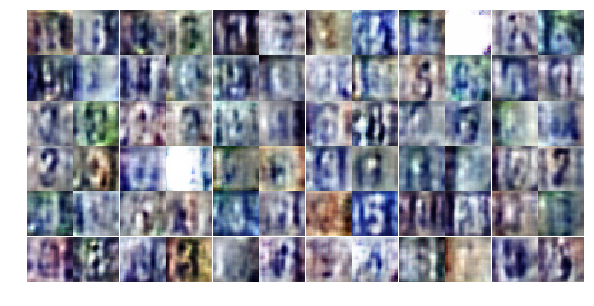

Epoch 11/25... Discriminator Loss: 1.1578... Generator Loss: 1.0302
Epoch 11/25... Discriminator Loss: 1.2400... Generator Loss: 0.8633
Epoch 11/25... Discriminator Loss: 1.1619... Generator Loss: 1.0426
Epoch 11/25... Discriminator Loss: 1.2567... Generator Loss: 0.9081
Epoch 11/25... Discriminator Loss: 1.3969... Generator Loss: 0.9316
Epoch 11/25... Discriminator Loss: 1.2957... Generator Loss: 0.9209
Epoch 11/25... Discriminator Loss: 1.1191... Generator Loss: 1.4623
Epoch 11/25... Discriminator Loss: 1.2552... Generator Loss: 0.8432
Epoch 11/25... Discriminator Loss: 1.2780... Generator Loss: 0.9025
Epoch 11/25... Discriminator Loss: 1.3005... Generator Loss: 0.9677


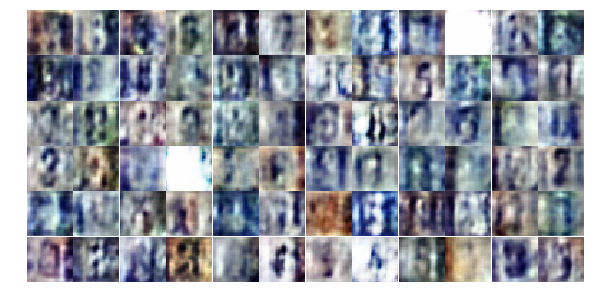

Epoch 11/25... Discriminator Loss: 1.1409... Generator Loss: 1.0303
Epoch 11/25... Discriminator Loss: 1.3240... Generator Loss: 1.0466
Epoch 11/25... Discriminator Loss: 1.3024... Generator Loss: 0.8621
Epoch 11/25... Discriminator Loss: 1.2404... Generator Loss: 0.8069
Epoch 11/25... Discriminator Loss: 1.2570... Generator Loss: 1.1953
Epoch 11/25... Discriminator Loss: 1.3183... Generator Loss: 0.7748
Epoch 11/25... Discriminator Loss: 1.1408... Generator Loss: 1.0353
Epoch 11/25... Discriminator Loss: 1.3297... Generator Loss: 0.9019
Epoch 11/25... Discriminator Loss: 1.3183... Generator Loss: 0.9353
Epoch 11/25... Discriminator Loss: 1.2910... Generator Loss: 0.9136


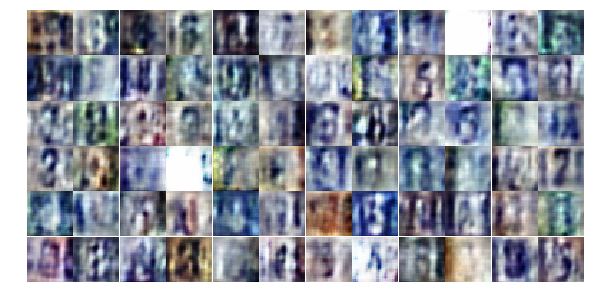

Epoch 12/25... Discriminator Loss: 1.1997... Generator Loss: 0.8840
Epoch 12/25... Discriminator Loss: 1.3372... Generator Loss: 1.0288
Epoch 12/25... Discriminator Loss: 1.2867... Generator Loss: 0.8739
Epoch 12/25... Discriminator Loss: 1.3231... Generator Loss: 0.9965
Epoch 12/25... Discriminator Loss: 1.3142... Generator Loss: 0.9364
Epoch 12/25... Discriminator Loss: 1.1557... Generator Loss: 0.9967
Epoch 12/25... Discriminator Loss: 1.2148... Generator Loss: 1.0414
Epoch 12/25... Discriminator Loss: 1.2983... Generator Loss: 0.9168
Epoch 12/25... Discriminator Loss: 1.2293... Generator Loss: 1.0385
Epoch 12/25... Discriminator Loss: 1.2795... Generator Loss: 0.8821


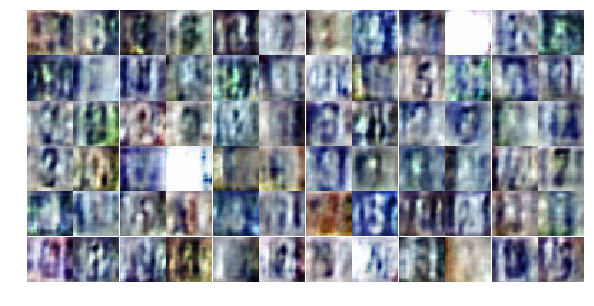

Epoch 12/25... Discriminator Loss: 1.1352... Generator Loss: 1.1235
Epoch 12/25... Discriminator Loss: 1.2694... Generator Loss: 0.9924
Epoch 12/25... Discriminator Loss: 1.2461... Generator Loss: 0.8836
Epoch 12/25... Discriminator Loss: 1.1203... Generator Loss: 1.4002
Epoch 12/25... Discriminator Loss: 1.3926... Generator Loss: 0.7538
Epoch 12/25... Discriminator Loss: 1.2099... Generator Loss: 0.9175
Epoch 12/25... Discriminator Loss: 1.2338... Generator Loss: 1.0772
Epoch 12/25... Discriminator Loss: 1.2566... Generator Loss: 0.8176
Epoch 12/25... Discriminator Loss: 1.2463... Generator Loss: 0.8601
Epoch 12/25... Discriminator Loss: 1.4941... Generator Loss: 0.7900


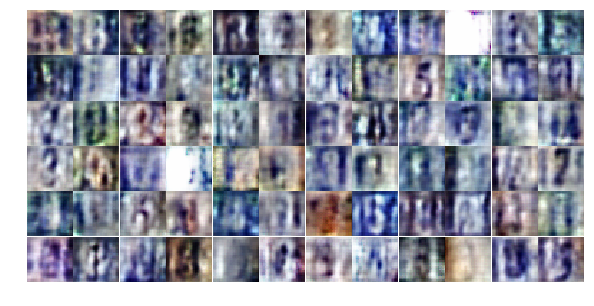

Epoch 12/25... Discriminator Loss: 1.1790... Generator Loss: 1.0472
Epoch 12/25... Discriminator Loss: 1.2145... Generator Loss: 0.8972
Epoch 12/25... Discriminator Loss: 1.2528... Generator Loss: 0.8468
Epoch 12/25... Discriminator Loss: 1.4587... Generator Loss: 0.7271
Epoch 12/25... Discriminator Loss: 1.2284... Generator Loss: 0.8920
Epoch 12/25... Discriminator Loss: 1.2890... Generator Loss: 0.7782
Epoch 12/25... Discriminator Loss: 1.2643... Generator Loss: 0.9708
Epoch 12/25... Discriminator Loss: 1.1492... Generator Loss: 0.9561
Epoch 12/25... Discriminator Loss: 1.3481... Generator Loss: 0.9637
Epoch 12/25... Discriminator Loss: 0.9536... Generator Loss: 3.2249


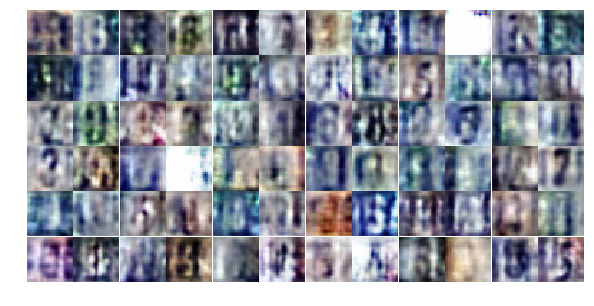

Epoch 12/25... Discriminator Loss: 1.2946... Generator Loss: 0.8302
Epoch 12/25... Discriminator Loss: 1.3209... Generator Loss: 0.8862
Epoch 12/25... Discriminator Loss: 1.1679... Generator Loss: 1.0592
Epoch 12/25... Discriminator Loss: 1.2630... Generator Loss: 0.8649
Epoch 12/25... Discriminator Loss: 1.3200... Generator Loss: 0.8328
Epoch 12/25... Discriminator Loss: 1.2565... Generator Loss: 0.9548
Epoch 12/25... Discriminator Loss: 1.2493... Generator Loss: 0.9923
Epoch 12/25... Discriminator Loss: 1.2076... Generator Loss: 0.9422
Epoch 12/25... Discriminator Loss: 1.2601... Generator Loss: 0.8901
Epoch 12/25... Discriminator Loss: 1.2442... Generator Loss: 0.8675


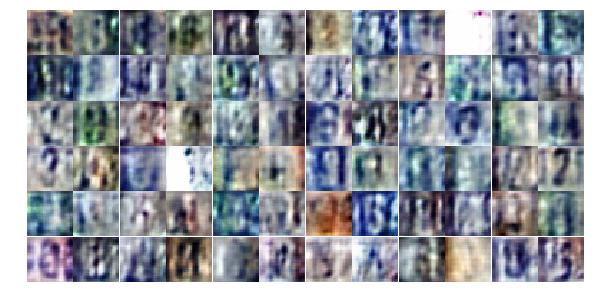

Epoch 12/25... Discriminator Loss: 1.0530... Generator Loss: 1.7145
Epoch 12/25... Discriminator Loss: 1.2065... Generator Loss: 0.8366
Epoch 12/25... Discriminator Loss: 1.1952... Generator Loss: 0.8697
Epoch 12/25... Discriminator Loss: 1.3352... Generator Loss: 0.8696
Epoch 12/25... Discriminator Loss: 1.1757... Generator Loss: 0.8956
Epoch 12/25... Discriminator Loss: 1.2167... Generator Loss: 0.8529
Epoch 12/25... Discriminator Loss: 1.2647... Generator Loss: 0.8723
Epoch 12/25... Discriminator Loss: 1.3033... Generator Loss: 0.8669
Epoch 12/25... Discriminator Loss: 1.2462... Generator Loss: 0.8654
Epoch 12/25... Discriminator Loss: 1.2077... Generator Loss: 0.8090


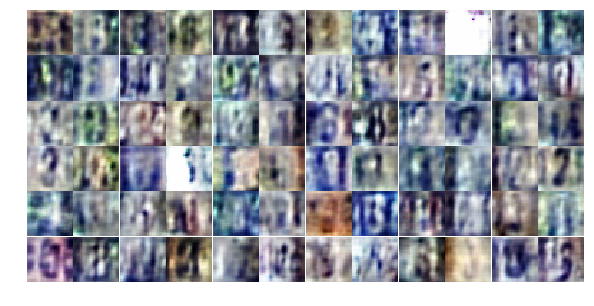

Epoch 12/25... Discriminator Loss: 1.2832... Generator Loss: 0.8770
Epoch 12/25... Discriminator Loss: 1.2551... Generator Loss: 0.8868
Epoch 12/25... Discriminator Loss: 1.2748... Generator Loss: 0.7383
Epoch 12/25... Discriminator Loss: 1.2345... Generator Loss: 0.7878
Epoch 12/25... Discriminator Loss: 1.1786... Generator Loss: 1.1292
Epoch 12/25... Discriminator Loss: 1.2404... Generator Loss: 0.8427
Epoch 12/25... Discriminator Loss: 1.1703... Generator Loss: 0.8841
Epoch 13/25... Discriminator Loss: 1.3371... Generator Loss: 1.0371
Epoch 13/25... Discriminator Loss: 1.3207... Generator Loss: 0.7836
Epoch 13/25... Discriminator Loss: 1.4021... Generator Loss: 0.7167


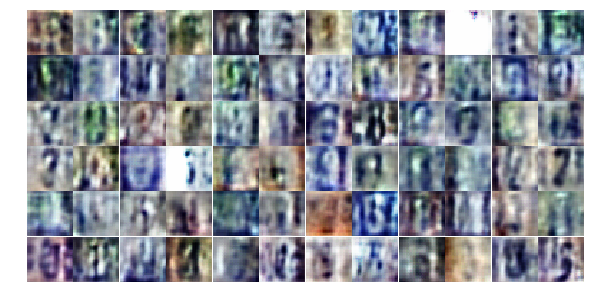

Epoch 13/25... Discriminator Loss: 1.1508... Generator Loss: 0.9118
Epoch 13/25... Discriminator Loss: 1.2090... Generator Loss: 0.8818
Epoch 13/25... Discriminator Loss: 1.3224... Generator Loss: 0.7944
Epoch 13/25... Discriminator Loss: 1.3106... Generator Loss: 0.8537
Epoch 13/25... Discriminator Loss: 1.3112... Generator Loss: 0.8695
Epoch 13/25... Discriminator Loss: 1.2918... Generator Loss: 0.7960
Epoch 13/25... Discriminator Loss: 1.3000... Generator Loss: 1.0310
Epoch 13/25... Discriminator Loss: 1.4505... Generator Loss: 0.9508
Epoch 13/25... Discriminator Loss: 1.2695... Generator Loss: 0.9142
Epoch 13/25... Discriminator Loss: 1.3394... Generator Loss: 0.8221


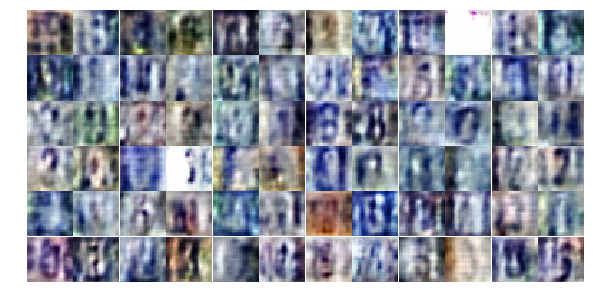

Epoch 13/25... Discriminator Loss: 1.3686... Generator Loss: 0.8362
Epoch 13/25... Discriminator Loss: 1.2537... Generator Loss: 0.9298
Epoch 13/25... Discriminator Loss: 1.2536... Generator Loss: 0.9312
Epoch 13/25... Discriminator Loss: 1.3346... Generator Loss: 0.9341
Epoch 13/25... Discriminator Loss: 1.1104... Generator Loss: 1.0324
Epoch 13/25... Discriminator Loss: 1.2167... Generator Loss: 0.9191
Epoch 13/25... Discriminator Loss: 1.3226... Generator Loss: 0.7538
Epoch 13/25... Discriminator Loss: 1.3161... Generator Loss: 0.8548
Epoch 13/25... Discriminator Loss: 1.2504... Generator Loss: 0.8695
Epoch 13/25... Discriminator Loss: 1.2722... Generator Loss: 0.9027


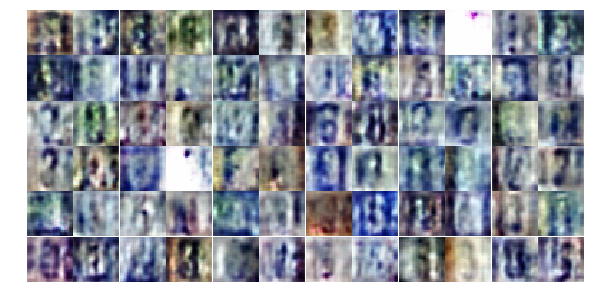

Epoch 13/25... Discriminator Loss: 1.2059... Generator Loss: 0.9036
Epoch 13/25... Discriminator Loss: 1.3346... Generator Loss: 1.1303
Epoch 13/25... Discriminator Loss: 1.2838... Generator Loss: 0.8603
Epoch 13/25... Discriminator Loss: 1.2142... Generator Loss: 0.8657
Epoch 13/25... Discriminator Loss: 1.2555... Generator Loss: 0.9534
Epoch 13/25... Discriminator Loss: 1.2201... Generator Loss: 0.8590
Epoch 13/25... Discriminator Loss: 1.3756... Generator Loss: 0.7420
Epoch 13/25... Discriminator Loss: 1.2597... Generator Loss: 0.9252
Epoch 13/25... Discriminator Loss: 1.2444... Generator Loss: 0.9403
Epoch 13/25... Discriminator Loss: 1.2460... Generator Loss: 0.7907


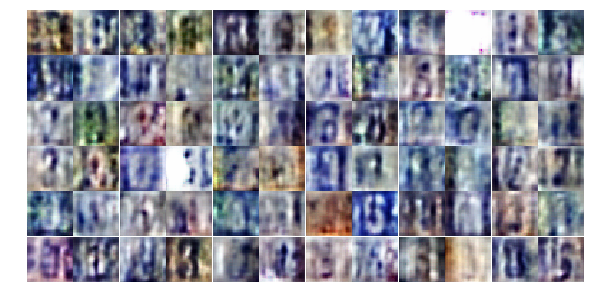

Epoch 13/25... Discriminator Loss: 1.3359... Generator Loss: 0.7959
Epoch 13/25... Discriminator Loss: 1.3899... Generator Loss: 0.7881
Epoch 13/25... Discriminator Loss: 1.3208... Generator Loss: 0.8685
Epoch 13/25... Discriminator Loss: 1.2293... Generator Loss: 0.7993
Epoch 13/25... Discriminator Loss: 1.2502... Generator Loss: 0.9292
Epoch 13/25... Discriminator Loss: 1.2287... Generator Loss: 0.8449
Epoch 13/25... Discriminator Loss: 1.2696... Generator Loss: 0.9120
Epoch 13/25... Discriminator Loss: 1.3159... Generator Loss: 0.9223
Epoch 13/25... Discriminator Loss: 1.2686... Generator Loss: 0.9656
Epoch 13/25... Discriminator Loss: 1.3487... Generator Loss: 0.8162


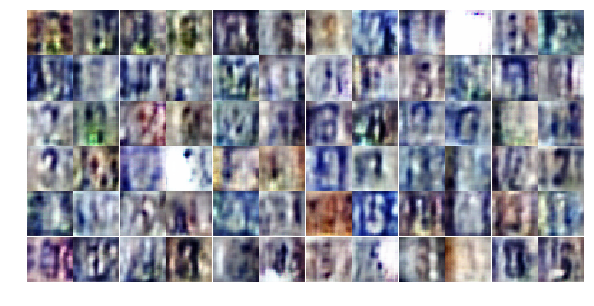

Epoch 13/25... Discriminator Loss: 1.1231... Generator Loss: 1.1324
Epoch 13/25... Discriminator Loss: 1.3512... Generator Loss: 0.7081
Epoch 13/25... Discriminator Loss: 1.3401... Generator Loss: 0.7771
Epoch 13/25... Discriminator Loss: 1.3080... Generator Loss: 0.8896
Epoch 13/25... Discriminator Loss: 1.3083... Generator Loss: 0.7587
Epoch 13/25... Discriminator Loss: 1.3520... Generator Loss: 0.8170
Epoch 13/25... Discriminator Loss: 1.2355... Generator Loss: 0.8968
Epoch 13/25... Discriminator Loss: 1.1825... Generator Loss: 0.9084
Epoch 13/25... Discriminator Loss: 1.2760... Generator Loss: 0.8591
Epoch 13/25... Discriminator Loss: 1.2784... Generator Loss: 1.0501


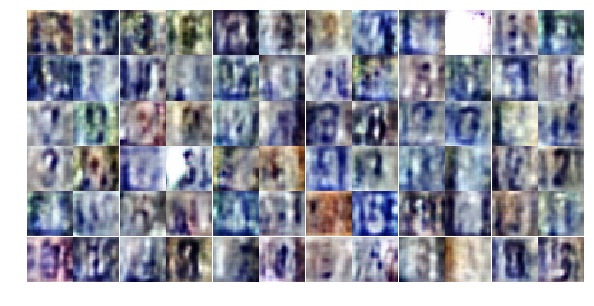

Epoch 13/25... Discriminator Loss: 1.2410... Generator Loss: 0.9446
Epoch 13/25... Discriminator Loss: 1.2338... Generator Loss: 0.9790
Epoch 13/25... Discriminator Loss: 1.3307... Generator Loss: 0.9042
Epoch 13/25... Discriminator Loss: 1.1027... Generator Loss: 1.1688
Epoch 14/25... Discriminator Loss: 1.3072... Generator Loss: 0.8395
Epoch 14/25... Discriminator Loss: 1.2700... Generator Loss: 0.9012
Epoch 14/25... Discriminator Loss: 1.1719... Generator Loss: 0.9296
Epoch 14/25... Discriminator Loss: 1.1529... Generator Loss: 0.9301
Epoch 14/25... Discriminator Loss: 1.3954... Generator Loss: 0.8063
Epoch 14/25... Discriminator Loss: 1.2063... Generator Loss: 0.8421


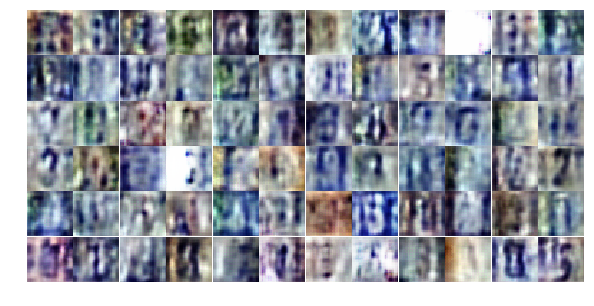

Epoch 14/25... Discriminator Loss: 1.3720... Generator Loss: 0.8156
Epoch 14/25... Discriminator Loss: 1.3697... Generator Loss: 0.9109
Epoch 14/25... Discriminator Loss: 1.2125... Generator Loss: 0.8023
Epoch 14/25... Discriminator Loss: 1.2840... Generator Loss: 0.8996
Epoch 14/25... Discriminator Loss: 1.3262... Generator Loss: 0.8180
Epoch 14/25... Discriminator Loss: 1.3043... Generator Loss: 0.9055
Epoch 14/25... Discriminator Loss: 1.2832... Generator Loss: 0.7839
Epoch 14/25... Discriminator Loss: 1.2780... Generator Loss: 0.9695
Epoch 14/25... Discriminator Loss: 1.1565... Generator Loss: 0.8872
Epoch 14/25... Discriminator Loss: 1.4380... Generator Loss: 0.7854


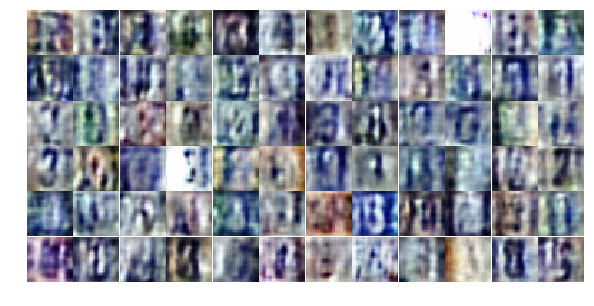

Epoch 14/25... Discriminator Loss: 1.2598... Generator Loss: 0.8292
Epoch 14/25... Discriminator Loss: 1.2230... Generator Loss: 0.9108
Epoch 14/25... Discriminator Loss: 1.2852... Generator Loss: 1.0329
Epoch 14/25... Discriminator Loss: 1.2722... Generator Loss: 0.7864
Epoch 14/25... Discriminator Loss: 1.1641... Generator Loss: 0.9038
Epoch 14/25... Discriminator Loss: 1.2007... Generator Loss: 0.7983
Epoch 14/25... Discriminator Loss: 1.2231... Generator Loss: 0.8902
Epoch 14/25... Discriminator Loss: 1.3212... Generator Loss: 0.8983
Epoch 14/25... Discriminator Loss: 1.2248... Generator Loss: 0.8773
Epoch 14/25... Discriminator Loss: 1.2297... Generator Loss: 0.8476


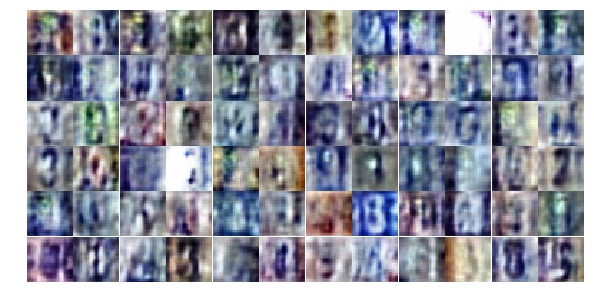

Epoch 14/25... Discriminator Loss: 1.1991... Generator Loss: 1.0978
Epoch 14/25... Discriminator Loss: 1.2328... Generator Loss: 0.9321
Epoch 14/25... Discriminator Loss: 1.3220... Generator Loss: 0.8386
Epoch 14/25... Discriminator Loss: 1.2978... Generator Loss: 0.8612
Epoch 14/25... Discriminator Loss: 1.2998... Generator Loss: 0.8546
Epoch 14/25... Discriminator Loss: 1.1097... Generator Loss: 1.1369
Epoch 14/25... Discriminator Loss: 1.2260... Generator Loss: 0.9900
Epoch 14/25... Discriminator Loss: 1.1587... Generator Loss: 0.9163
Epoch 14/25... Discriminator Loss: 1.4882... Generator Loss: 0.8642
Epoch 14/25... Discriminator Loss: 1.3047... Generator Loss: 0.9462


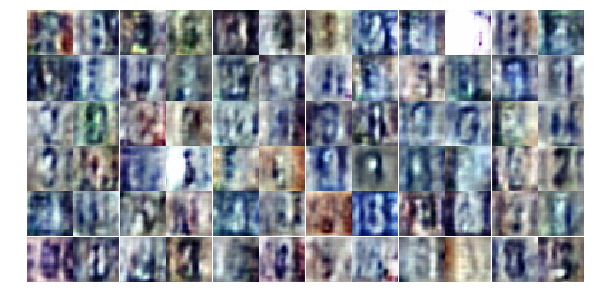

Epoch 14/25... Discriminator Loss: 1.2258... Generator Loss: 1.1273
Epoch 14/25... Discriminator Loss: 1.3994... Generator Loss: 0.7871
Epoch 14/25... Discriminator Loss: 1.2443... Generator Loss: 0.9082
Epoch 14/25... Discriminator Loss: 1.2327... Generator Loss: 1.0302
Epoch 14/25... Discriminator Loss: 1.2978... Generator Loss: 0.8504
Epoch 14/25... Discriminator Loss: 1.2621... Generator Loss: 0.7761
Epoch 14/25... Discriminator Loss: 1.2170... Generator Loss: 0.8952
Epoch 14/25... Discriminator Loss: 1.2672... Generator Loss: 0.8105
Epoch 14/25... Discriminator Loss: 1.4981... Generator Loss: 0.8032
Epoch 14/25... Discriminator Loss: 1.1790... Generator Loss: 1.1526


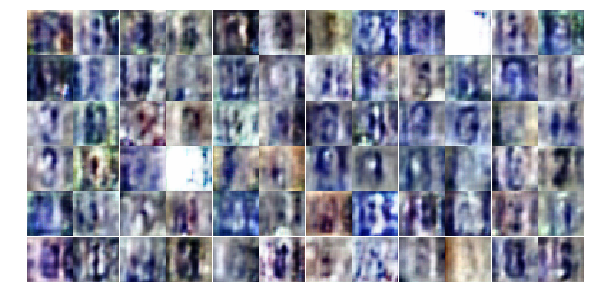

Epoch 14/25... Discriminator Loss: 1.2580... Generator Loss: 0.8117
Epoch 14/25... Discriminator Loss: 1.2011... Generator Loss: 0.9145
Epoch 14/25... Discriminator Loss: 1.2037... Generator Loss: 0.9460
Epoch 14/25... Discriminator Loss: 1.4176... Generator Loss: 0.7902
Epoch 14/25... Discriminator Loss: 1.3194... Generator Loss: 1.0143
Epoch 14/25... Discriminator Loss: 1.2777... Generator Loss: 0.8573
Epoch 14/25... Discriminator Loss: 1.3156... Generator Loss: 0.8326
Epoch 14/25... Discriminator Loss: 1.3764... Generator Loss: 0.9018
Epoch 14/25... Discriminator Loss: 1.3341... Generator Loss: 0.9159
Epoch 14/25... Discriminator Loss: 1.3202... Generator Loss: 0.8172


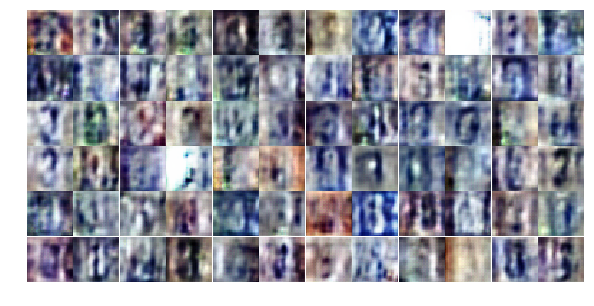

Epoch 14/25... Discriminator Loss: 1.2531... Generator Loss: 0.8976
Epoch 14/25... Discriminator Loss: 1.3819... Generator Loss: 0.7711
Epoch 15/25... Discriminator Loss: 1.2625... Generator Loss: 0.7160
Epoch 15/25... Discriminator Loss: 1.2478... Generator Loss: 0.9277
Epoch 15/25... Discriminator Loss: 1.3702... Generator Loss: 0.7695
Epoch 15/25... Discriminator Loss: 1.3942... Generator Loss: 0.7555
Epoch 15/25... Discriminator Loss: 1.4246... Generator Loss: 0.9747
Epoch 15/25... Discriminator Loss: 1.1620... Generator Loss: 0.9543
Epoch 15/25... Discriminator Loss: 1.4166... Generator Loss: 0.8914
Epoch 15/25... Discriminator Loss: 1.1495... Generator Loss: 0.9622


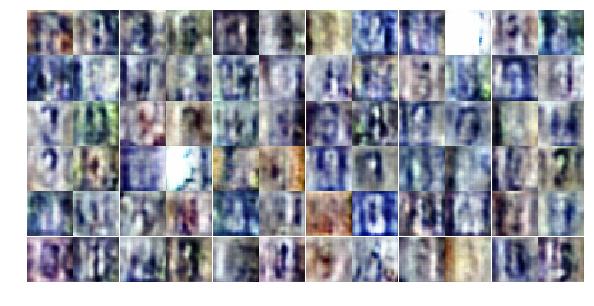

Epoch 15/25... Discriminator Loss: 1.2188... Generator Loss: 0.9250
Epoch 15/25... Discriminator Loss: 1.5394... Generator Loss: 0.8110
Epoch 15/25... Discriminator Loss: 1.3803... Generator Loss: 0.7752
Epoch 15/25... Discriminator Loss: 1.2274... Generator Loss: 0.7526
Epoch 15/25... Discriminator Loss: 1.2787... Generator Loss: 0.8300
Epoch 15/25... Discriminator Loss: 1.0124... Generator Loss: 1.6138
Epoch 15/25... Discriminator Loss: 1.2671... Generator Loss: 0.8703
Epoch 15/25... Discriminator Loss: 1.1501... Generator Loss: 0.9000
Epoch 15/25... Discriminator Loss: 1.3081... Generator Loss: 0.8025
Epoch 15/25... Discriminator Loss: 1.2794... Generator Loss: 0.8153


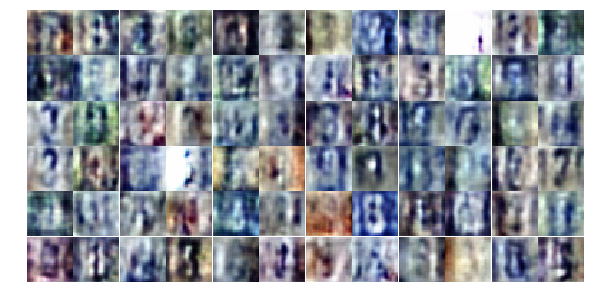

Epoch 15/25... Discriminator Loss: 1.3010... Generator Loss: 0.7947
Epoch 15/25... Discriminator Loss: 1.3249... Generator Loss: 0.8949
Epoch 15/25... Discriminator Loss: 1.2961... Generator Loss: 0.8931
Epoch 15/25... Discriminator Loss: 1.3991... Generator Loss: 0.8493
Epoch 15/25... Discriminator Loss: 1.4292... Generator Loss: 0.7461
Epoch 15/25... Discriminator Loss: 1.3331... Generator Loss: 0.8154
Epoch 15/25... Discriminator Loss: 1.1858... Generator Loss: 0.9792
Epoch 15/25... Discriminator Loss: 1.3311... Generator Loss: 0.8032
Epoch 15/25... Discriminator Loss: 1.2666... Generator Loss: 0.7912
Epoch 15/25... Discriminator Loss: 1.1899... Generator Loss: 0.7974


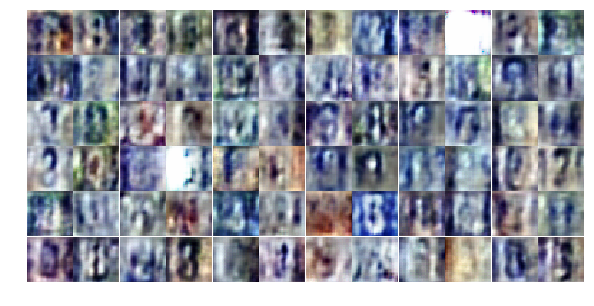

Epoch 15/25... Discriminator Loss: 1.1818... Generator Loss: 0.9406
Epoch 15/25... Discriminator Loss: 1.3843... Generator Loss: 0.8930
Epoch 15/25... Discriminator Loss: 1.2732... Generator Loss: 0.8284
Epoch 15/25... Discriminator Loss: 1.0568... Generator Loss: 2.4647
Epoch 15/25... Discriminator Loss: 1.0457... Generator Loss: 2.2549
Epoch 15/25... Discriminator Loss: 1.3046... Generator Loss: 0.7539
Epoch 15/25... Discriminator Loss: 1.2065... Generator Loss: 0.8030
Epoch 15/25... Discriminator Loss: 1.3180... Generator Loss: 0.7896
Epoch 15/25... Discriminator Loss: 1.1730... Generator Loss: 0.8756
Epoch 15/25... Discriminator Loss: 1.3291... Generator Loss: 0.8220


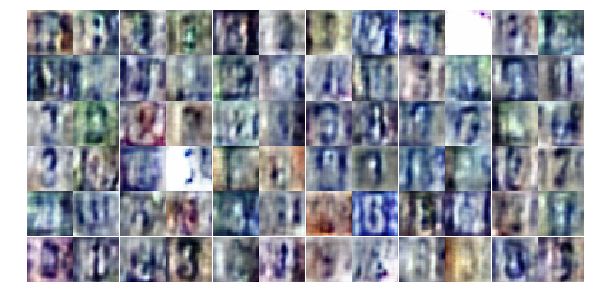

Epoch 15/25... Discriminator Loss: 1.1745... Generator Loss: 1.2181
Epoch 15/25... Discriminator Loss: 1.2662... Generator Loss: 0.7720
Epoch 15/25... Discriminator Loss: 1.4411... Generator Loss: 0.8765
Epoch 15/25... Discriminator Loss: 1.2447... Generator Loss: 0.9341
Epoch 15/25... Discriminator Loss: 1.3025... Generator Loss: 0.8301
Epoch 15/25... Discriminator Loss: 1.3980... Generator Loss: 0.6839
Epoch 15/25... Discriminator Loss: 1.2642... Generator Loss: 0.8030
Epoch 15/25... Discriminator Loss: 1.3183... Generator Loss: 0.8616
Epoch 15/25... Discriminator Loss: 1.2371... Generator Loss: 0.8968
Epoch 15/25... Discriminator Loss: 1.3079... Generator Loss: 0.7771


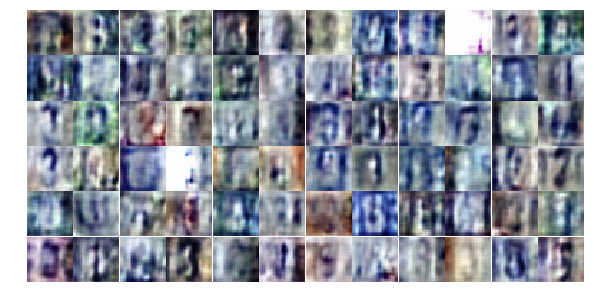

Epoch 15/25... Discriminator Loss: 1.3475... Generator Loss: 0.7656
Epoch 15/25... Discriminator Loss: 1.2622... Generator Loss: 0.8040
Epoch 15/25... Discriminator Loss: 1.2078... Generator Loss: 0.9024
Epoch 15/25... Discriminator Loss: 1.3038... Generator Loss: 0.8908
Epoch 15/25... Discriminator Loss: 1.3385... Generator Loss: 0.7202
Epoch 15/25... Discriminator Loss: 1.3051... Generator Loss: 0.8244
Epoch 15/25... Discriminator Loss: 1.2995... Generator Loss: 0.8183
Epoch 15/25... Discriminator Loss: 1.3651... Generator Loss: 0.7529
Epoch 15/25... Discriminator Loss: 1.2627... Generator Loss: 0.8761
Epoch 16/25... Discriminator Loss: 1.2222... Generator Loss: 0.8844


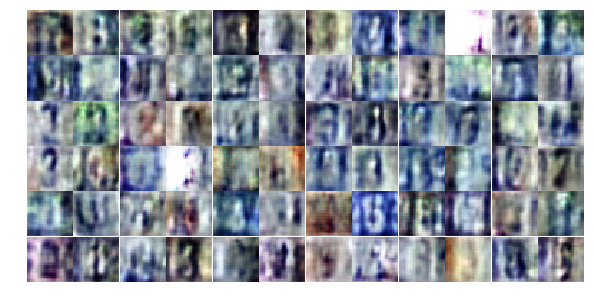

Epoch 16/25... Discriminator Loss: 1.2449... Generator Loss: 0.8939
Epoch 16/25... Discriminator Loss: 1.3251... Generator Loss: 0.8961
Epoch 16/25... Discriminator Loss: 1.3687... Generator Loss: 0.8738
Epoch 16/25... Discriminator Loss: 1.3246... Generator Loss: 0.8155
Epoch 16/25... Discriminator Loss: 1.2343... Generator Loss: 1.0105
Epoch 16/25... Discriminator Loss: 1.3154... Generator Loss: 0.7451
Epoch 16/25... Discriminator Loss: 1.1737... Generator Loss: 0.9667
Epoch 16/25... Discriminator Loss: 1.3445... Generator Loss: 0.8097
Epoch 16/25... Discriminator Loss: 1.3355... Generator Loss: 0.8524
Epoch 16/25... Discriminator Loss: 1.0788... Generator Loss: 1.4065


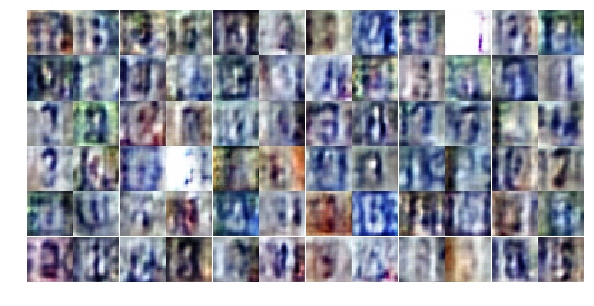

Epoch 16/25... Discriminator Loss: 1.2632... Generator Loss: 1.0011
Epoch 16/25... Discriminator Loss: 1.1746... Generator Loss: 1.1507
Epoch 16/25... Discriminator Loss: 1.2629... Generator Loss: 0.8086
Epoch 16/25... Discriminator Loss: 1.2003... Generator Loss: 0.9377
Epoch 16/25... Discriminator Loss: 1.2017... Generator Loss: 0.7969
Epoch 16/25... Discriminator Loss: 1.2391... Generator Loss: 0.8906
Epoch 16/25... Discriminator Loss: 1.3594... Generator Loss: 0.9107
Epoch 16/25... Discriminator Loss: 1.2608... Generator Loss: 0.8824
Epoch 16/25... Discriminator Loss: 1.2454... Generator Loss: 0.8371
Epoch 16/25... Discriminator Loss: 1.0422... Generator Loss: 1.7422


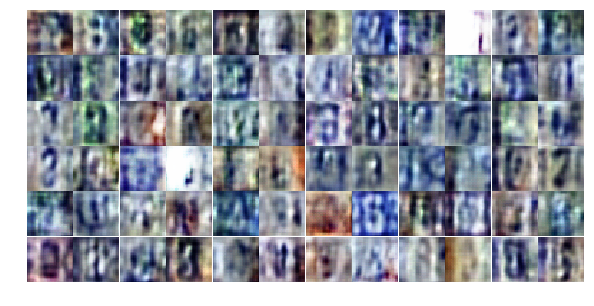

Epoch 16/25... Discriminator Loss: 1.3786... Generator Loss: 0.7921
Epoch 16/25... Discriminator Loss: 1.2684... Generator Loss: 0.8735
Epoch 16/25... Discriminator Loss: 1.2934... Generator Loss: 0.8112
Epoch 16/25... Discriminator Loss: 1.3418... Generator Loss: 0.8234
Epoch 16/25... Discriminator Loss: 1.2770... Generator Loss: 0.9033
Epoch 16/25... Discriminator Loss: 1.2034... Generator Loss: 0.8412
Epoch 16/25... Discriminator Loss: 1.3208... Generator Loss: 0.8655
Epoch 16/25... Discriminator Loss: 1.2816... Generator Loss: 0.8443
Epoch 16/25... Discriminator Loss: 1.2008... Generator Loss: 1.0127
Epoch 16/25... Discriminator Loss: 1.3438... Generator Loss: 0.7093


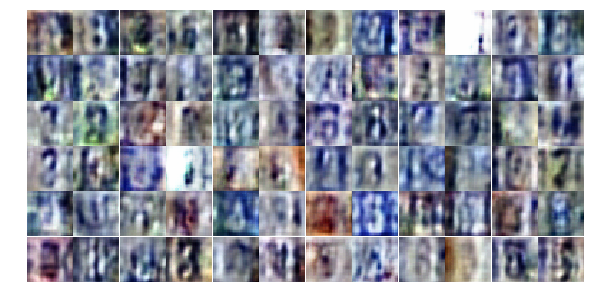

Epoch 16/25... Discriminator Loss: 1.2291... Generator Loss: 0.9222
Epoch 16/25... Discriminator Loss: 1.2283... Generator Loss: 0.7814
Epoch 16/25... Discriminator Loss: 1.2680... Generator Loss: 0.8895
Epoch 16/25... Discriminator Loss: 1.2910... Generator Loss: 0.8648
Epoch 16/25... Discriminator Loss: 1.3184... Generator Loss: 0.9223
Epoch 16/25... Discriminator Loss: 1.2455... Generator Loss: 0.8341
Epoch 16/25... Discriminator Loss: 1.2769... Generator Loss: 0.7786
Epoch 16/25... Discriminator Loss: 1.2390... Generator Loss: 0.9130
Epoch 16/25... Discriminator Loss: 1.2535... Generator Loss: 0.8996
Epoch 16/25... Discriminator Loss: 1.0963... Generator Loss: 0.9189


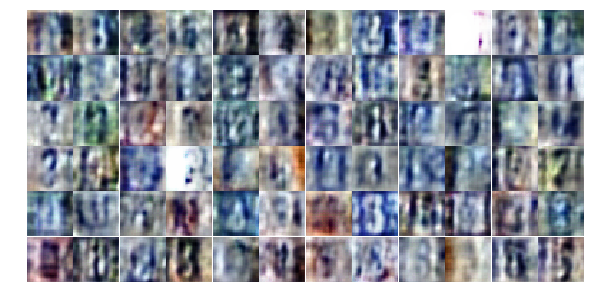

Epoch 16/25... Discriminator Loss: 1.1848... Generator Loss: 0.9863
Epoch 16/25... Discriminator Loss: 1.2999... Generator Loss: 0.8492
Epoch 16/25... Discriminator Loss: 1.3211... Generator Loss: 1.1542
Epoch 16/25... Discriminator Loss: 1.3006... Generator Loss: 0.7914
Epoch 16/25... Discriminator Loss: 1.2395... Generator Loss: 0.8710
Epoch 16/25... Discriminator Loss: 1.1997... Generator Loss: 0.9554
Epoch 16/25... Discriminator Loss: 1.2313... Generator Loss: 0.8881
Epoch 16/25... Discriminator Loss: 1.3141... Generator Loss: 0.7910
Epoch 16/25... Discriminator Loss: 1.3281... Generator Loss: 0.7934
Epoch 16/25... Discriminator Loss: 1.3535... Generator Loss: 0.8474


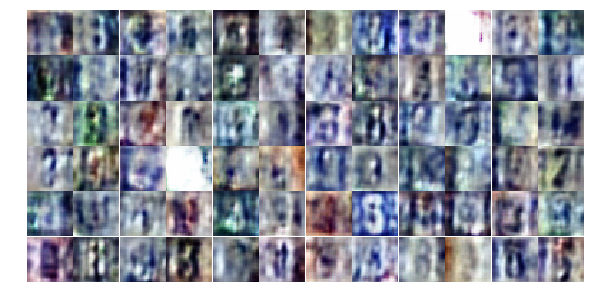

Epoch 16/25... Discriminator Loss: 1.3272... Generator Loss: 0.8265
Epoch 16/25... Discriminator Loss: 1.2461... Generator Loss: 0.8945
Epoch 16/25... Discriminator Loss: 1.2881... Generator Loss: 0.9325
Epoch 16/25... Discriminator Loss: 1.3797... Generator Loss: 0.7290
Epoch 16/25... Discriminator Loss: 1.2772... Generator Loss: 0.8979
Epoch 16/25... Discriminator Loss: 1.1292... Generator Loss: 1.4855
Epoch 17/25... Discriminator Loss: 1.4196... Generator Loss: 0.9234
Epoch 17/25... Discriminator Loss: 1.1774... Generator Loss: 0.9036
Epoch 17/25... Discriminator Loss: 1.2241... Generator Loss: 0.8891
Epoch 17/25... Discriminator Loss: 1.3551... Generator Loss: 0.7396


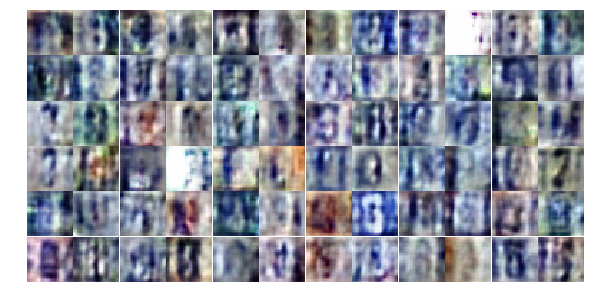

Epoch 17/25... Discriminator Loss: 1.2799... Generator Loss: 0.9273
Epoch 17/25... Discriminator Loss: 1.1847... Generator Loss: 0.8801
Epoch 17/25... Discriminator Loss: 1.3628... Generator Loss: 0.8024
Epoch 17/25... Discriminator Loss: 1.2043... Generator Loss: 0.8356
Epoch 17/25... Discriminator Loss: 1.4222... Generator Loss: 0.8453
Epoch 17/25... Discriminator Loss: 1.2897... Generator Loss: 0.9579
Epoch 17/25... Discriminator Loss: 1.3067... Generator Loss: 0.8534
Epoch 17/25... Discriminator Loss: 1.2294... Generator Loss: 0.9802
Epoch 17/25... Discriminator Loss: 1.2798... Generator Loss: 0.8754
Epoch 17/25... Discriminator Loss: 1.3947... Generator Loss: 0.7333


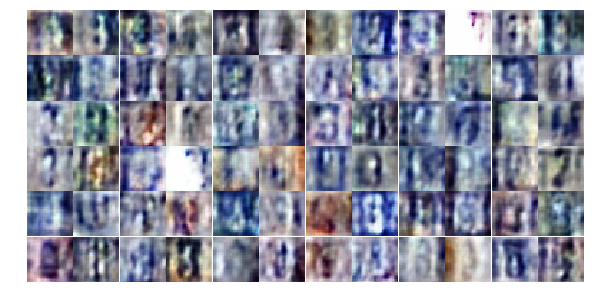

Epoch 17/25... Discriminator Loss: 1.4111... Generator Loss: 0.7564
Epoch 17/25... Discriminator Loss: 1.3030... Generator Loss: 0.7888
Epoch 17/25... Discriminator Loss: 1.2728... Generator Loss: 0.7774
Epoch 17/25... Discriminator Loss: 1.2562... Generator Loss: 0.8546
Epoch 17/25... Discriminator Loss: 1.3656... Generator Loss: 0.7491
Epoch 17/25... Discriminator Loss: 1.2859... Generator Loss: 0.8176
Epoch 17/25... Discriminator Loss: 1.2949... Generator Loss: 0.8660
Epoch 17/25... Discriminator Loss: 1.2538... Generator Loss: 0.7843
Epoch 17/25... Discriminator Loss: 1.2370... Generator Loss: 1.2233
Epoch 17/25... Discriminator Loss: 1.3405... Generator Loss: 0.9410


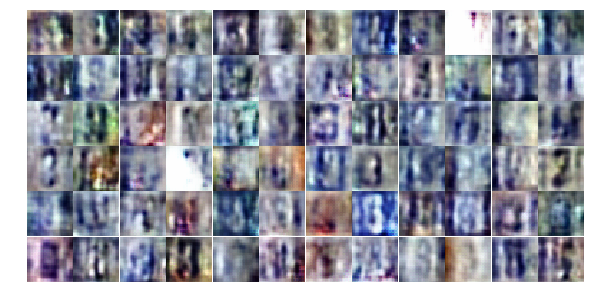

Epoch 17/25... Discriminator Loss: 1.2681... Generator Loss: 0.8988
Epoch 17/25... Discriminator Loss: 1.3495... Generator Loss: 0.7352
Epoch 17/25... Discriminator Loss: 1.2282... Generator Loss: 1.0453
Epoch 17/25... Discriminator Loss: 1.4336... Generator Loss: 0.7652
Epoch 17/25... Discriminator Loss: 1.3005... Generator Loss: 0.8228
Epoch 17/25... Discriminator Loss: 1.3899... Generator Loss: 0.7656
Epoch 17/25... Discriminator Loss: 1.2686... Generator Loss: 0.8687
Epoch 17/25... Discriminator Loss: 1.2761... Generator Loss: 0.9170
Epoch 17/25... Discriminator Loss: 1.3168... Generator Loss: 0.8834
Epoch 17/25... Discriminator Loss: 1.1981... Generator Loss: 1.0242


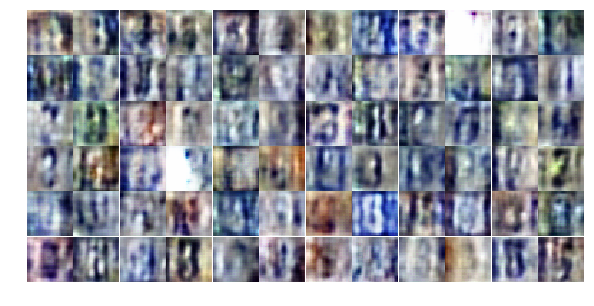

Epoch 17/25... Discriminator Loss: 1.4323... Generator Loss: 0.8260
Epoch 17/25... Discriminator Loss: 1.3294... Generator Loss: 0.9273
Epoch 17/25... Discriminator Loss: 1.3179... Generator Loss: 0.7723
Epoch 17/25... Discriminator Loss: 1.1725... Generator Loss: 1.0049
Epoch 17/25... Discriminator Loss: 1.2272... Generator Loss: 0.8096
Epoch 17/25... Discriminator Loss: 1.2665... Generator Loss: 0.9146
Epoch 17/25... Discriminator Loss: 1.2805... Generator Loss: 0.8996
Epoch 17/25... Discriminator Loss: 1.3799... Generator Loss: 0.7014
Epoch 17/25... Discriminator Loss: 1.2154... Generator Loss: 1.1036
Epoch 17/25... Discriminator Loss: 1.2926... Generator Loss: 0.8577


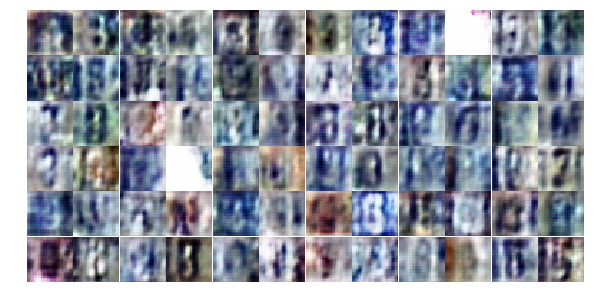

Epoch 17/25... Discriminator Loss: 1.2198... Generator Loss: 0.9528
Epoch 17/25... Discriminator Loss: 1.0462... Generator Loss: 1.0617
Epoch 17/25... Discriminator Loss: 1.1575... Generator Loss: 0.7908
Epoch 17/25... Discriminator Loss: 1.0759... Generator Loss: 1.0246
Epoch 17/25... Discriminator Loss: 1.2397... Generator Loss: 0.9243
Epoch 17/25... Discriminator Loss: 1.4386... Generator Loss: 0.8942
Epoch 17/25... Discriminator Loss: 1.1378... Generator Loss: 0.9255
Epoch 17/25... Discriminator Loss: 1.2572... Generator Loss: 0.9060
Epoch 17/25... Discriminator Loss: 1.2693... Generator Loss: 0.7880
Epoch 17/25... Discriminator Loss: 1.3026... Generator Loss: 0.8594


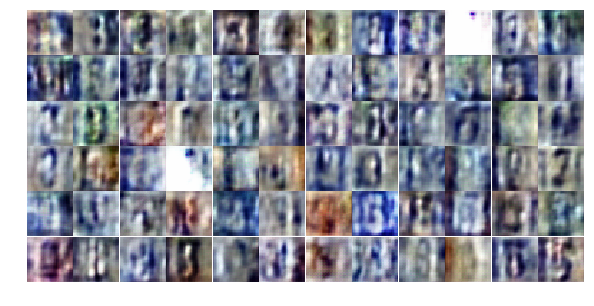

Epoch 17/25... Discriminator Loss: 1.3083... Generator Loss: 0.8874
Epoch 17/25... Discriminator Loss: 1.1439... Generator Loss: 0.9566
Epoch 17/25... Discriminator Loss: 1.3320... Generator Loss: 1.1491
Epoch 17/25... Discriminator Loss: 1.3095... Generator Loss: 0.7429
Epoch 18/25... Discriminator Loss: 1.2275... Generator Loss: 0.8229
Epoch 18/25... Discriminator Loss: 1.2833... Generator Loss: 0.8265
Epoch 18/25... Discriminator Loss: 1.1965... Generator Loss: 0.9381
Epoch 18/25... Discriminator Loss: 1.2536... Generator Loss: 0.8054
Epoch 18/25... Discriminator Loss: 1.2235... Generator Loss: 0.8739
Epoch 18/25... Discriminator Loss: 1.5849... Generator Loss: 0.7524


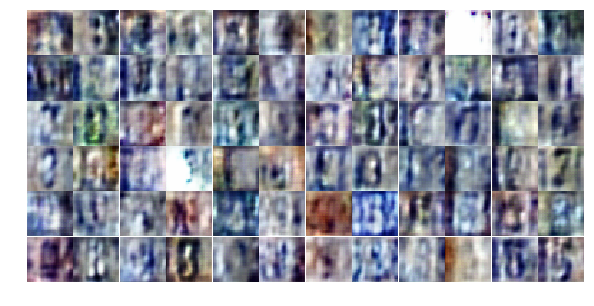

Epoch 18/25... Discriminator Loss: 1.2595... Generator Loss: 0.8634
Epoch 18/25... Discriminator Loss: 1.2876... Generator Loss: 0.8254
Epoch 18/25... Discriminator Loss: 1.2227... Generator Loss: 0.9059
Epoch 18/25... Discriminator Loss: 1.3805... Generator Loss: 0.7780
Epoch 18/25... Discriminator Loss: 1.2560... Generator Loss: 0.8654
Epoch 18/25... Discriminator Loss: 1.2873... Generator Loss: 0.7492
Epoch 18/25... Discriminator Loss: 1.3250... Generator Loss: 0.8452
Epoch 18/25... Discriminator Loss: 1.1197... Generator Loss: 0.9298
Epoch 18/25... Discriminator Loss: 1.3593... Generator Loss: 0.8640
Epoch 18/25... Discriminator Loss: 1.3654... Generator Loss: 0.8462


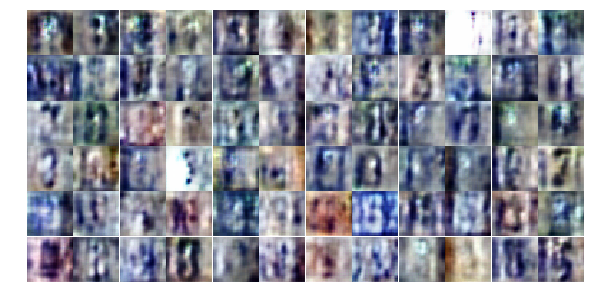

Epoch 18/25... Discriminator Loss: 1.1525... Generator Loss: 1.7700
Epoch 18/25... Discriminator Loss: 1.2411... Generator Loss: 0.9335
Epoch 18/25... Discriminator Loss: 1.2990... Generator Loss: 0.9320
Epoch 18/25... Discriminator Loss: 1.2293... Generator Loss: 0.8940
Epoch 18/25... Discriminator Loss: 1.3953... Generator Loss: 0.7794
Epoch 18/25... Discriminator Loss: 1.2907... Generator Loss: 0.8712
Epoch 18/25... Discriminator Loss: 1.2088... Generator Loss: 1.1064
Epoch 18/25... Discriminator Loss: 1.2258... Generator Loss: 1.0608
Epoch 18/25... Discriminator Loss: 1.3249... Generator Loss: 0.8717
Epoch 18/25... Discriminator Loss: 1.2990... Generator Loss: 0.9544


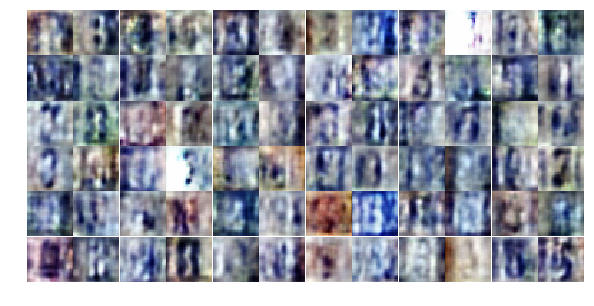

Epoch 18/25... Discriminator Loss: 1.2360... Generator Loss: 0.8188
Epoch 18/25... Discriminator Loss: 1.4067... Generator Loss: 0.7542
Epoch 18/25... Discriminator Loss: 1.3110... Generator Loss: 0.7620
Epoch 18/25... Discriminator Loss: 1.2072... Generator Loss: 0.9842
Epoch 18/25... Discriminator Loss: 1.2043... Generator Loss: 0.8251
Epoch 18/25... Discriminator Loss: 1.3414... Generator Loss: 0.8361
Epoch 18/25... Discriminator Loss: 1.2267... Generator Loss: 0.8045
Epoch 18/25... Discriminator Loss: 1.1970... Generator Loss: 0.8318
Epoch 18/25... Discriminator Loss: 1.2507... Generator Loss: 0.8106
Epoch 18/25... Discriminator Loss: 1.4529... Generator Loss: 0.8016


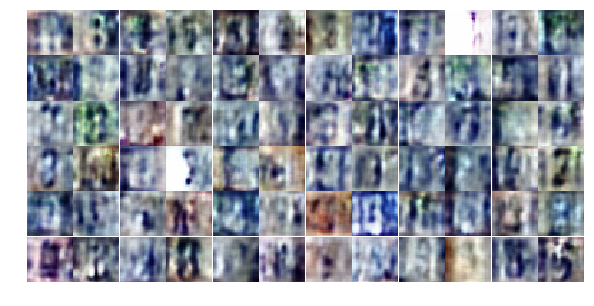

Epoch 18/25... Discriminator Loss: 1.1548... Generator Loss: 0.8674
Epoch 18/25... Discriminator Loss: 1.1908... Generator Loss: 0.8792
Epoch 18/25... Discriminator Loss: 1.3379... Generator Loss: 0.9263
Epoch 18/25... Discriminator Loss: 1.2966... Generator Loss: 0.7716
Epoch 18/25... Discriminator Loss: 1.2387... Generator Loss: 0.9177
Epoch 18/25... Discriminator Loss: 1.2463... Generator Loss: 0.9054
Epoch 18/25... Discriminator Loss: 1.3514... Generator Loss: 0.7714
Epoch 18/25... Discriminator Loss: 1.2277... Generator Loss: 0.8351
Epoch 18/25... Discriminator Loss: 1.1816... Generator Loss: 0.9141
Epoch 18/25... Discriminator Loss: 1.3664... Generator Loss: 0.8727


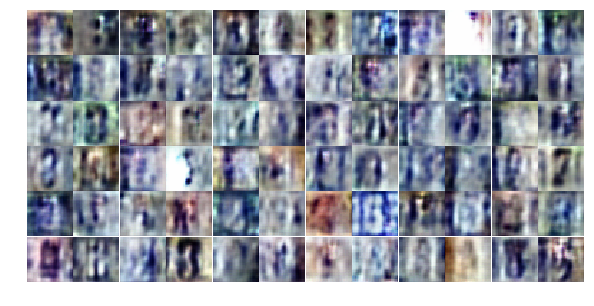

Epoch 18/25... Discriminator Loss: 1.2279... Generator Loss: 0.9385
Epoch 18/25... Discriminator Loss: 1.3360... Generator Loss: 0.9745
Epoch 18/25... Discriminator Loss: 1.2082... Generator Loss: 0.8935
Epoch 18/25... Discriminator Loss: 1.3122... Generator Loss: 0.8524
Epoch 18/25... Discriminator Loss: 1.2583... Generator Loss: 0.7948
Epoch 18/25... Discriminator Loss: 1.1860... Generator Loss: 0.9210
Epoch 18/25... Discriminator Loss: 1.2984... Generator Loss: 0.8203
Epoch 18/25... Discriminator Loss: 1.2960... Generator Loss: 0.8527
Epoch 18/25... Discriminator Loss: 1.4221... Generator Loss: 0.7182
Epoch 18/25... Discriminator Loss: 1.1890... Generator Loss: 0.8241


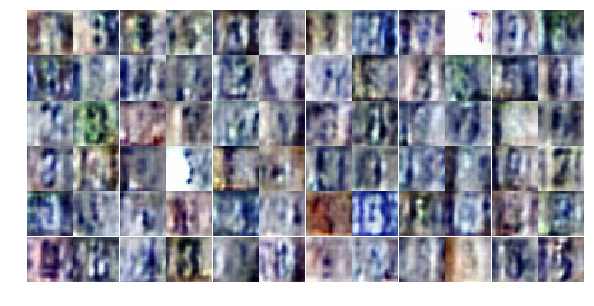

Epoch 18/25... Discriminator Loss: 1.2294... Generator Loss: 0.9125
Epoch 19/25... Discriminator Loss: 1.4909... Generator Loss: 0.7988
Epoch 19/25... Discriminator Loss: 1.3601... Generator Loss: 0.8326
Epoch 19/25... Discriminator Loss: 1.2757... Generator Loss: 0.8796
Epoch 19/25... Discriminator Loss: 1.1939... Generator Loss: 1.1186
Epoch 19/25... Discriminator Loss: 1.4558... Generator Loss: 0.8077
Epoch 19/25... Discriminator Loss: 1.2883... Generator Loss: 0.8251
Epoch 19/25... Discriminator Loss: 1.4648... Generator Loss: 0.8034
Epoch 19/25... Discriminator Loss: 1.2068... Generator Loss: 0.8957
Epoch 19/25... Discriminator Loss: 1.2591... Generator Loss: 0.8144


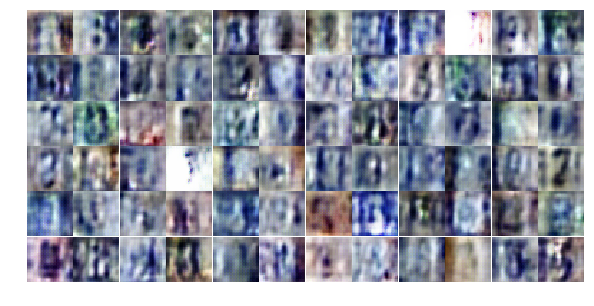

Epoch 19/25... Discriminator Loss: 1.3407... Generator Loss: 0.7643
Epoch 19/25... Discriminator Loss: 1.3939... Generator Loss: 0.7769
Epoch 19/25... Discriminator Loss: 1.2647... Generator Loss: 0.8759
Epoch 19/25... Discriminator Loss: 0.9467... Generator Loss: 3.1789
Epoch 19/25... Discriminator Loss: 1.2262... Generator Loss: 0.9556
Epoch 19/25... Discriminator Loss: 1.1940... Generator Loss: 0.8923
Epoch 19/25... Discriminator Loss: 1.2445... Generator Loss: 0.8578
Epoch 19/25... Discriminator Loss: 1.4086... Generator Loss: 0.8217
Epoch 19/25... Discriminator Loss: 1.1983... Generator Loss: 0.8599
Epoch 19/25... Discriminator Loss: 1.3566... Generator Loss: 0.9138


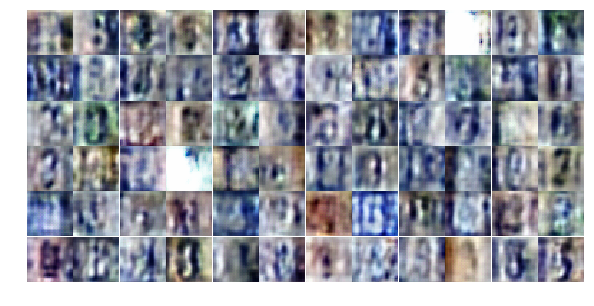

Epoch 19/25... Discriminator Loss: 1.2272... Generator Loss: 0.8340
Epoch 19/25... Discriminator Loss: 1.2505... Generator Loss: 0.8649
Epoch 19/25... Discriminator Loss: 1.2732... Generator Loss: 0.8557
Epoch 19/25... Discriminator Loss: 1.3897... Generator Loss: 0.7835
Epoch 19/25... Discriminator Loss: 1.1956... Generator Loss: 0.8899
Epoch 19/25... Discriminator Loss: 1.4000... Generator Loss: 0.7460
Epoch 19/25... Discriminator Loss: 1.2734... Generator Loss: 0.8087
Epoch 19/25... Discriminator Loss: 1.3854... Generator Loss: 0.8406
Epoch 19/25... Discriminator Loss: 1.2372... Generator Loss: 0.8556
Epoch 19/25... Discriminator Loss: 1.2434... Generator Loss: 0.9083


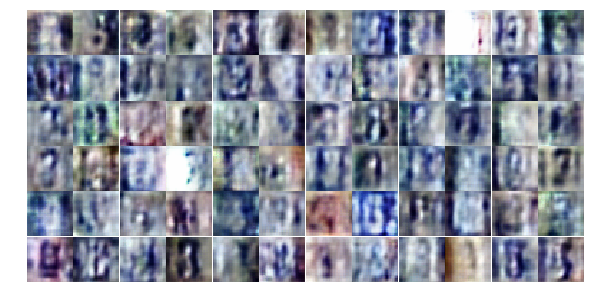

Epoch 19/25... Discriminator Loss: 1.1306... Generator Loss: 0.9626
Epoch 19/25... Discriminator Loss: 1.2893... Generator Loss: 0.7945
Epoch 19/25... Discriminator Loss: 1.4856... Generator Loss: 0.8004
Epoch 19/25... Discriminator Loss: 1.1947... Generator Loss: 0.8572
Epoch 19/25... Discriminator Loss: 1.3421... Generator Loss: 0.8804
Epoch 19/25... Discriminator Loss: 1.3170... Generator Loss: 0.7689
Epoch 19/25... Discriminator Loss: 1.2871... Generator Loss: 0.8597
Epoch 19/25... Discriminator Loss: 1.1916... Generator Loss: 1.0036
Epoch 19/25... Discriminator Loss: 1.3353... Generator Loss: 0.7571
Epoch 19/25... Discriminator Loss: 1.2862... Generator Loss: 0.7745


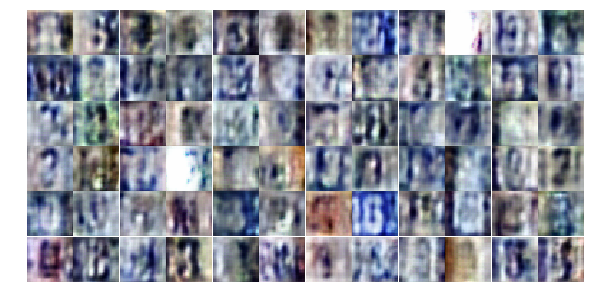

Epoch 19/25... Discriminator Loss: 1.1785... Generator Loss: 0.8178
Epoch 19/25... Discriminator Loss: 1.1422... Generator Loss: 0.8337
Epoch 19/25... Discriminator Loss: 1.3766... Generator Loss: 0.7047
Epoch 19/25... Discriminator Loss: 1.3523... Generator Loss: 0.7376
Epoch 19/25... Discriminator Loss: 1.2295... Generator Loss: 0.9296
Epoch 19/25... Discriminator Loss: 1.3382... Generator Loss: 0.7929
Epoch 19/25... Discriminator Loss: 1.1595... Generator Loss: 0.9322
Epoch 19/25... Discriminator Loss: 1.2868... Generator Loss: 0.8494
Epoch 19/25... Discriminator Loss: 1.3078... Generator Loss: 0.8040
Epoch 19/25... Discriminator Loss: 1.2686... Generator Loss: 0.7901


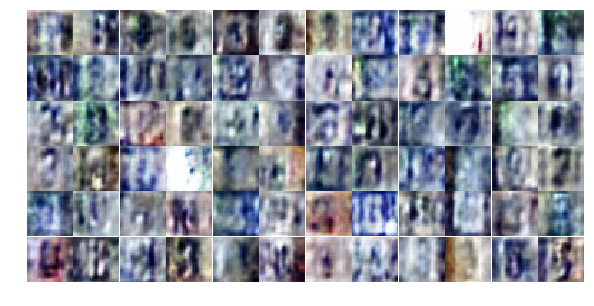

Epoch 19/25... Discriminator Loss: 1.3177... Generator Loss: 0.7194
Epoch 19/25... Discriminator Loss: 1.2788... Generator Loss: 0.9392
Epoch 19/25... Discriminator Loss: 1.1594... Generator Loss: 0.8732
Epoch 19/25... Discriminator Loss: 1.2473... Generator Loss: 0.9078
Epoch 19/25... Discriminator Loss: 1.4434... Generator Loss: 0.8244
Epoch 19/25... Discriminator Loss: 1.2803... Generator Loss: 0.9575
Epoch 19/25... Discriminator Loss: 1.2438... Generator Loss: 0.8867
Epoch 19/25... Discriminator Loss: 1.1960... Generator Loss: 0.8597
Epoch 20/25... Discriminator Loss: 1.2525... Generator Loss: 0.7887
Epoch 20/25... Discriminator Loss: 1.2131... Generator Loss: 0.7830


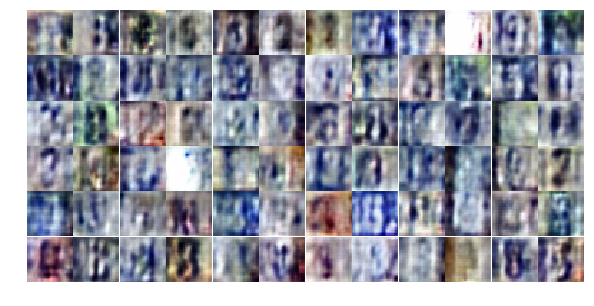

Epoch 20/25... Discriminator Loss: 1.3072... Generator Loss: 0.8155
Epoch 20/25... Discriminator Loss: 1.3959... Generator Loss: 1.1829
Epoch 20/25... Discriminator Loss: 1.3050... Generator Loss: 0.8663
Epoch 20/25... Discriminator Loss: 1.2438... Generator Loss: 0.8449
Epoch 20/25... Discriminator Loss: 1.2187... Generator Loss: 0.8782
Epoch 20/25... Discriminator Loss: 1.3176... Generator Loss: 0.9060
Epoch 20/25... Discriminator Loss: 1.4837... Generator Loss: 0.6818
Epoch 20/25... Discriminator Loss: 1.2241... Generator Loss: 0.9988
Epoch 20/25... Discriminator Loss: 1.3065... Generator Loss: 0.8937
Epoch 20/25... Discriminator Loss: 1.2329... Generator Loss: 0.9165


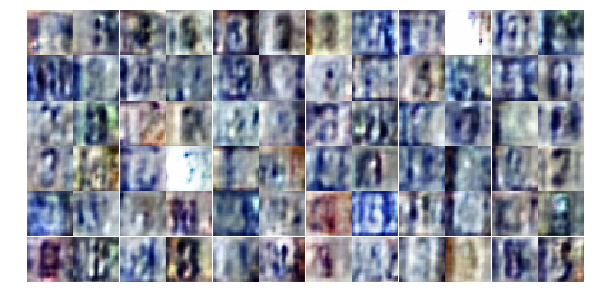

Epoch 20/25... Discriminator Loss: 1.3838... Generator Loss: 0.9553
Epoch 20/25... Discriminator Loss: 1.3070... Generator Loss: 0.7487
Epoch 20/25... Discriminator Loss: 1.2865... Generator Loss: 0.7655
Epoch 20/25... Discriminator Loss: 1.3315... Generator Loss: 0.8048
Epoch 20/25... Discriminator Loss: 1.4044... Generator Loss: 0.7590
Epoch 20/25... Discriminator Loss: 0.9476... Generator Loss: 3.8690
Epoch 20/25... Discriminator Loss: 1.3196... Generator Loss: 0.7983
Epoch 20/25... Discriminator Loss: 1.2984... Generator Loss: 0.8273
Epoch 20/25... Discriminator Loss: 1.1723... Generator Loss: 0.8657
Epoch 20/25... Discriminator Loss: 1.2379... Generator Loss: 0.8520


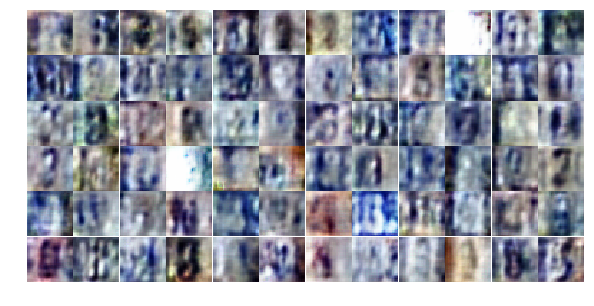

Epoch 20/25... Discriminator Loss: 1.3351... Generator Loss: 0.8430
Epoch 20/25... Discriminator Loss: 1.2034... Generator Loss: 0.9579
Epoch 20/25... Discriminator Loss: 1.2010... Generator Loss: 0.9089
Epoch 20/25... Discriminator Loss: 1.2852... Generator Loss: 0.8905
Epoch 20/25... Discriminator Loss: 1.2815... Generator Loss: 0.9234
Epoch 20/25... Discriminator Loss: 1.1461... Generator Loss: 0.9217
Epoch 20/25... Discriminator Loss: 1.2751... Generator Loss: 0.6854
Epoch 20/25... Discriminator Loss: 1.1769... Generator Loss: 0.7713
Epoch 20/25... Discriminator Loss: 1.1914... Generator Loss: 0.9713
Epoch 20/25... Discriminator Loss: 1.1865... Generator Loss: 0.9897


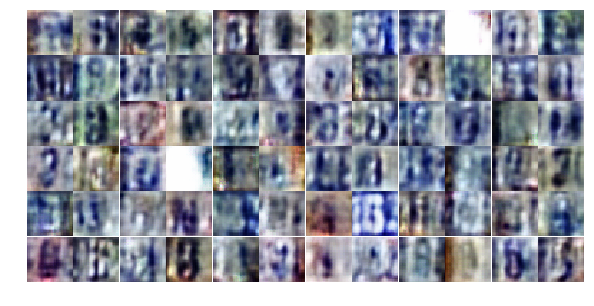

Epoch 20/25... Discriminator Loss: 1.2238... Generator Loss: 0.8549
Epoch 20/25... Discriminator Loss: 1.1924... Generator Loss: 0.8614
Epoch 20/25... Discriminator Loss: 1.1367... Generator Loss: 0.9224
Epoch 20/25... Discriminator Loss: 1.5575... Generator Loss: 0.8950
Epoch 20/25... Discriminator Loss: 1.1999... Generator Loss: 0.8818
Epoch 20/25... Discriminator Loss: 1.3192... Generator Loss: 0.9203
Epoch 20/25... Discriminator Loss: 1.3657... Generator Loss: 0.7487
Epoch 20/25... Discriminator Loss: 1.1799... Generator Loss: 0.8913
Epoch 20/25... Discriminator Loss: 1.3887... Generator Loss: 0.7457
Epoch 20/25... Discriminator Loss: 1.3154... Generator Loss: 0.7607


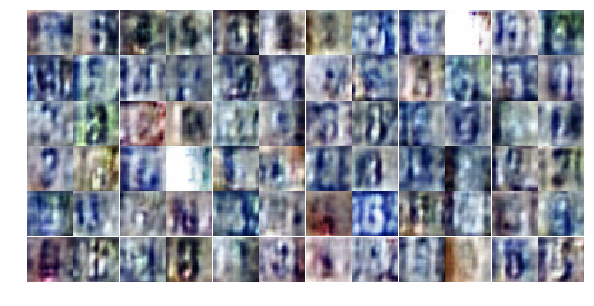

Epoch 20/25... Discriminator Loss: 1.1690... Generator Loss: 0.8878
Epoch 20/25... Discriminator Loss: 1.2320... Generator Loss: 0.8309
Epoch 20/25... Discriminator Loss: 1.3132... Generator Loss: 0.7813
Epoch 20/25... Discriminator Loss: 1.4739... Generator Loss: 0.9694
Epoch 20/25... Discriminator Loss: 1.2104... Generator Loss: 0.8356
Epoch 20/25... Discriminator Loss: 1.2390... Generator Loss: 0.8947
Epoch 20/25... Discriminator Loss: 1.4163... Generator Loss: 0.8936
Epoch 20/25... Discriminator Loss: 1.3632... Generator Loss: 0.7661
Epoch 20/25... Discriminator Loss: 1.3615... Generator Loss: 0.7574
Epoch 20/25... Discriminator Loss: 1.2470... Generator Loss: 0.9739


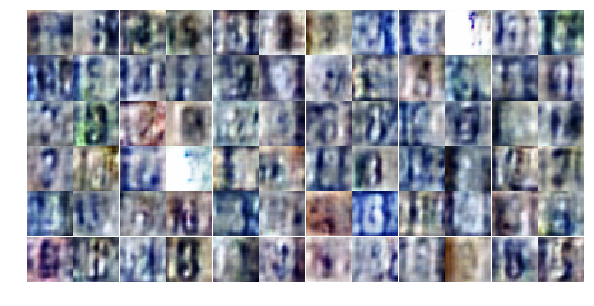

Epoch 20/25... Discriminator Loss: 1.1920... Generator Loss: 0.8219
Epoch 20/25... Discriminator Loss: 1.2162... Generator Loss: 0.8703
Epoch 20/25... Discriminator Loss: 1.1679... Generator Loss: 0.9439
Epoch 20/25... Discriminator Loss: 1.2464... Generator Loss: 0.8617
Epoch 20/25... Discriminator Loss: 1.2643... Generator Loss: 0.9541
Epoch 20/25... Discriminator Loss: 1.2247... Generator Loss: 0.8607
Epoch 21/25... Discriminator Loss: 1.3769... Generator Loss: 0.8682
Epoch 21/25... Discriminator Loss: 1.0910... Generator Loss: 1.9409
Epoch 21/25... Discriminator Loss: 1.2942... Generator Loss: 0.7467
Epoch 21/25... Discriminator Loss: 1.2293... Generator Loss: 0.8131


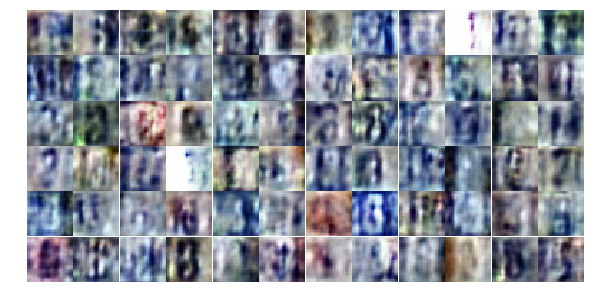

Epoch 21/25... Discriminator Loss: 1.2822... Generator Loss: 0.8646
Epoch 21/25... Discriminator Loss: 1.2686... Generator Loss: 0.7981
Epoch 21/25... Discriminator Loss: 1.0578... Generator Loss: 1.6520
Epoch 21/25... Discriminator Loss: 1.3312... Generator Loss: 0.7921
Epoch 21/25... Discriminator Loss: 1.1973... Generator Loss: 0.8681
Epoch 21/25... Discriminator Loss: 1.2237... Generator Loss: 0.9213
Epoch 21/25... Discriminator Loss: 1.2230... Generator Loss: 0.9936
Epoch 21/25... Discriminator Loss: 1.3612... Generator Loss: 0.8644
Epoch 21/25... Discriminator Loss: 1.2481... Generator Loss: 1.5159
Epoch 21/25... Discriminator Loss: 1.1562... Generator Loss: 1.0428


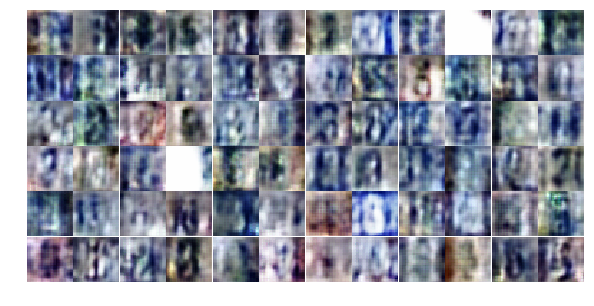

Epoch 21/25... Discriminator Loss: 1.0773... Generator Loss: 1.2008
Epoch 21/25... Discriminator Loss: 1.1209... Generator Loss: 0.8150
Epoch 21/25... Discriminator Loss: 1.2516... Generator Loss: 0.9990
Epoch 21/25... Discriminator Loss: 1.1971... Generator Loss: 0.9614
Epoch 21/25... Discriminator Loss: 1.1980... Generator Loss: 1.1204
Epoch 21/25... Discriminator Loss: 1.2251... Generator Loss: 0.8698
Epoch 21/25... Discriminator Loss: 1.2069... Generator Loss: 0.9305
Epoch 21/25... Discriminator Loss: 1.1359... Generator Loss: 0.9793
Epoch 21/25... Discriminator Loss: 1.3038... Generator Loss: 0.9437
Epoch 21/25... Discriminator Loss: 1.3192... Generator Loss: 0.7626


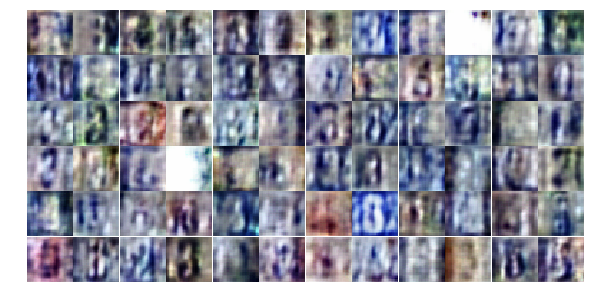

Epoch 21/25... Discriminator Loss: 1.2186... Generator Loss: 0.9290
Epoch 21/25... Discriminator Loss: 1.2637... Generator Loss: 1.1177
Epoch 21/25... Discriminator Loss: 1.2965... Generator Loss: 0.9002
Epoch 21/25... Discriminator Loss: 1.2135... Generator Loss: 0.8808
Epoch 21/25... Discriminator Loss: 1.3201... Generator Loss: 0.8309
Epoch 21/25... Discriminator Loss: 1.3273... Generator Loss: 0.8110
Epoch 21/25... Discriminator Loss: 1.3089... Generator Loss: 0.9419
Epoch 21/25... Discriminator Loss: 1.2791... Generator Loss: 0.8274
Epoch 21/25... Discriminator Loss: 1.1801... Generator Loss: 1.0008
Epoch 21/25... Discriminator Loss: 1.2793... Generator Loss: 0.9804


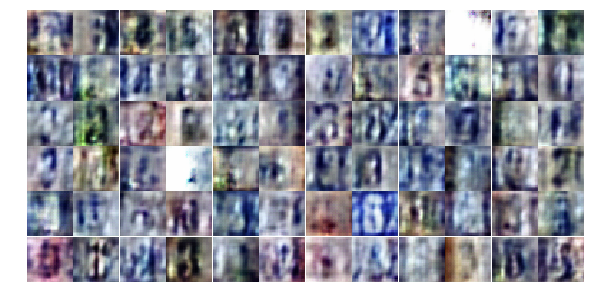

Epoch 21/25... Discriminator Loss: 1.5361... Generator Loss: 1.2105
Epoch 21/25... Discriminator Loss: 1.2774... Generator Loss: 0.8511
Epoch 21/25... Discriminator Loss: 1.1921... Generator Loss: 0.9071
Epoch 21/25... Discriminator Loss: 1.0946... Generator Loss: 1.0920
Epoch 21/25... Discriminator Loss: 1.1808... Generator Loss: 0.9475
Epoch 21/25... Discriminator Loss: 1.3237... Generator Loss: 0.8862
Epoch 21/25... Discriminator Loss: 1.1807... Generator Loss: 0.8949
Epoch 21/25... Discriminator Loss: 1.2630... Generator Loss: 0.9054
Epoch 21/25... Discriminator Loss: 1.2339... Generator Loss: 0.9127
Epoch 21/25... Discriminator Loss: 1.2572... Generator Loss: 0.8645


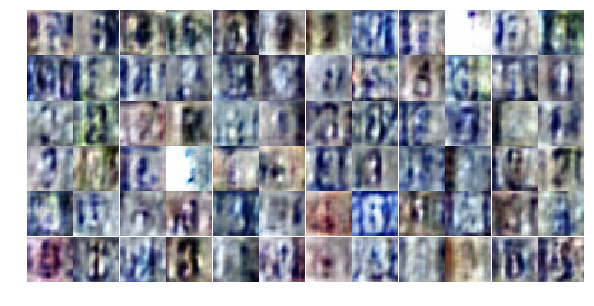

Epoch 21/25... Discriminator Loss: 1.2965... Generator Loss: 0.7714
Epoch 21/25... Discriminator Loss: 1.3255... Generator Loss: 0.8187
Epoch 21/25... Discriminator Loss: 1.2769... Generator Loss: 0.8134
Epoch 21/25... Discriminator Loss: 1.4246... Generator Loss: 0.7629
Epoch 21/25... Discriminator Loss: 1.3373... Generator Loss: 1.0046
Epoch 21/25... Discriminator Loss: 1.2194... Generator Loss: 0.8730
Epoch 21/25... Discriminator Loss: 1.3477... Generator Loss: 0.7487
Epoch 21/25... Discriminator Loss: 1.2149... Generator Loss: 0.9263
Epoch 21/25... Discriminator Loss: 1.2467... Generator Loss: 0.8523
Epoch 21/25... Discriminator Loss: 1.2033... Generator Loss: 1.0690


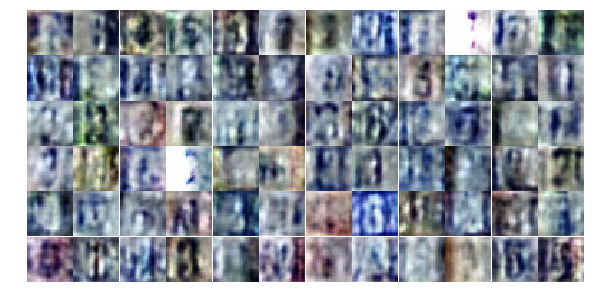

Epoch 21/25... Discriminator Loss: 1.2626... Generator Loss: 0.9643
Epoch 21/25... Discriminator Loss: 1.2880... Generator Loss: 0.8158
Epoch 21/25... Discriminator Loss: 1.2421... Generator Loss: 0.8610
Epoch 22/25... Discriminator Loss: 1.3548... Generator Loss: 0.8451
Epoch 22/25... Discriminator Loss: 1.2370... Generator Loss: 0.9020
Epoch 22/25... Discriminator Loss: 1.1609... Generator Loss: 0.9544
Epoch 22/25... Discriminator Loss: 1.3440... Generator Loss: 0.7657
Epoch 22/25... Discriminator Loss: 1.2422... Generator Loss: 0.9289
Epoch 22/25... Discriminator Loss: 1.3509... Generator Loss: 0.7975
Epoch 22/25... Discriminator Loss: 1.3123... Generator Loss: 1.0411


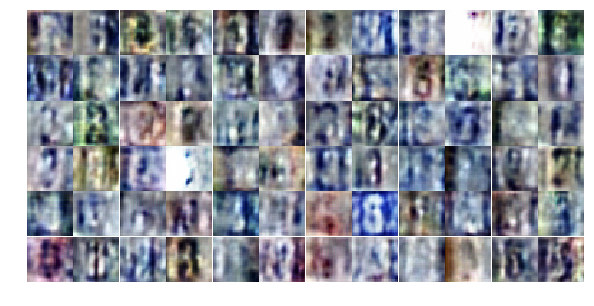

Epoch 22/25... Discriminator Loss: 1.2344... Generator Loss: 0.9680
Epoch 22/25... Discriminator Loss: 1.3488... Generator Loss: 0.8460
Epoch 22/25... Discriminator Loss: 1.2005... Generator Loss: 0.8637
Epoch 22/25... Discriminator Loss: 1.1671... Generator Loss: 0.8616
Epoch 22/25... Discriminator Loss: 1.2895... Generator Loss: 0.8959
Epoch 22/25... Discriminator Loss: 1.2710... Generator Loss: 0.7523
Epoch 22/25... Discriminator Loss: 1.2256... Generator Loss: 0.9309
Epoch 22/25... Discriminator Loss: 1.2580... Generator Loss: 0.7480
Epoch 22/25... Discriminator Loss: 1.3092... Generator Loss: 0.8469
Epoch 22/25... Discriminator Loss: 1.3398... Generator Loss: 0.8687


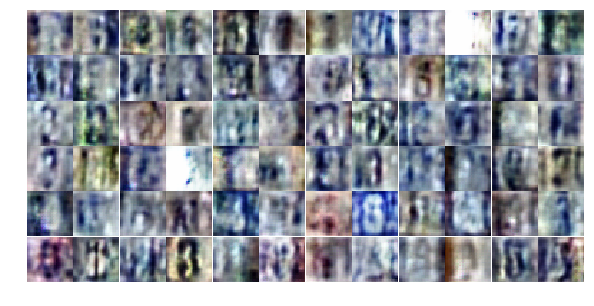

Epoch 22/25... Discriminator Loss: 1.1543... Generator Loss: 0.9492
Epoch 22/25... Discriminator Loss: 1.2404... Generator Loss: 0.8051
Epoch 22/25... Discriminator Loss: 1.2231... Generator Loss: 0.8780
Epoch 22/25... Discriminator Loss: 1.1949... Generator Loss: 0.9549
Epoch 22/25... Discriminator Loss: 1.2558... Generator Loss: 0.8194
Epoch 22/25... Discriminator Loss: 1.3196... Generator Loss: 0.8365
Epoch 22/25... Discriminator Loss: 0.9346... Generator Loss: 2.5743
Epoch 22/25... Discriminator Loss: 1.2254... Generator Loss: 0.8394
Epoch 22/25... Discriminator Loss: 1.1878... Generator Loss: 0.8363
Epoch 22/25... Discriminator Loss: 1.2368... Generator Loss: 1.0251


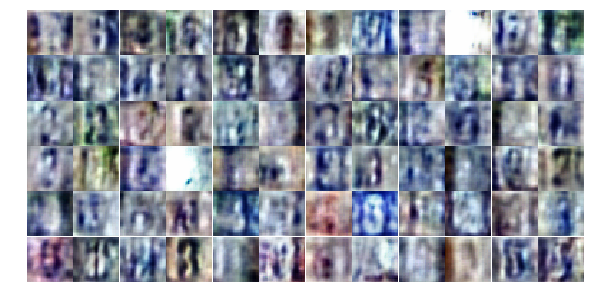

Epoch 22/25... Discriminator Loss: 1.2963... Generator Loss: 0.7561
Epoch 22/25... Discriminator Loss: 1.2606... Generator Loss: 0.9138
Epoch 22/25... Discriminator Loss: 1.2136... Generator Loss: 1.0072
Epoch 22/25... Discriminator Loss: 1.2926... Generator Loss: 0.8425
Epoch 22/25... Discriminator Loss: 1.3114... Generator Loss: 0.7674
Epoch 22/25... Discriminator Loss: 1.2571... Generator Loss: 0.9392
Epoch 22/25... Discriminator Loss: 1.2893... Generator Loss: 0.7505
Epoch 22/25... Discriminator Loss: 1.2321... Generator Loss: 0.8792
Epoch 22/25... Discriminator Loss: 1.2433... Generator Loss: 1.0311
Epoch 22/25... Discriminator Loss: 1.2668... Generator Loss: 0.9048


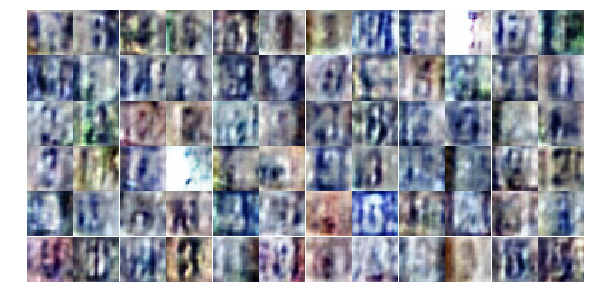

Epoch 22/25... Discriminator Loss: 1.2228... Generator Loss: 0.9229
Epoch 22/25... Discriminator Loss: 1.3632... Generator Loss: 0.7089
Epoch 22/25... Discriminator Loss: 1.2896... Generator Loss: 0.7478
Epoch 22/25... Discriminator Loss: 1.2792... Generator Loss: 0.7966
Epoch 22/25... Discriminator Loss: 1.2796... Generator Loss: 0.8325
Epoch 22/25... Discriminator Loss: 1.3264... Generator Loss: 0.7660
Epoch 22/25... Discriminator Loss: 1.2166... Generator Loss: 0.9571
Epoch 22/25... Discriminator Loss: 1.3046... Generator Loss: 0.8093
Epoch 22/25... Discriminator Loss: 1.2456... Generator Loss: 1.0054
Epoch 22/25... Discriminator Loss: 1.2088... Generator Loss: 0.9359


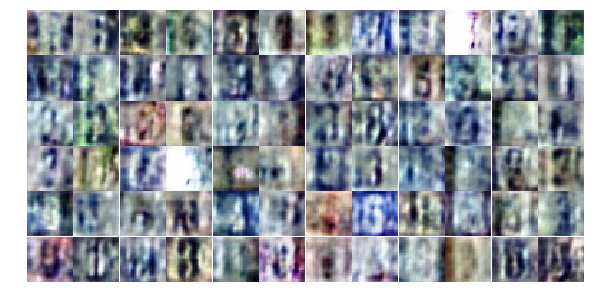

Epoch 22/25... Discriminator Loss: 1.2810... Generator Loss: 0.8405
Epoch 22/25... Discriminator Loss: 1.3127... Generator Loss: 0.7985
Epoch 22/25... Discriminator Loss: 1.2802... Generator Loss: 0.7772
Epoch 22/25... Discriminator Loss: 1.2271... Generator Loss: 0.8407
Epoch 22/25... Discriminator Loss: 1.2360... Generator Loss: 0.8212
Epoch 22/25... Discriminator Loss: 1.3091... Generator Loss: 0.7640
Epoch 22/25... Discriminator Loss: 1.3904... Generator Loss: 0.7353
Epoch 22/25... Discriminator Loss: 1.1570... Generator Loss: 1.0728
Epoch 22/25... Discriminator Loss: 1.4249... Generator Loss: 0.7564
Epoch 22/25... Discriminator Loss: 1.2896... Generator Loss: 0.8229


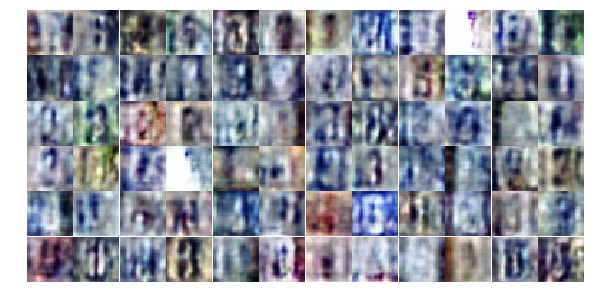

Epoch 23/25... Discriminator Loss: 1.1733... Generator Loss: 0.8686
Epoch 23/25... Discriminator Loss: 1.2901... Generator Loss: 0.7470
Epoch 23/25... Discriminator Loss: 1.3640... Generator Loss: 0.7580
Epoch 23/25... Discriminator Loss: 1.3896... Generator Loss: 0.8335
Epoch 23/25... Discriminator Loss: 1.2221... Generator Loss: 0.8585
Epoch 23/25... Discriminator Loss: 1.2099... Generator Loss: 0.9558
Epoch 23/25... Discriminator Loss: 1.4171... Generator Loss: 0.8273
Epoch 23/25... Discriminator Loss: 1.3241... Generator Loss: 0.7492
Epoch 23/25... Discriminator Loss: 1.2382... Generator Loss: 0.8136
Epoch 23/25... Discriminator Loss: 1.2538... Generator Loss: 0.9263


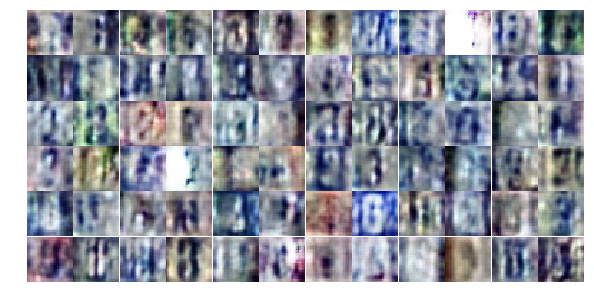

Epoch 23/25... Discriminator Loss: 1.5163... Generator Loss: 0.8214
Epoch 23/25... Discriminator Loss: 1.2563... Generator Loss: 0.8212
Epoch 23/25... Discriminator Loss: 1.4505... Generator Loss: 0.7875
Epoch 23/25... Discriminator Loss: 1.2706... Generator Loss: 0.8234
Epoch 23/25... Discriminator Loss: 1.3006... Generator Loss: 1.0239
Epoch 23/25... Discriminator Loss: 1.2566... Generator Loss: 0.8824
Epoch 23/25... Discriminator Loss: 1.1398... Generator Loss: 1.4898
Epoch 23/25... Discriminator Loss: 1.3256... Generator Loss: 0.6821
Epoch 23/25... Discriminator Loss: 1.2305... Generator Loss: 0.8422
Epoch 23/25... Discriminator Loss: 1.1998... Generator Loss: 0.8644


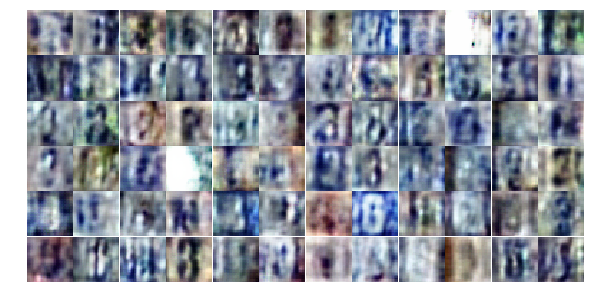

Epoch 23/25... Discriminator Loss: 1.2966... Generator Loss: 0.7127
Epoch 23/25... Discriminator Loss: 1.1384... Generator Loss: 0.9387
Epoch 23/25... Discriminator Loss: 1.3187... Generator Loss: 0.7697
Epoch 23/25... Discriminator Loss: 1.2890... Generator Loss: 0.8014
Epoch 23/25... Discriminator Loss: 1.2290... Generator Loss: 0.9302
Epoch 23/25... Discriminator Loss: 1.2984... Generator Loss: 0.9811
Epoch 23/25... Discriminator Loss: 1.2645... Generator Loss: 0.8828
Epoch 23/25... Discriminator Loss: 1.2079... Generator Loss: 0.9996
Epoch 23/25... Discriminator Loss: 1.2199... Generator Loss: 0.9203
Epoch 23/25... Discriminator Loss: 1.4738... Generator Loss: 0.6981


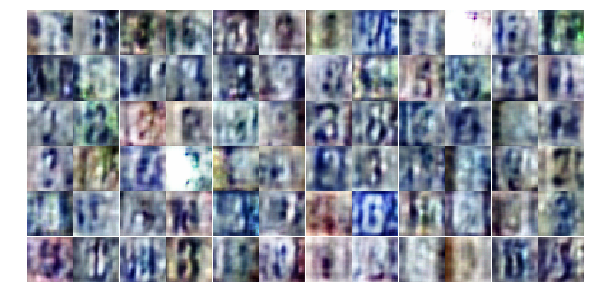

Epoch 23/25... Discriminator Loss: 1.3426... Generator Loss: 0.7019
Epoch 23/25... Discriminator Loss: 1.2444... Generator Loss: 0.7851
Epoch 23/25... Discriminator Loss: 1.3051... Generator Loss: 0.6786
Epoch 23/25... Discriminator Loss: 1.2212... Generator Loss: 0.9139
Epoch 23/25... Discriminator Loss: 1.2274... Generator Loss: 1.1930
Epoch 23/25... Discriminator Loss: 1.2699... Generator Loss: 0.8975
Epoch 23/25... Discriminator Loss: 1.2887... Generator Loss: 0.8374
Epoch 23/25... Discriminator Loss: 1.1695... Generator Loss: 0.8922
Epoch 23/25... Discriminator Loss: 1.2230... Generator Loss: 0.8154
Epoch 23/25... Discriminator Loss: 1.2466... Generator Loss: 0.8603


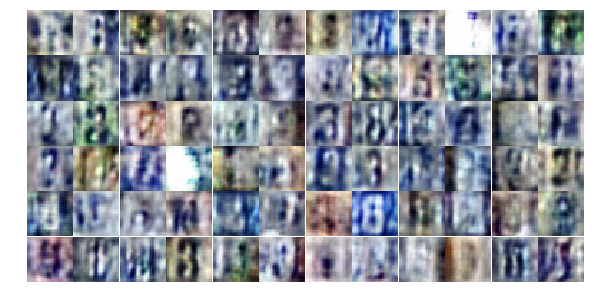

Epoch 23/25... Discriminator Loss: 1.3190... Generator Loss: 0.8662
Epoch 23/25... Discriminator Loss: 1.1809... Generator Loss: 0.9385
Epoch 23/25... Discriminator Loss: 1.3180... Generator Loss: 0.8592
Epoch 23/25... Discriminator Loss: 1.4086... Generator Loss: 0.8004
Epoch 23/25... Discriminator Loss: 1.2586... Generator Loss: 0.7631
Epoch 23/25... Discriminator Loss: 1.2862... Generator Loss: 0.8218
Epoch 23/25... Discriminator Loss: 1.2515... Generator Loss: 0.8429
Epoch 23/25... Discriminator Loss: 1.2634... Generator Loss: 0.8730
Epoch 23/25... Discriminator Loss: 1.2919... Generator Loss: 0.7497
Epoch 23/25... Discriminator Loss: 1.1577... Generator Loss: 0.9682


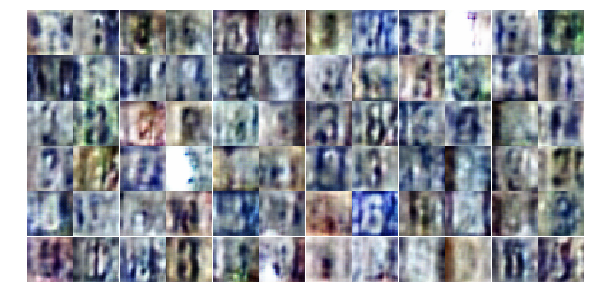

Epoch 23/25... Discriminator Loss: 1.3167... Generator Loss: 0.7931
Epoch 23/25... Discriminator Loss: 1.2728... Generator Loss: 1.1616
Epoch 23/25... Discriminator Loss: 1.2433... Generator Loss: 0.9042
Epoch 23/25... Discriminator Loss: 1.1875... Generator Loss: 1.1076
Epoch 23/25... Discriminator Loss: 1.1375... Generator Loss: 0.9464
Epoch 23/25... Discriminator Loss: 1.1316... Generator Loss: 0.9363
Epoch 23/25... Discriminator Loss: 1.2334... Generator Loss: 0.9469
Epoch 24/25... Discriminator Loss: 1.1834... Generator Loss: 0.9882
Epoch 24/25... Discriminator Loss: 1.2157... Generator Loss: 0.8977
Epoch 24/25... Discriminator Loss: 1.1714... Generator Loss: 0.8903


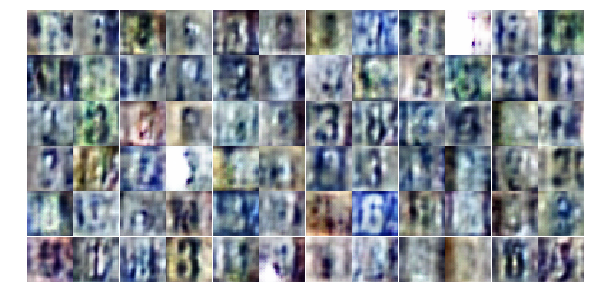

Epoch 24/25... Discriminator Loss: 1.2605... Generator Loss: 0.7901
Epoch 24/25... Discriminator Loss: 1.3374... Generator Loss: 0.8442
Epoch 24/25... Discriminator Loss: 1.2474... Generator Loss: 0.8801
Epoch 24/25... Discriminator Loss: 1.2111... Generator Loss: 0.8047
Epoch 24/25... Discriminator Loss: 1.2349... Generator Loss: 0.7775
Epoch 24/25... Discriminator Loss: 1.2678... Generator Loss: 0.8306
Epoch 24/25... Discriminator Loss: 1.2250... Generator Loss: 0.8149
Epoch 24/25... Discriminator Loss: 1.2588... Generator Loss: 0.8536
Epoch 24/25... Discriminator Loss: 1.2713... Generator Loss: 0.9296
Epoch 24/25... Discriminator Loss: 1.3062... Generator Loss: 0.7644


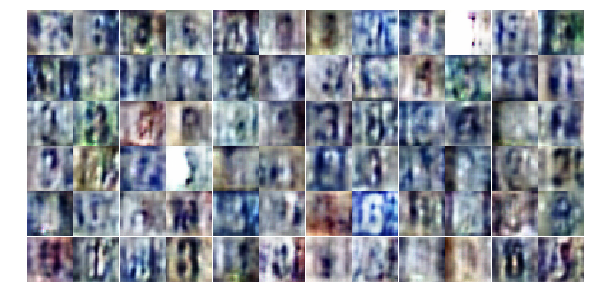

Epoch 24/25... Discriminator Loss: 1.2168... Generator Loss: 0.8724
Epoch 24/25... Discriminator Loss: 1.2319... Generator Loss: 0.8294
Epoch 24/25... Discriminator Loss: 1.2486... Generator Loss: 0.8322
Epoch 24/25... Discriminator Loss: 1.2997... Generator Loss: 0.9093
Epoch 24/25... Discriminator Loss: 1.2169... Generator Loss: 0.8465
Epoch 24/25... Discriminator Loss: 1.4136... Generator Loss: 0.8713
Epoch 24/25... Discriminator Loss: 1.1791... Generator Loss: 0.9418
Epoch 24/25... Discriminator Loss: 1.3705... Generator Loss: 0.7586
Epoch 24/25... Discriminator Loss: 1.4205... Generator Loss: 0.7332
Epoch 24/25... Discriminator Loss: 1.3485... Generator Loss: 0.8577


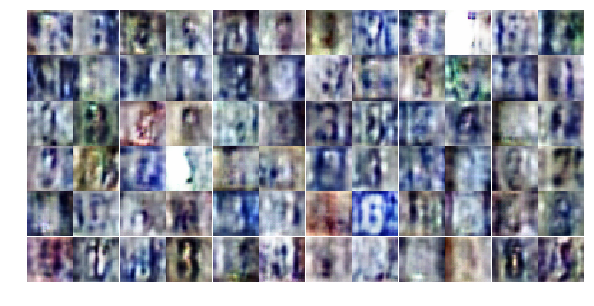

Epoch 24/25... Discriminator Loss: 1.1709... Generator Loss: 0.8702
Epoch 24/25... Discriminator Loss: 1.2228... Generator Loss: 0.8754
Epoch 24/25... Discriminator Loss: 1.1430... Generator Loss: 1.0711
Epoch 24/25... Discriminator Loss: 1.2032... Generator Loss: 0.8814
Epoch 24/25... Discriminator Loss: 1.2208... Generator Loss: 0.8907
Epoch 24/25... Discriminator Loss: 1.2161... Generator Loss: 0.9158
Epoch 24/25... Discriminator Loss: 1.1844... Generator Loss: 0.8922
Epoch 24/25... Discriminator Loss: 1.3383... Generator Loss: 0.9194
Epoch 24/25... Discriminator Loss: 1.3031... Generator Loss: 0.8147
Epoch 24/25... Discriminator Loss: 1.1928... Generator Loss: 0.9340


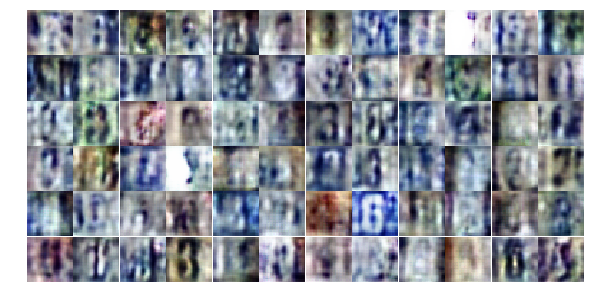

Epoch 24/25... Discriminator Loss: 1.1999... Generator Loss: 0.9283
Epoch 24/25... Discriminator Loss: 1.2245... Generator Loss: 0.8503
Epoch 24/25... Discriminator Loss: 1.3990... Generator Loss: 0.9278
Epoch 24/25... Discriminator Loss: 1.2546... Generator Loss: 0.8620
Epoch 24/25... Discriminator Loss: 1.2009... Generator Loss: 0.9215
Epoch 24/25... Discriminator Loss: 1.3463... Generator Loss: 0.7619
Epoch 24/25... Discriminator Loss: 1.1688... Generator Loss: 0.8621
Epoch 24/25... Discriminator Loss: 1.2573... Generator Loss: 0.8397
Epoch 24/25... Discriminator Loss: 1.3337... Generator Loss: 0.9306
Epoch 24/25... Discriminator Loss: 1.5295... Generator Loss: 0.7149


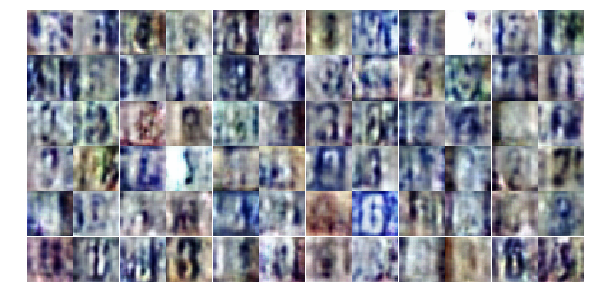

Epoch 24/25... Discriminator Loss: 1.2479... Generator Loss: 0.8546
Epoch 24/25... Discriminator Loss: 1.4727... Generator Loss: 0.8306
Epoch 24/25... Discriminator Loss: 1.2807... Generator Loss: 0.8070
Epoch 24/25... Discriminator Loss: 1.3469... Generator Loss: 0.7934
Epoch 24/25... Discriminator Loss: 1.2454... Generator Loss: 0.9413
Epoch 24/25... Discriminator Loss: 1.2219... Generator Loss: 0.8444
Epoch 24/25... Discriminator Loss: 1.3531... Generator Loss: 0.9066
Epoch 24/25... Discriminator Loss: 1.2968... Generator Loss: 0.8046
Epoch 24/25... Discriminator Loss: 1.3496... Generator Loss: 0.7582
Epoch 24/25... Discriminator Loss: 1.3444... Generator Loss: 0.8679


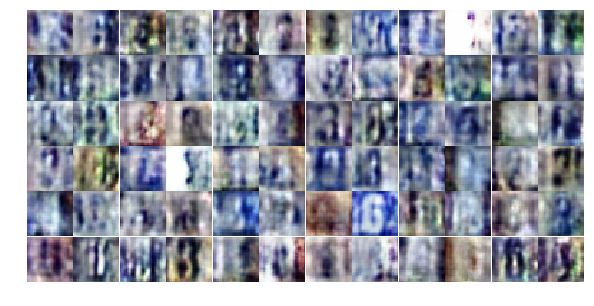

Epoch 24/25... Discriminator Loss: 1.2333... Generator Loss: 0.8561
Epoch 24/25... Discriminator Loss: 1.2258... Generator Loss: 0.9456
Epoch 24/25... Discriminator Loss: 1.3431... Generator Loss: 0.8242
Epoch 24/25... Discriminator Loss: 1.2666... Generator Loss: 0.9006
Epoch 24/25... Discriminator Loss: 1.2628... Generator Loss: 0.8231
Epoch 25/25... Discriminator Loss: 1.3202... Generator Loss: 0.7329
Epoch 25/25... Discriminator Loss: 1.1563... Generator Loss: 0.9870
Epoch 25/25... Discriminator Loss: 1.5004... Generator Loss: 0.7163
Epoch 25/25... Discriminator Loss: 1.2478... Generator Loss: 0.9715
Epoch 25/25... Discriminator Loss: 1.2167... Generator Loss: 0.9050


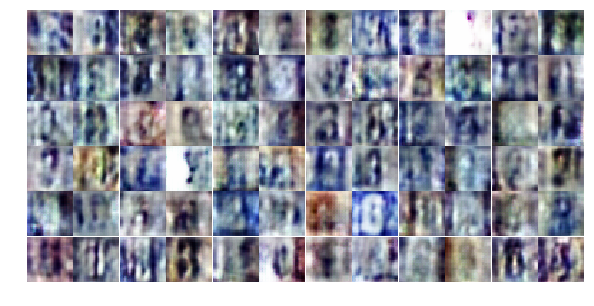

Epoch 25/25... Discriminator Loss: 1.1454... Generator Loss: 0.8823
Epoch 25/25... Discriminator Loss: 1.3152... Generator Loss: 1.1718
Epoch 25/25... Discriminator Loss: 1.3472... Generator Loss: 0.8435
Epoch 25/25... Discriminator Loss: 1.0935... Generator Loss: 2.0725
Epoch 25/25... Discriminator Loss: 1.2160... Generator Loss: 0.8257
Epoch 25/25... Discriminator Loss: 1.2454... Generator Loss: 1.4463
Epoch 25/25... Discriminator Loss: 1.2804... Generator Loss: 0.8105
Epoch 25/25... Discriminator Loss: 0.8973... Generator Loss: 2.1690
Epoch 25/25... Discriminator Loss: 1.2484... Generator Loss: 0.8836
Epoch 25/25... Discriminator Loss: 1.1648... Generator Loss: 0.7742


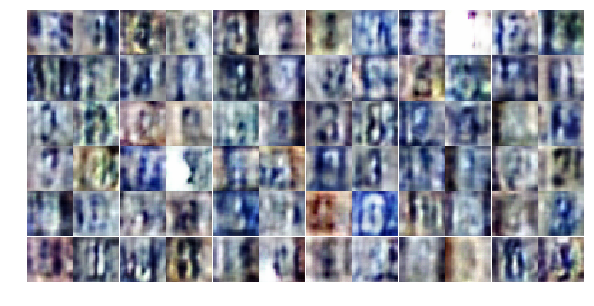

Epoch 25/25... Discriminator Loss: 1.2270... Generator Loss: 0.8417
Epoch 25/25... Discriminator Loss: 1.3542... Generator Loss: 0.8601
Epoch 25/25... Discriminator Loss: 1.2815... Generator Loss: 0.8838
Epoch 25/25... Discriminator Loss: 1.3004... Generator Loss: 0.8143
Epoch 25/25... Discriminator Loss: 1.2915... Generator Loss: 0.8851
Epoch 25/25... Discriminator Loss: 1.3469... Generator Loss: 0.8196
Epoch 25/25... Discriminator Loss: 1.1653... Generator Loss: 0.8939
Epoch 25/25... Discriminator Loss: 1.2060... Generator Loss: 0.8149
Epoch 25/25... Discriminator Loss: 1.2322... Generator Loss: 0.8967
Epoch 25/25... Discriminator Loss: 1.2969... Generator Loss: 0.8667


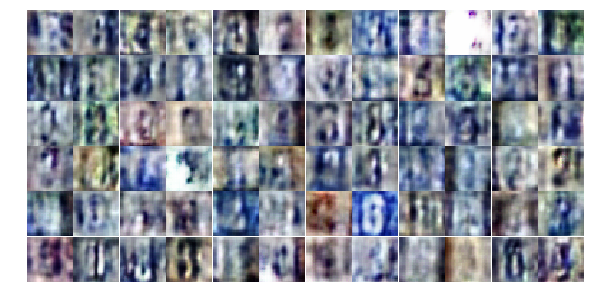

Epoch 25/25... Discriminator Loss: 1.3263... Generator Loss: 0.7326
Epoch 25/25... Discriminator Loss: 1.2634... Generator Loss: 0.8325
Epoch 25/25... Discriminator Loss: 1.2568... Generator Loss: 0.9298
Epoch 25/25... Discriminator Loss: 1.2500... Generator Loss: 0.8368
Epoch 25/25... Discriminator Loss: 1.2606... Generator Loss: 0.9289
Epoch 25/25... Discriminator Loss: 1.2413... Generator Loss: 0.9400
Epoch 25/25... Discriminator Loss: 1.3414... Generator Loss: 0.9677
Epoch 25/25... Discriminator Loss: 1.2079... Generator Loss: 0.8789
Epoch 25/25... Discriminator Loss: 1.4943... Generator Loss: 1.3010
Epoch 25/25... Discriminator Loss: 1.1605... Generator Loss: 0.7977


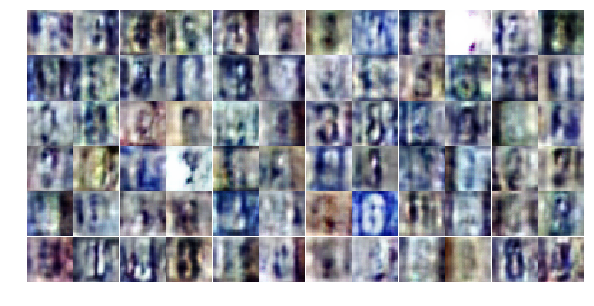

Epoch 25/25... Discriminator Loss: 1.2356... Generator Loss: 0.8928
Epoch 25/25... Discriminator Loss: 1.3710... Generator Loss: 0.6647
Epoch 25/25... Discriminator Loss: 1.2170... Generator Loss: 0.8745
Epoch 25/25... Discriminator Loss: 1.1955... Generator Loss: 0.9038
Epoch 25/25... Discriminator Loss: 1.2692... Generator Loss: 0.8977
Epoch 25/25... Discriminator Loss: 1.2666... Generator Loss: 0.8404
Epoch 25/25... Discriminator Loss: 1.2635... Generator Loss: 1.1465
Epoch 25/25... Discriminator Loss: 1.2665... Generator Loss: 1.0133
Epoch 25/25... Discriminator Loss: 1.1716... Generator Loss: 0.8299
Epoch 25/25... Discriminator Loss: 1.1594... Generator Loss: 0.9175


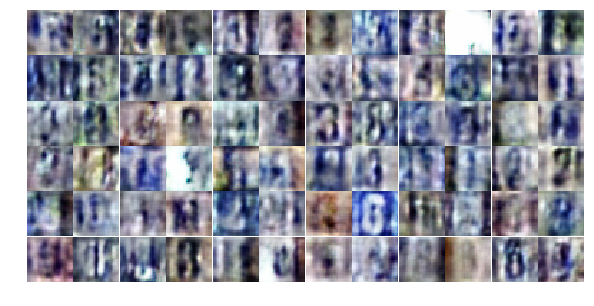

Epoch 25/25... Discriminator Loss: 1.2244... Generator Loss: 0.8684
Epoch 25/25... Discriminator Loss: 1.2593... Generator Loss: 0.9115
Epoch 25/25... Discriminator Loss: 1.2136... Generator Loss: 0.8705
Epoch 25/25... Discriminator Loss: 1.2108... Generator Loss: 0.8490
Epoch 25/25... Discriminator Loss: 1.2649... Generator Loss: 0.8906
Epoch 25/25... Discriminator Loss: 1.2618... Generator Loss: 0.8235
Epoch 25/25... Discriminator Loss: 1.1643... Generator Loss: 1.7294
Epoch 25/25... Discriminator Loss: 1.2165... Generator Loss: 0.8701
Epoch 25/25... Discriminator Loss: 1.2360... Generator Loss: 0.8410
Epoch 25/25... Discriminator Loss: 1.2402... Generator Loss: 0.9524


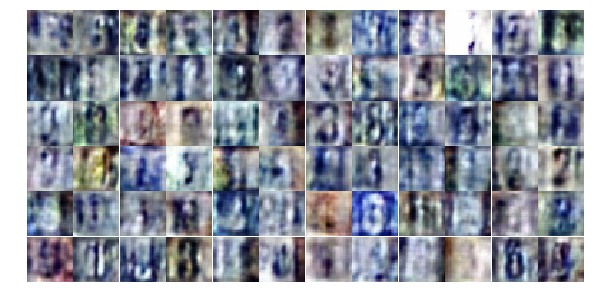

Epoch 25/25... Discriminator Loss: 1.2404... Generator Loss: 0.8032
Epoch 25/25... Discriminator Loss: 1.4050... Generator Loss: 0.7733


In [28]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

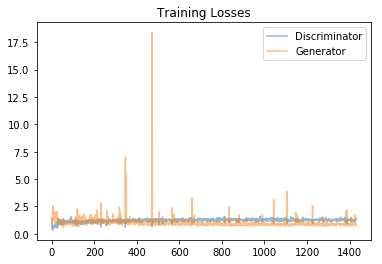

In [29]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

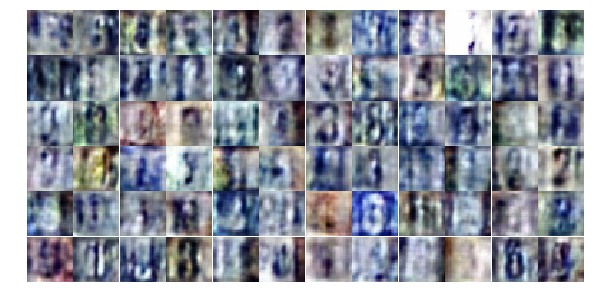

In [30]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))